In [1]:
import warnings
warnings.filterwarnings('always')
warnings.filterwarnings('ignore')
import dlib
import time
# data visualisation and manipulation
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import style
import seaborn as sns
 
%matplotlib inline  
style.use('fivethirtyeight')
sns.set(style='whitegrid',color_codes=True)

#model selection
from sklearn.model_selection import train_test_split
from sklearn.model_selection import KFold
from sklearn.metrics import accuracy_score,precision_score,recall_score,confusion_matrix,roc_curve,roc_auc_score
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import LabelEncoder

#preprocess.
from keras.preprocessing.image import ImageDataGenerator

#dl libraraies
from keras import backend as K
from keras.models import Sequential
from keras.layers import Dense
from keras.optimizers import Adam,SGD,Adagrad,Adadelta,RMSprop
from keras.utils import to_categorical

# specifically for cnn
from keras.layers import Dropout, Flatten,Activation
from keras.layers import Conv2D, MaxPooling2D, BatchNormalization
 
import tensorflow as tf
import random as rn

# specifically for manipulating zipped images and getting numpy arrays of pixel values of images.
import cv2                  
import numpy as np  
from tqdm import tqdm
import os
import os.path
import imutils                   
from random import shuffle  
from PIL import Image

Using TensorFlow backend.


In [2]:
X=[]
Z=[]
IMG_SIZE=256
p1 = 'HOG'
p2 = 'Canny_HOG'

In [3]:
def assign_label(img,student_name):
    return student_name

In [4]:
def preprocess_data(student_name,DIR):
  dest=student_name[:2]
  cpt=0
  for img1 in tqdm(os.listdir(DIR)):
        label=assign_label(img1,student_name)
        path = os.path.join(DIR,img1)
        img = cv2.imread(path,cv2.IMREAD_COLOR)
        img = cv2.resize(img, (IMG_SIZE,IMG_SIZE))
#         img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
        img=cv2.GaussianBlur(img,(5,5),0)
        edges=cv2.Canny(img,90,100)
        mean = np.mean(edges)
        # Zero any value that is less than mean. This reduces a lot of noise.
        edges[edges <= mean] = 0
        plt.subplot(121),plt.imshow(img,cmap='gray')
        plt.title('Original Image'), plt.xticks([]), plt.yticks([])
        plt.subplot(122),plt.imshow(edges,cmap='gray')
        plt.title('Edge Image'), plt.xticks([]), plt.yticks([])
        plt.show()
        
        path1 = os.path.join(p2,student_name)
        cv2.imwrite(os.path.join(path1,img1),edges)

  0%|          | 0/88 [00:00<?, ?it/s]

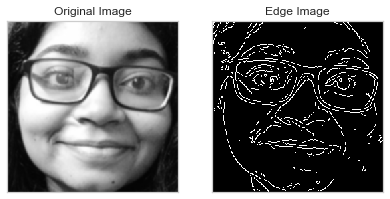


  1%|          | 1/88 [00:00<00:14,  6.11it/s]

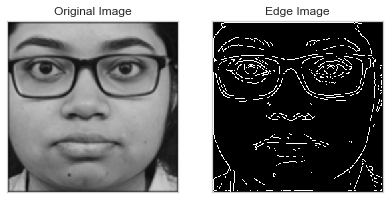


  2%|▏         | 2/88 [00:00<00:13,  6.44it/s]

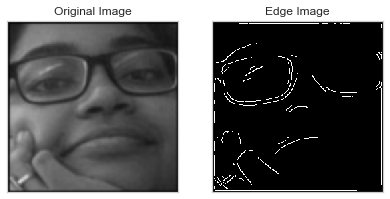


  3%|▎         | 3/88 [00:00<00:12,  6.78it/s]

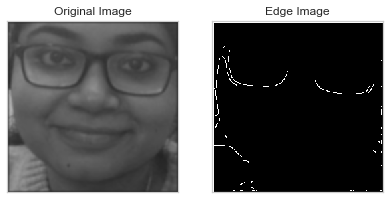


  5%|▍         | 4/88 [00:00<00:11,  7.02it/s]

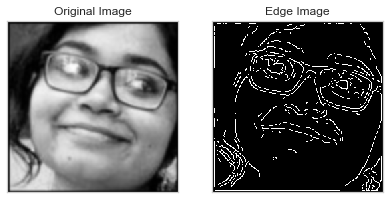


  6%|▌         | 5/88 [00:00<00:12,  6.74it/s]

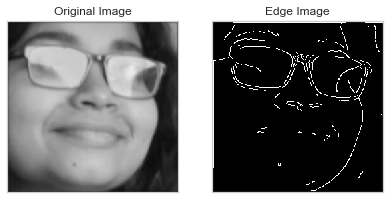


  7%|▋         | 6/88 [00:00<00:12,  6.78it/s]

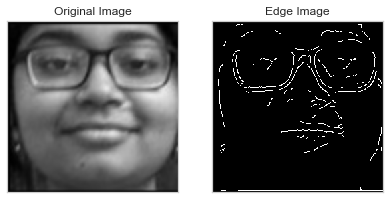


  8%|▊         | 7/88 [00:01<00:12,  6.41it/s]

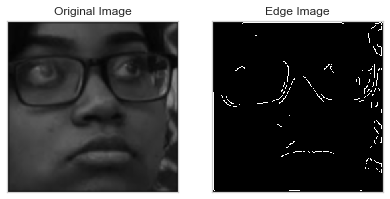


  9%|▉         | 8/88 [00:01<00:12,  6.54it/s]

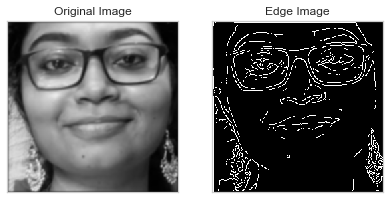


 10%|█         | 9/88 [00:01<00:12,  6.53it/s]

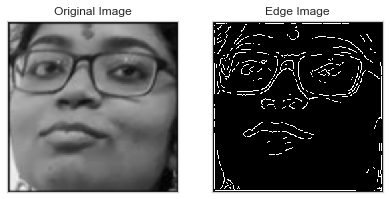


 11%|█▏        | 10/88 [00:01<00:11,  6.74it/s]

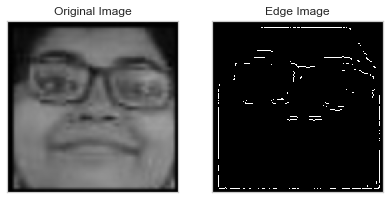


 12%|█▎        | 11/88 [00:01<00:11,  6.94it/s]

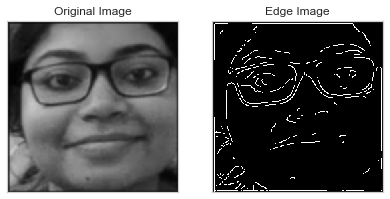


 14%|█▎        | 12/88 [00:01<00:14,  5.30it/s]

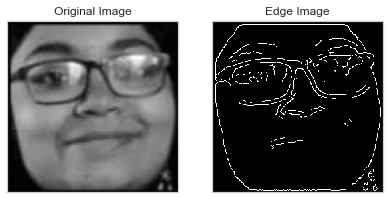


 15%|█▍        | 13/88 [00:02<00:13,  5.72it/s]

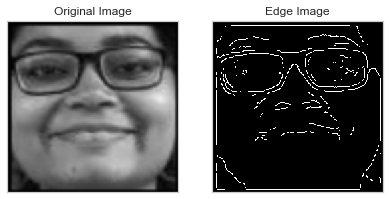


 16%|█▌        | 14/88 [00:02<00:12,  6.03it/s]

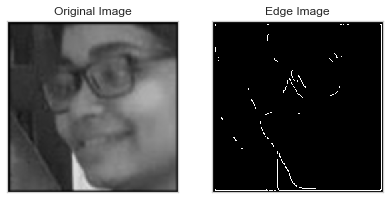


 17%|█▋        | 15/88 [00:02<00:11,  6.45it/s]

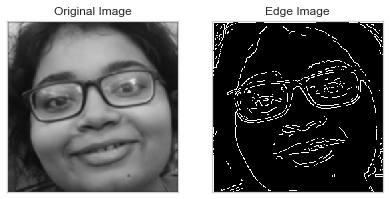


 18%|█▊        | 16/88 [00:02<00:10,  6.69it/s]

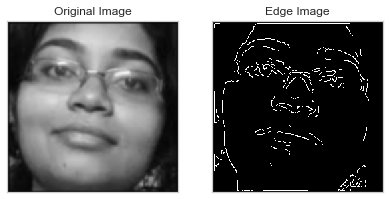


 19%|█▉        | 17/88 [00:02<00:10,  6.84it/s]

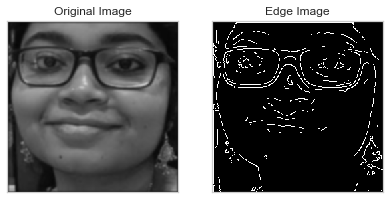


 20%|██        | 18/88 [00:02<00:12,  5.63it/s]

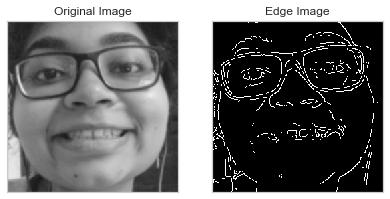


 22%|██▏       | 19/88 [00:03<00:11,  5.84it/s]

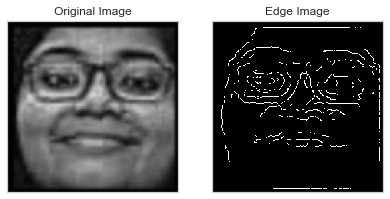


 23%|██▎       | 20/88 [00:03<00:10,  6.27it/s]

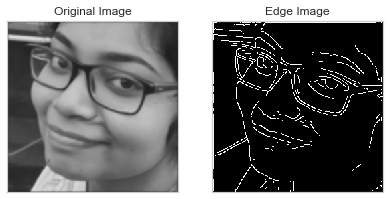


 24%|██▍       | 21/88 [00:03<00:10,  6.63it/s]

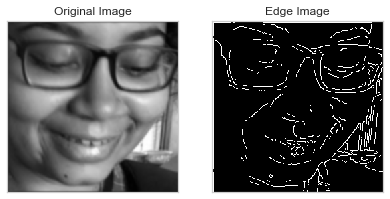


 25%|██▌       | 22/88 [00:03<00:09,  6.95it/s]

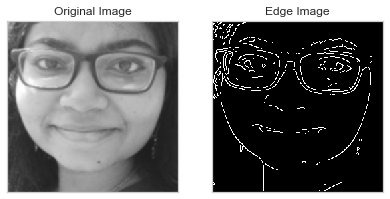


 26%|██▌       | 23/88 [00:03<00:09,  6.92it/s]

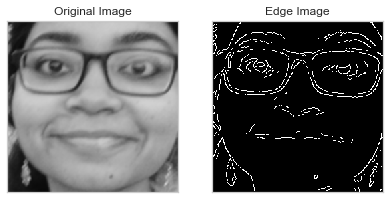


 27%|██▋       | 24/88 [00:03<00:09,  6.96it/s]

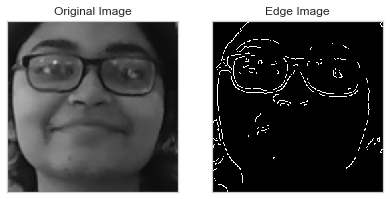


 28%|██▊       | 25/88 [00:03<00:08,  7.20it/s]

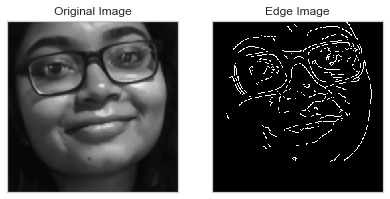


 30%|██▉       | 26/88 [00:03<00:08,  7.30it/s]

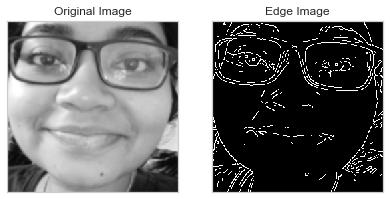


 31%|███       | 27/88 [00:04<00:09,  6.59it/s]

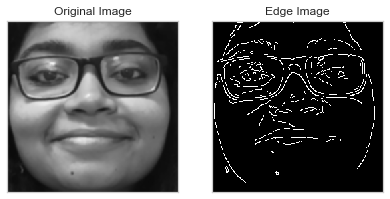


 32%|███▏      | 28/88 [00:04<00:08,  6.91it/s]

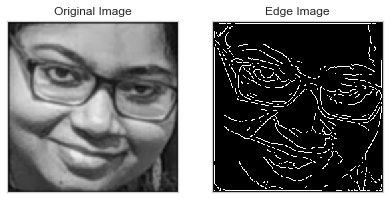


 33%|███▎      | 29/88 [00:04<00:08,  7.21it/s]

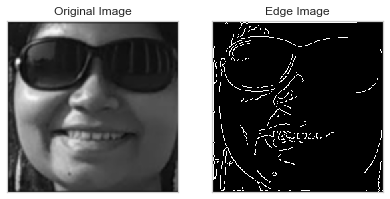


 34%|███▍      | 30/88 [00:04<00:08,  7.08it/s]

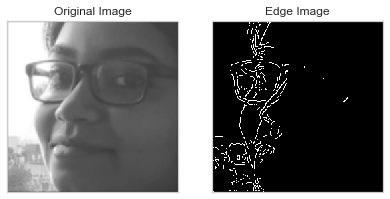


 35%|███▌      | 31/88 [00:04<00:07,  7.43it/s]

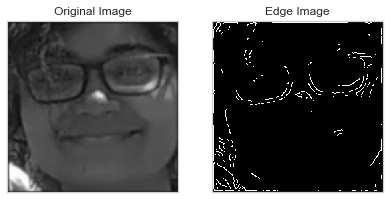


 36%|███▋      | 32/88 [00:04<00:07,  7.66it/s]

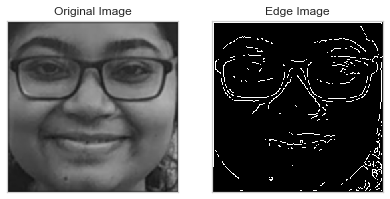


 38%|███▊      | 33/88 [00:04<00:07,  7.77it/s]

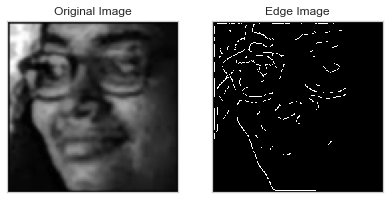


 39%|███▊      | 34/88 [00:05<00:06,  7.97it/s]

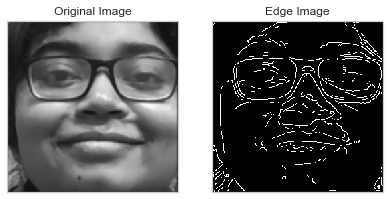


 40%|███▉      | 35/88 [00:05<00:06,  8.06it/s]

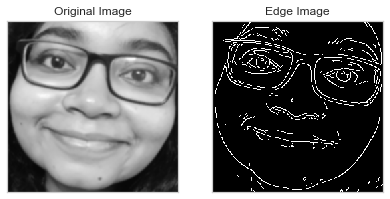


 41%|████      | 36/88 [00:05<00:07,  7.16it/s]

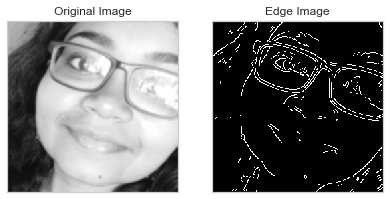


 42%|████▏     | 37/88 [00:05<00:07,  6.65it/s]

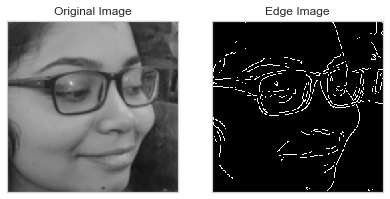


 43%|████▎     | 38/88 [00:05<00:07,  6.82it/s]

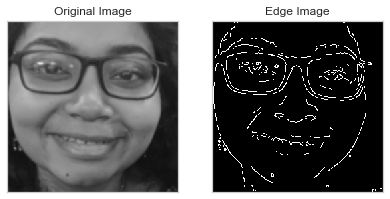


 44%|████▍     | 39/88 [00:05<00:07,  6.69it/s]

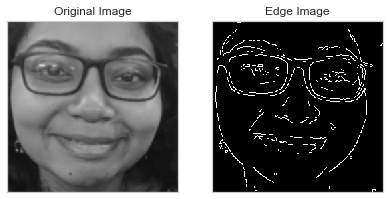


 45%|████▌     | 40/88 [00:05<00:07,  6.81it/s]

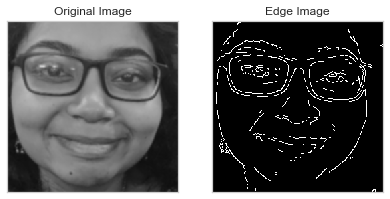


 47%|████▋     | 41/88 [00:06<00:07,  6.70it/s]

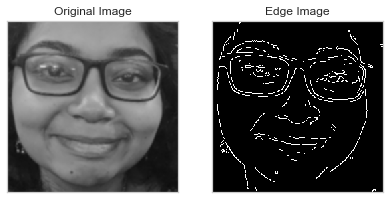


 48%|████▊     | 42/88 [00:06<00:06,  6.90it/s]

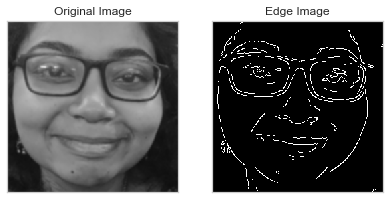


 49%|████▉     | 43/88 [00:06<00:06,  7.01it/s]

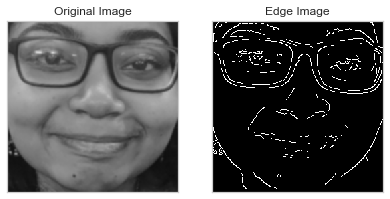


 50%|█████     | 44/88 [00:06<00:08,  5.13it/s]

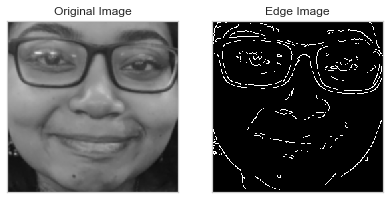


 51%|█████     | 45/88 [00:06<00:07,  5.45it/s]

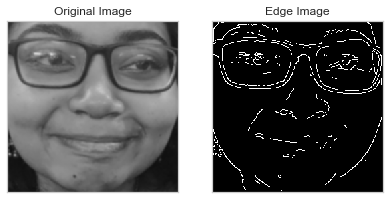


 52%|█████▏    | 46/88 [00:06<00:07,  5.74it/s]

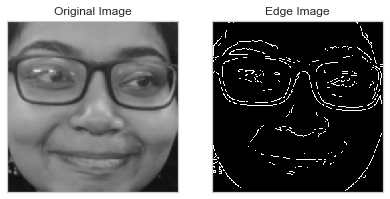


 53%|█████▎    | 47/88 [00:07<00:06,  6.01it/s]

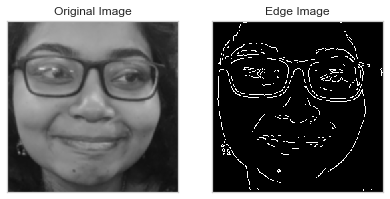


 55%|█████▍    | 48/88 [00:07<00:06,  6.16it/s]

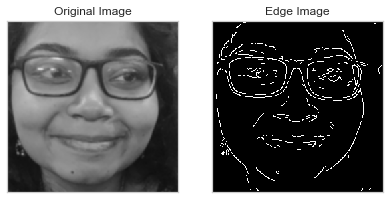


 56%|█████▌    | 49/88 [00:07<00:06,  6.27it/s]

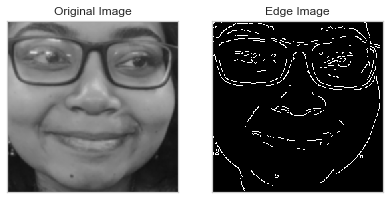


 57%|█████▋    | 50/88 [00:07<00:05,  6.46it/s]

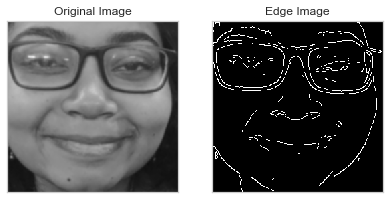


 58%|█████▊    | 51/88 [00:07<00:06,  5.79it/s]

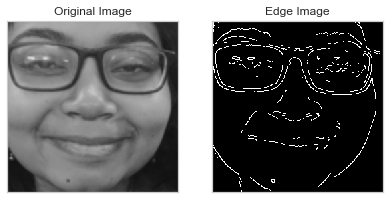


 59%|█████▉    | 52/88 [00:07<00:06,  5.85it/s]

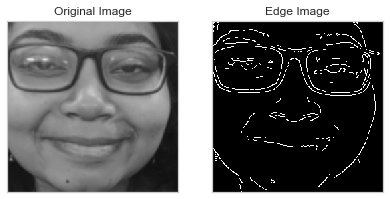


 60%|██████    | 53/88 [00:08<00:05,  5.87it/s]

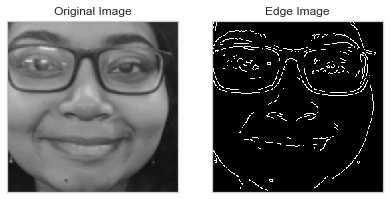


 61%|██████▏   | 54/88 [00:08<00:05,  6.06it/s]

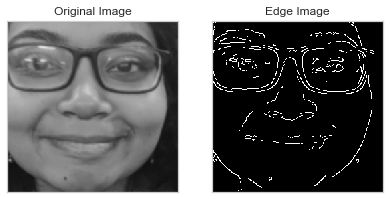


 62%|██████▎   | 55/88 [00:08<00:05,  5.93it/s]

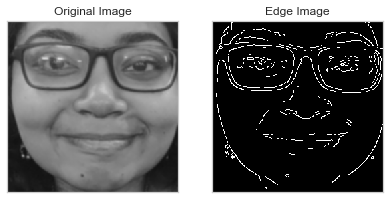


 64%|██████▎   | 56/88 [00:08<00:06,  4.59it/s]

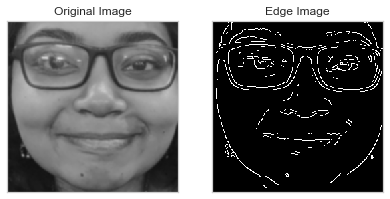


 65%|██████▍   | 57/88 [00:08<00:06,  5.04it/s]

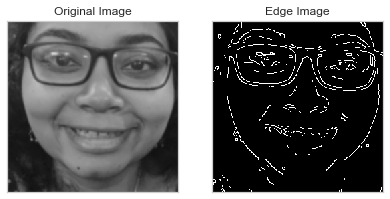


 66%|██████▌   | 58/88 [00:09<00:05,  5.48it/s]

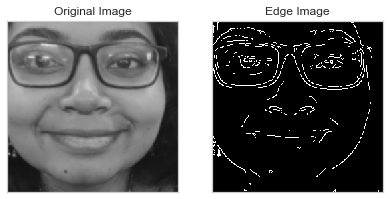


 67%|██████▋   | 59/88 [00:09<00:05,  5.20it/s]

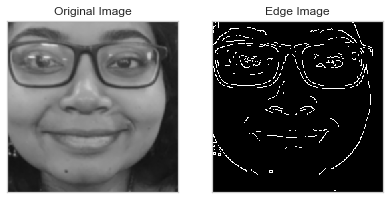


 68%|██████▊   | 60/88 [00:09<00:04,  5.65it/s]

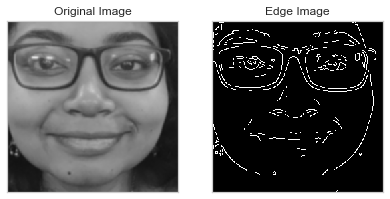


 69%|██████▉   | 61/88 [00:09<00:05,  5.38it/s]

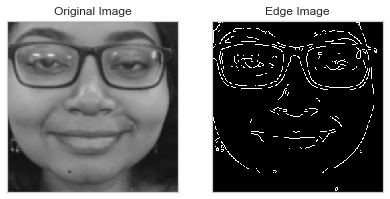


 70%|███████   | 62/88 [00:10<00:08,  3.18it/s]

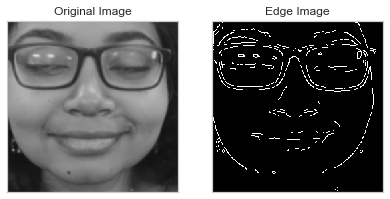


 72%|███████▏  | 63/88 [00:10<00:10,  2.43it/s]

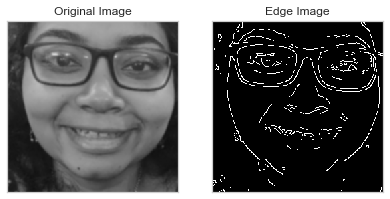


 73%|███████▎  | 64/88 [00:11<00:11,  2.08it/s]

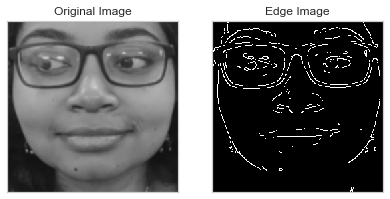


 74%|███████▍  | 65/88 [00:11<00:09,  2.37it/s]

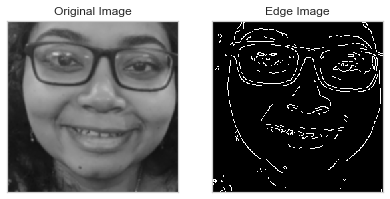


 75%|███████▌  | 66/88 [00:12<00:08,  2.65it/s]

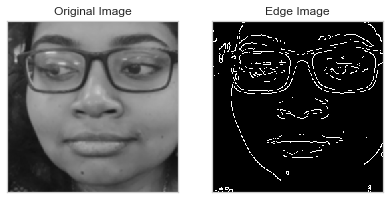


 76%|███████▌  | 67/88 [00:12<00:06,  3.18it/s]

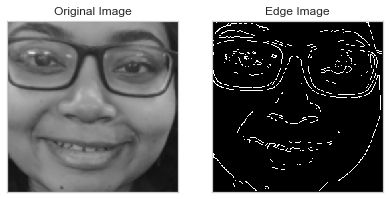


 77%|███████▋  | 68/88 [00:12<00:05,  3.80it/s]

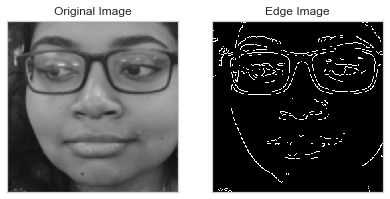


 78%|███████▊  | 69/88 [00:12<00:04,  4.35it/s]

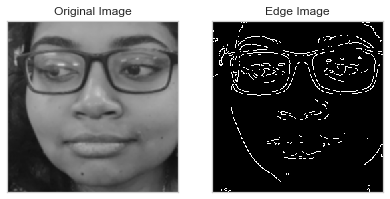


 80%|███████▉  | 70/88 [00:12<00:03,  4.78it/s]

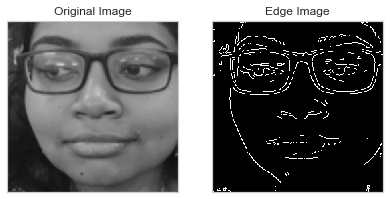


 81%|████████  | 71/88 [00:12<00:03,  5.28it/s]

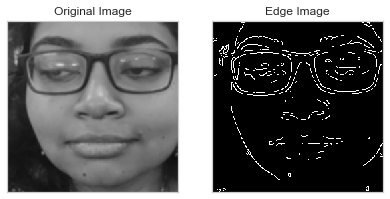


 82%|████████▏ | 72/88 [00:13<00:02,  5.58it/s]

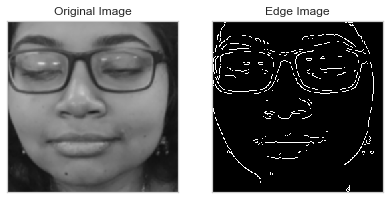


 83%|████████▎ | 73/88 [00:13<00:02,  5.96it/s]

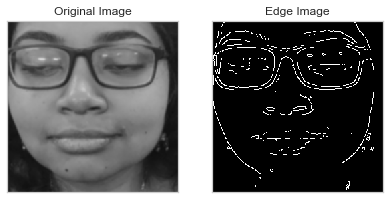


 84%|████████▍ | 74/88 [00:13<00:02,  6.15it/s]

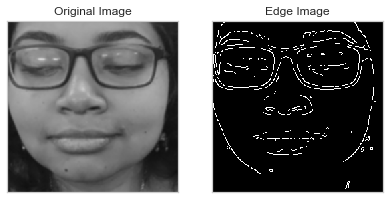


 85%|████████▌ | 75/88 [00:13<00:02,  6.35it/s]

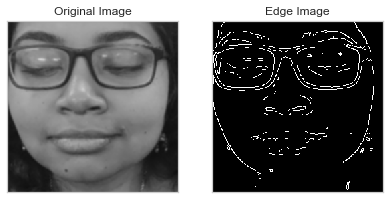


 86%|████████▋ | 76/88 [00:13<00:02,  5.01it/s]

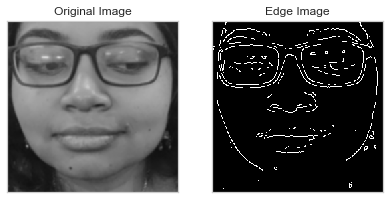


 88%|████████▊ | 77/88 [00:14<00:02,  4.66it/s]

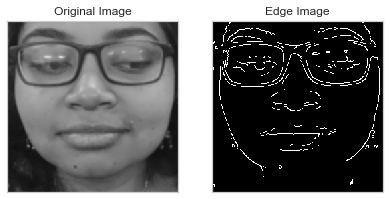


 89%|████████▊ | 78/88 [00:14<00:01,  5.07it/s]

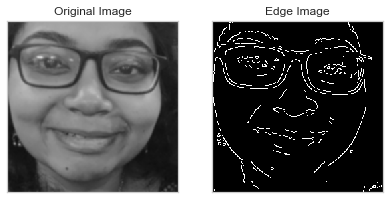


 90%|████████▉ | 79/88 [00:14<00:01,  5.37it/s]

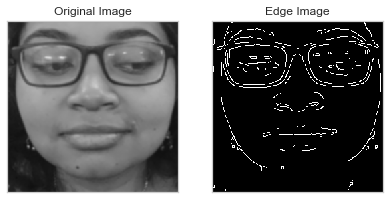


 91%|█████████ | 80/88 [00:14<00:01,  4.75it/s]

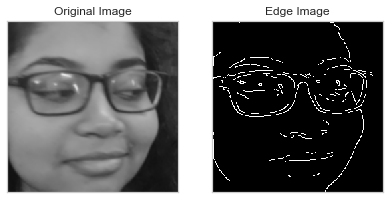


 92%|█████████▏| 81/88 [00:14<00:01,  5.26it/s]

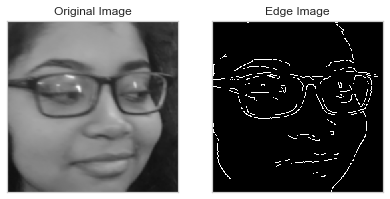


 93%|█████████▎| 82/88 [00:14<00:01,  5.50it/s]

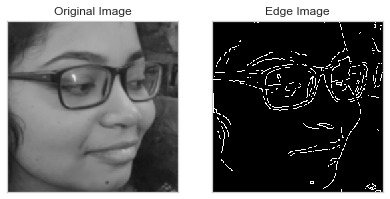


 94%|█████████▍| 83/88 [00:15<00:00,  5.68it/s]

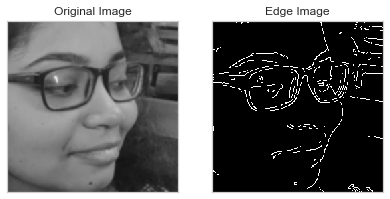


 95%|█████████▌| 84/88 [00:15<00:00,  5.98it/s]

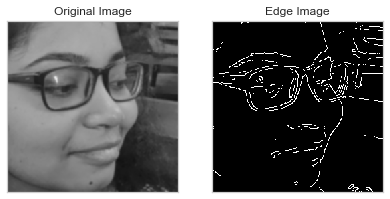


 97%|█████████▋| 85/88 [00:15<00:00,  6.10it/s]

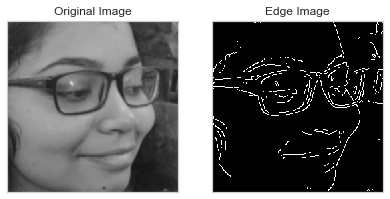


 98%|█████████▊| 86/88 [00:15<00:00,  6.25it/s]

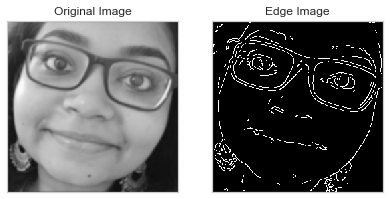


 99%|█████████▉| 87/88 [00:15<00:00,  5.89it/s]

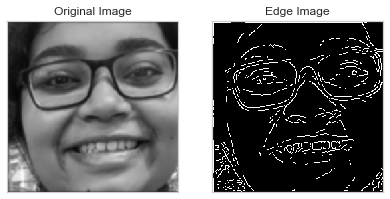


  0%|          | 0/94 [00:00<?, ?it/s]

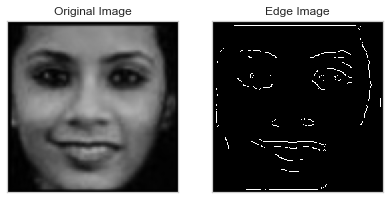


  1%|          | 1/94 [00:00<00:12,  7.43it/s]

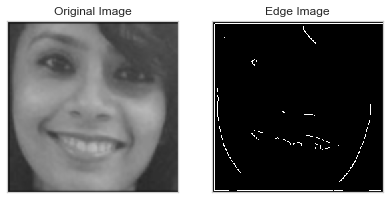


  2%|▏         | 2/94 [00:00<00:12,  7.49it/s]

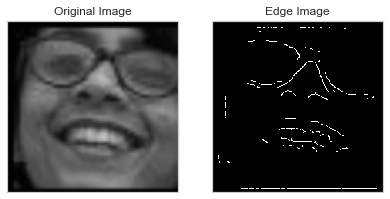


  3%|▎         | 3/94 [00:00<00:12,  7.31it/s]

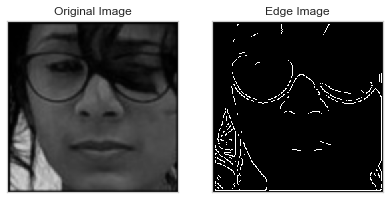


  4%|▍         | 4/94 [00:00<00:12,  7.43it/s]

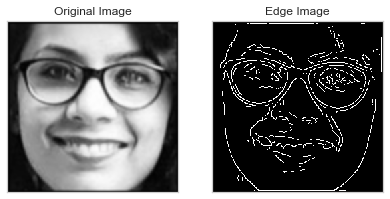


  5%|▌         | 5/94 [00:00<00:12,  7.05it/s]

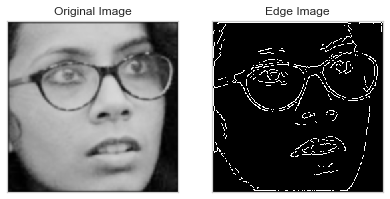


  6%|▋         | 6/94 [00:00<00:12,  7.30it/s]

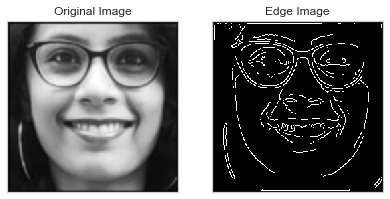


  7%|▋         | 7/94 [00:00<00:11,  7.42it/s]

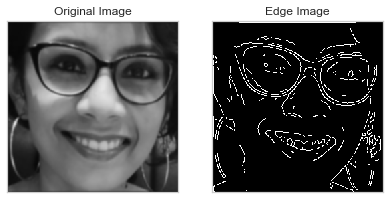


  9%|▊         | 8/94 [00:01<00:11,  7.21it/s]

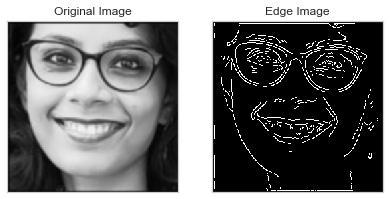


 10%|▉         | 9/94 [00:01<00:11,  7.23it/s]

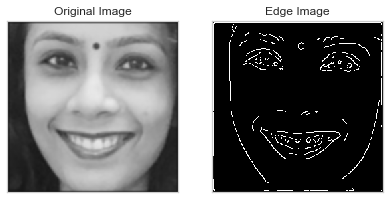


 11%|█         | 10/94 [00:01<00:11,  7.50it/s]

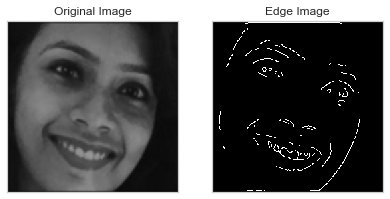


 12%|█▏        | 11/94 [00:01<00:10,  7.70it/s]

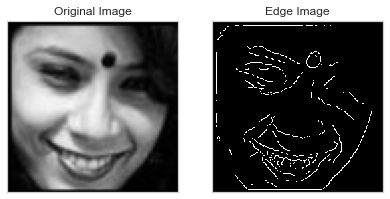


 13%|█▎        | 12/94 [00:01<00:10,  7.53it/s]

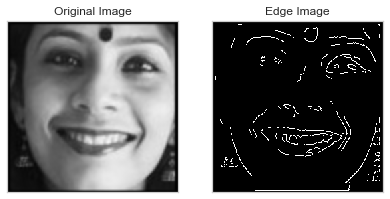


 14%|█▍        | 13/94 [00:01<00:11,  7.13it/s]

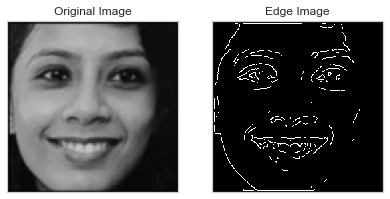


 15%|█▍        | 14/94 [00:01<00:10,  7.29it/s]

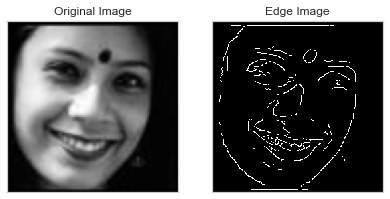


 16%|█▌        | 15/94 [00:02<00:10,  7.33it/s]

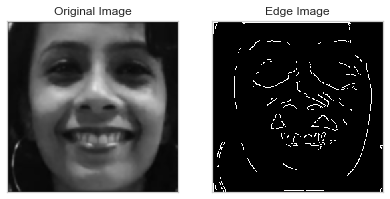


 17%|█▋        | 16/94 [00:02<00:10,  7.51it/s]

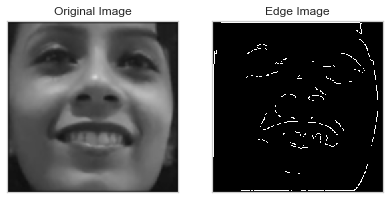


 18%|█▊        | 17/94 [00:02<00:10,  7.64it/s]

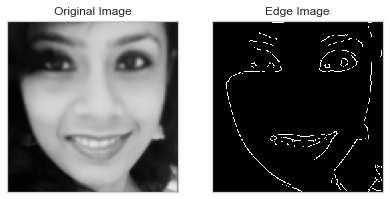


 19%|█▉        | 18/94 [00:02<00:09,  7.63it/s]

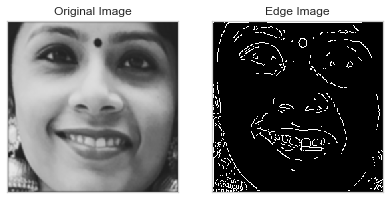


 20%|██        | 19/94 [00:02<00:10,  7.27it/s]

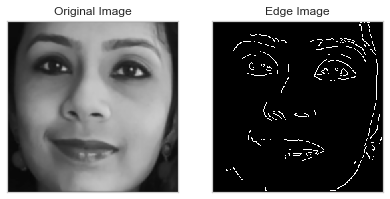


 21%|██▏       | 20/94 [00:02<00:13,  5.62it/s]

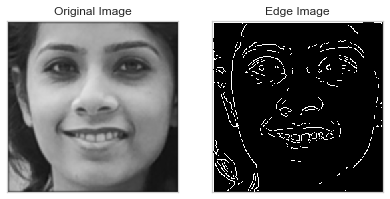


 22%|██▏       | 21/94 [00:02<00:11,  6.15it/s]

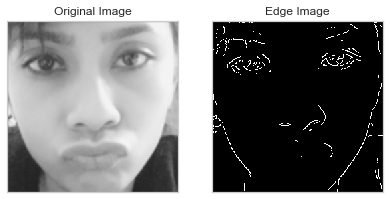


 23%|██▎       | 22/94 [00:03<00:11,  6.49it/s]

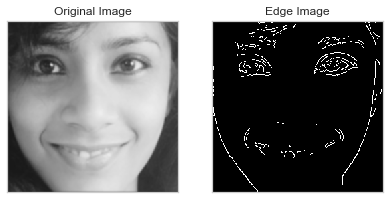


 24%|██▍       | 23/94 [00:03<00:11,  6.20it/s]

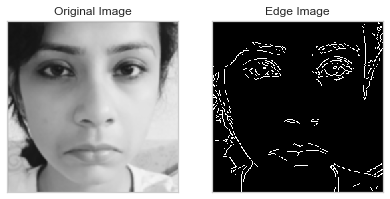


 26%|██▌       | 24/94 [00:03<00:10,  6.48it/s]

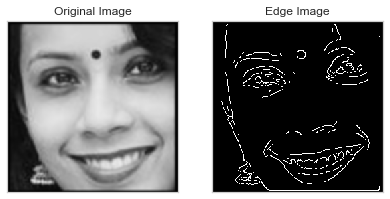


 27%|██▋       | 25/94 [00:03<00:10,  6.89it/s]

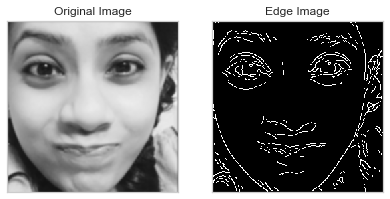


 28%|██▊       | 26/94 [00:03<00:09,  6.97it/s]

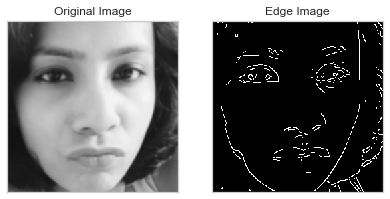


 29%|██▊       | 27/94 [00:03<00:09,  6.99it/s]

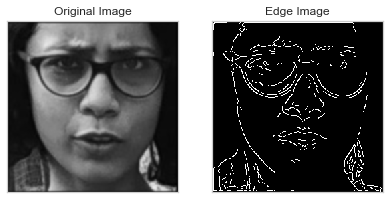


 30%|██▉       | 28/94 [00:03<00:09,  7.24it/s]

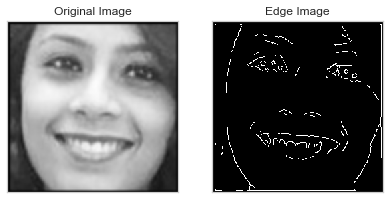


 31%|███       | 29/94 [00:04<00:08,  7.44it/s]

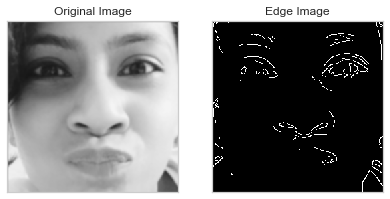


 32%|███▏      | 30/94 [00:04<00:08,  7.49it/s]

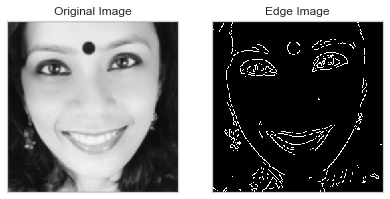


 33%|███▎      | 31/94 [00:04<00:08,  7.09it/s]

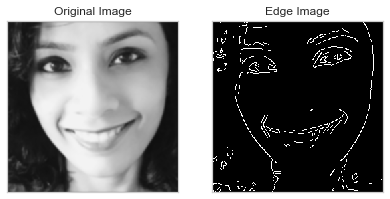


 34%|███▍      | 32/94 [00:04<00:08,  7.08it/s]

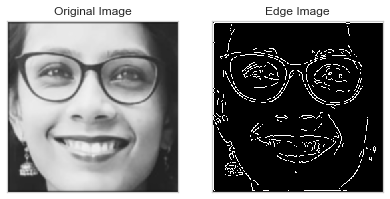


 35%|███▌      | 33/94 [00:04<00:08,  7.35it/s]

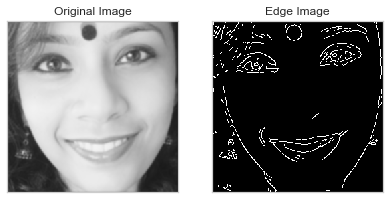


 36%|███▌      | 34/94 [00:04<00:08,  7.33it/s]

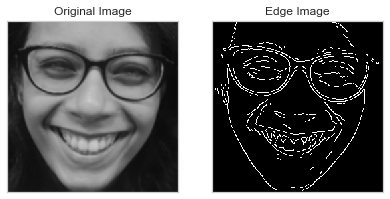


 37%|███▋      | 35/94 [00:04<00:08,  6.88it/s]

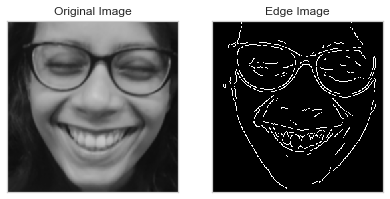


 38%|███▊      | 36/94 [00:05<00:08,  6.84it/s]

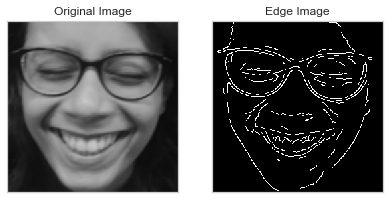


 39%|███▉      | 37/94 [00:05<00:08,  6.89it/s]

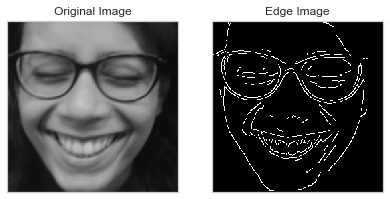


 40%|████      | 38/94 [00:05<00:08,  6.80it/s]

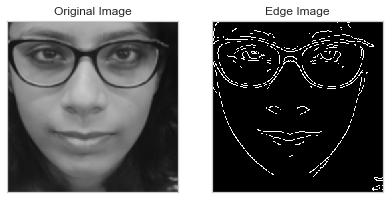


 41%|████▏     | 39/94 [00:05<00:08,  6.81it/s]

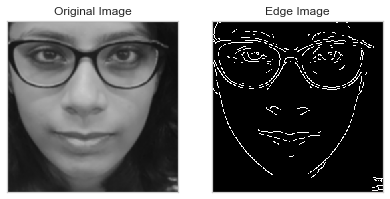


 43%|████▎     | 40/94 [00:05<00:08,  6.38it/s]

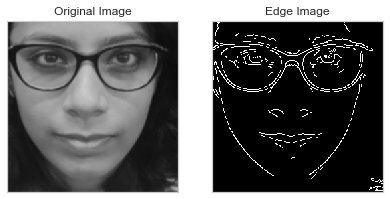


 44%|████▎     | 41/94 [00:05<00:08,  6.53it/s]

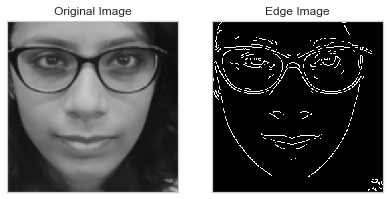


 45%|████▍     | 42/94 [00:06<00:07,  6.55it/s]

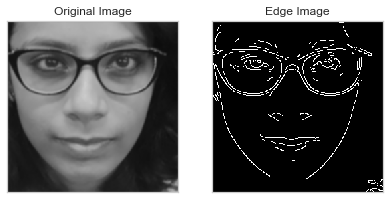


 46%|████▌     | 43/94 [00:06<00:07,  6.67it/s]

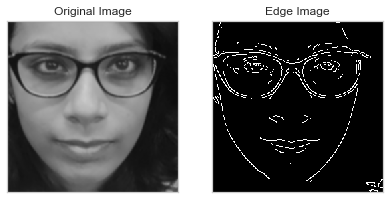


 47%|████▋     | 44/94 [00:06<00:07,  6.57it/s]

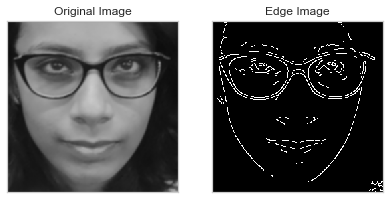


 48%|████▊     | 45/94 [00:06<00:07,  6.71it/s]

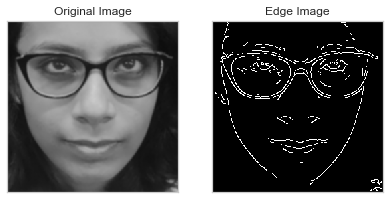


 49%|████▉     | 46/94 [00:06<00:07,  6.80it/s]

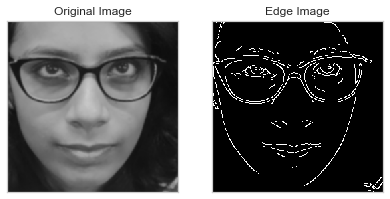


 50%|█████     | 47/94 [00:06<00:06,  6.82it/s]

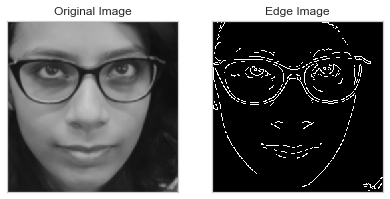


 51%|█████     | 48/94 [00:06<00:06,  6.90it/s]

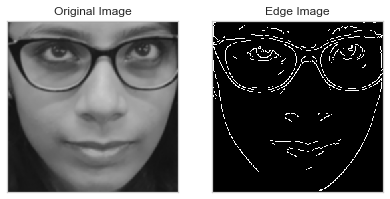


 52%|█████▏    | 49/94 [00:07<00:06,  6.99it/s]

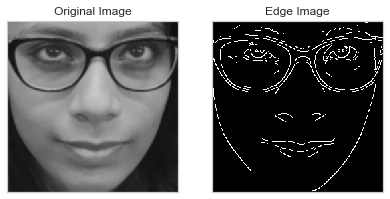


 53%|█████▎    | 50/94 [00:07<00:06,  6.87it/s]

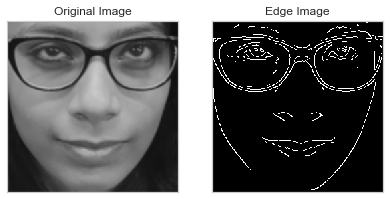


 54%|█████▍    | 51/94 [00:07<00:06,  6.64it/s]

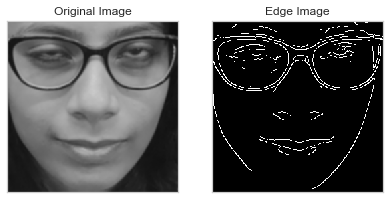


 55%|█████▌    | 52/94 [00:07<00:07,  5.32it/s]

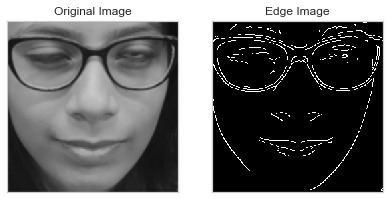


 56%|█████▋    | 53/94 [00:07<00:07,  5.76it/s]

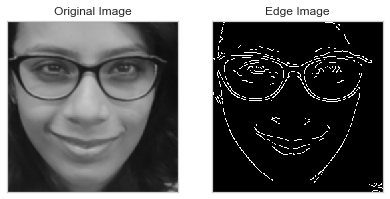


 57%|█████▋    | 54/94 [00:07<00:06,  6.12it/s]

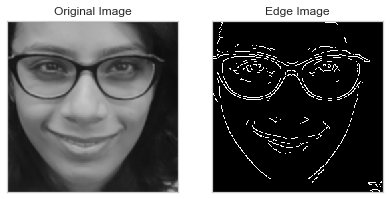


 59%|█████▊    | 55/94 [00:08<00:06,  5.94it/s]

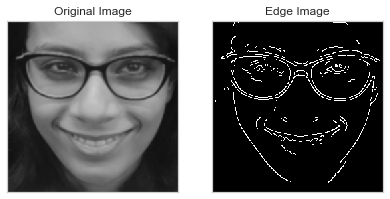


 60%|█████▉    | 56/94 [00:08<00:06,  6.11it/s]

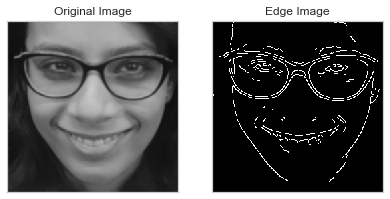


 61%|██████    | 57/94 [00:08<00:05,  6.27it/s]

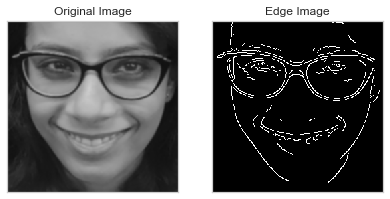


 62%|██████▏   | 58/94 [00:08<00:05,  6.52it/s]

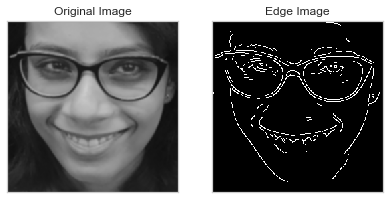


 63%|██████▎   | 59/94 [00:08<00:05,  6.68it/s]

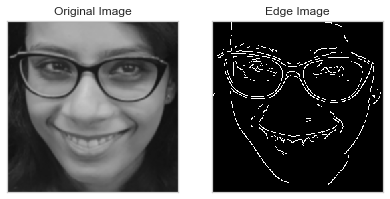


 64%|██████▍   | 60/94 [00:08<00:04,  6.83it/s]

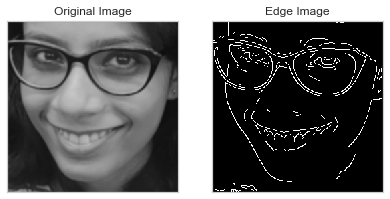


 65%|██████▍   | 61/94 [00:08<00:04,  6.97it/s]

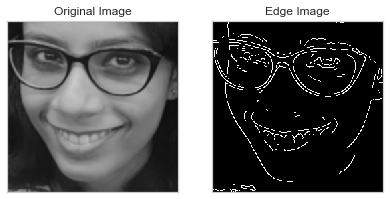


 66%|██████▌   | 62/94 [00:09<00:04,  6.72it/s]

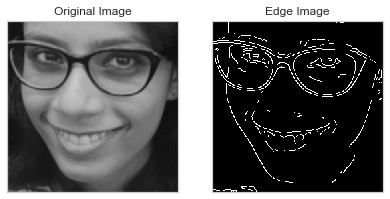


 67%|██████▋   | 63/94 [00:09<00:04,  6.83it/s]

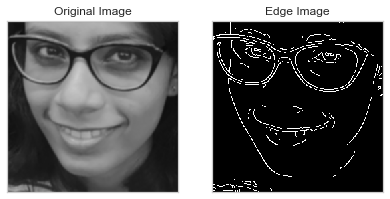


 68%|██████▊   | 64/94 [00:09<00:04,  6.86it/s]

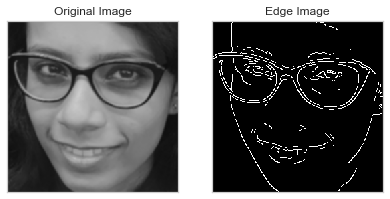


 69%|██████▉   | 65/94 [00:09<00:04,  6.96it/s]

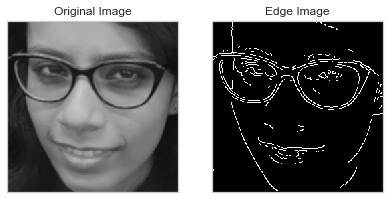


 70%|███████   | 66/94 [00:09<00:04,  6.63it/s]

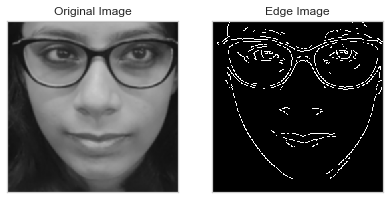


 71%|███████▏  | 67/94 [00:09<00:03,  6.77it/s]

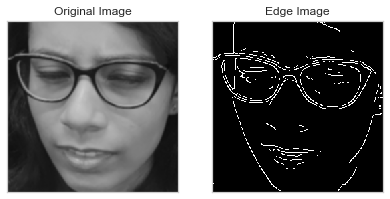


 72%|███████▏  | 68/94 [00:09<00:03,  6.75it/s]

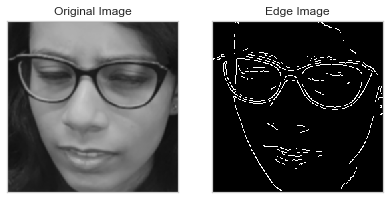


 73%|███████▎  | 69/94 [00:10<00:03,  6.37it/s]

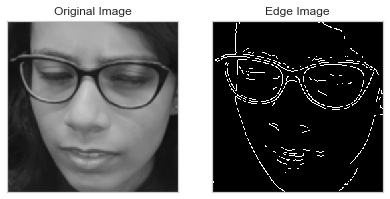


 74%|███████▍  | 70/94 [00:10<00:03,  6.14it/s]

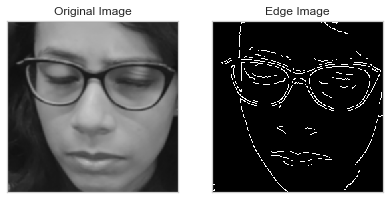


 76%|███████▌  | 71/94 [00:10<00:03,  6.00it/s]

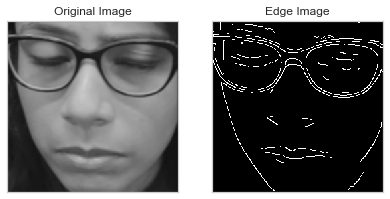


 77%|███████▋  | 72/94 [00:10<00:03,  6.01it/s]

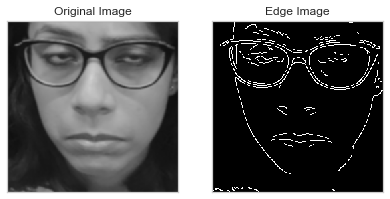


 78%|███████▊  | 73/94 [00:11<00:04,  4.48it/s]

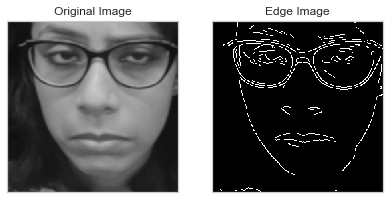


 79%|███████▊  | 74/94 [00:11<00:04,  4.51it/s]

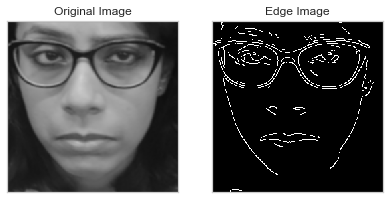


 80%|███████▉  | 75/94 [00:11<00:04,  4.71it/s]

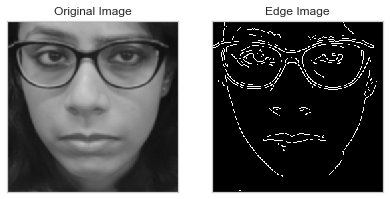


 81%|████████  | 76/94 [00:11<00:03,  4.98it/s]

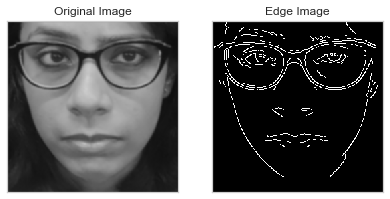


 82%|████████▏ | 77/94 [00:11<00:03,  5.41it/s]

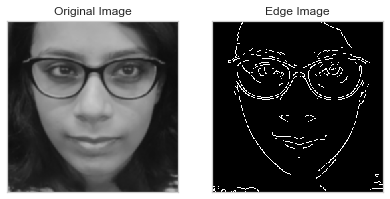


 83%|████████▎ | 78/94 [00:11<00:02,  5.70it/s]

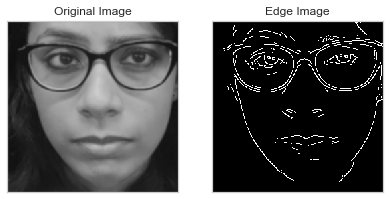


 84%|████████▍ | 79/94 [00:12<00:02,  5.47it/s]

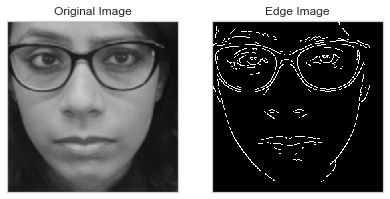


 85%|████████▌ | 80/94 [00:12<00:02,  5.79it/s]

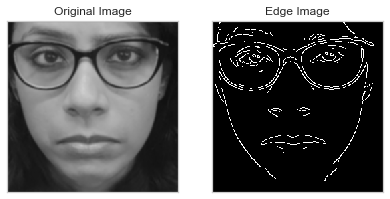


 86%|████████▌ | 81/94 [00:12<00:02,  6.17it/s]

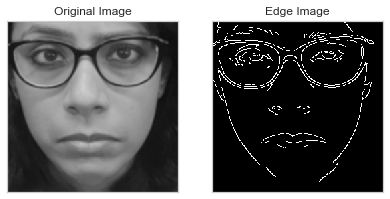


 87%|████████▋ | 82/94 [00:12<00:01,  6.30it/s]

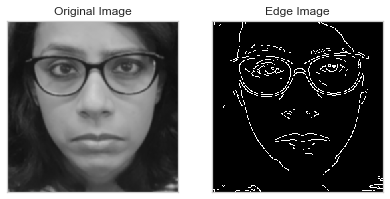


 88%|████████▊ | 83/94 [00:12<00:01,  6.47it/s]

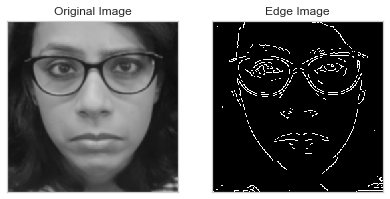


 89%|████████▉ | 84/94 [00:12<00:01,  5.23it/s]

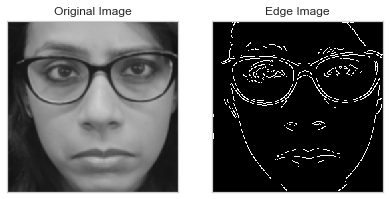


 90%|█████████ | 85/94 [00:13<00:01,  5.70it/s]

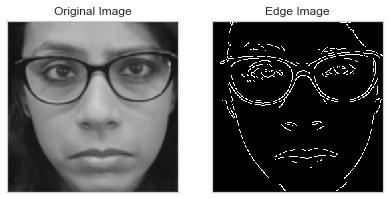


 91%|█████████▏| 86/94 [00:13<00:01,  5.24it/s]

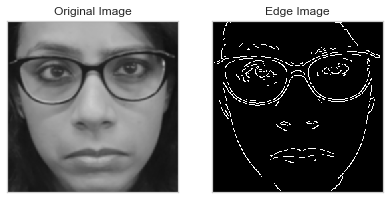


 93%|█████████▎| 87/94 [00:13<00:01,  5.47it/s]

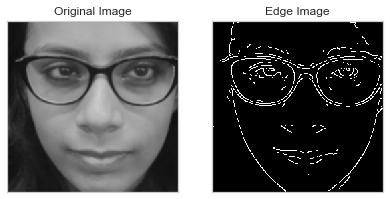


 94%|█████████▎| 88/94 [00:13<00:01,  5.34it/s]

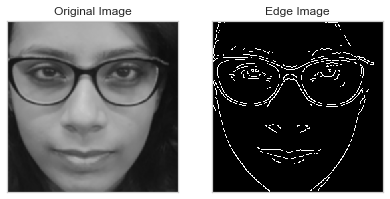


 95%|█████████▍| 89/94 [00:13<00:00,  5.33it/s]

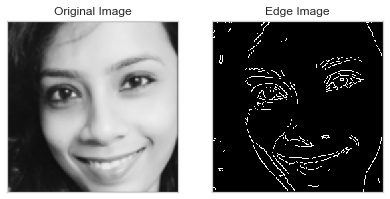


 96%|█████████▌| 90/94 [00:14<00:00,  5.44it/s]

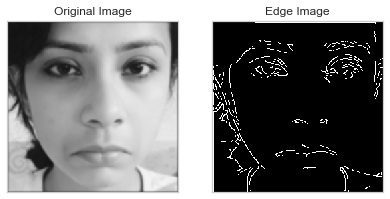


 97%|█████████▋| 91/94 [00:14<00:00,  5.68it/s]

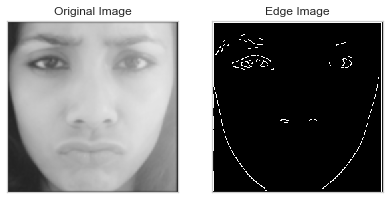


 98%|█████████▊| 92/94 [00:14<00:00,  5.71it/s]

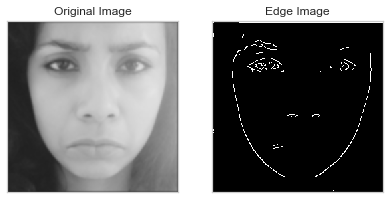


 99%|█████████▉| 93/94 [00:14<00:00,  5.77it/s]

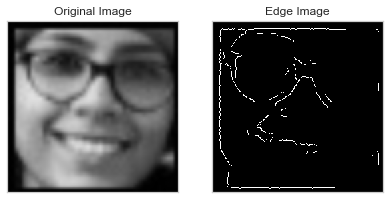


  0%|          | 0/2 [00:00<?, ?it/s]

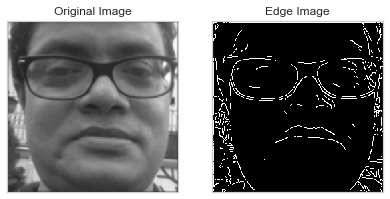


 50%|█████     | 1/2 [00:00<00:00,  4.71it/s]

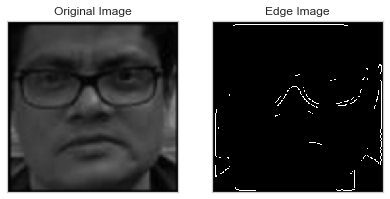


  0%|          | 0/96 [00:00<?, ?it/s]

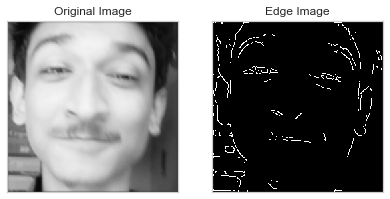


  1%|          | 1/96 [00:00<00:15,  6.11it/s]

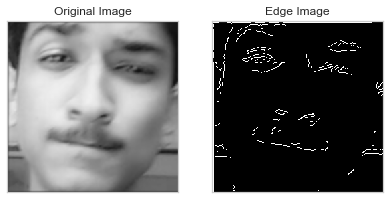


  2%|▏         | 2/96 [00:00<00:15,  5.96it/s]

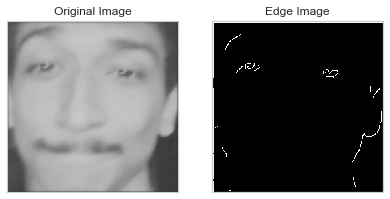


  3%|▎         | 3/96 [00:00<00:15,  5.92it/s]

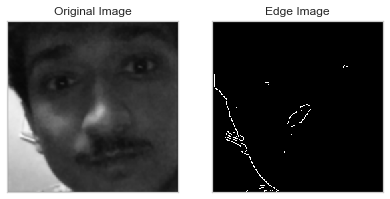


  4%|▍         | 4/96 [00:00<00:15,  5.90it/s]

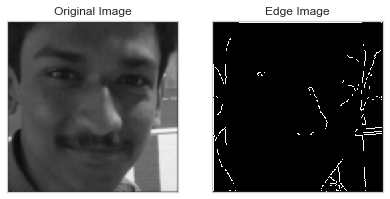


  5%|▌         | 5/96 [00:00<00:15,  6.05it/s]

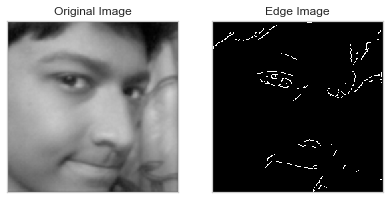


  6%|▋         | 6/96 [00:00<00:14,  6.13it/s]

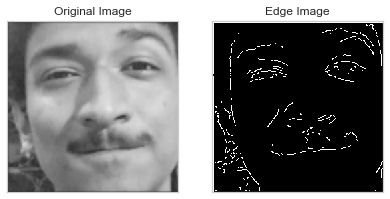


  7%|▋         | 7/96 [00:01<00:14,  6.18it/s]

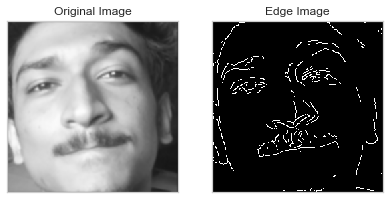


  8%|▊         | 8/96 [00:01<00:15,  5.75it/s]

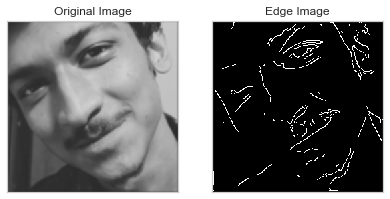


  9%|▉         | 9/96 [00:01<00:15,  5.52it/s]

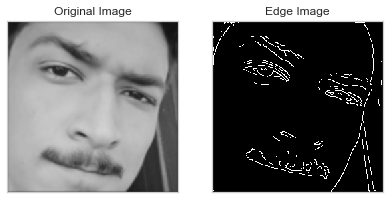


 10%|█         | 10/96 [00:01<00:15,  5.67it/s]

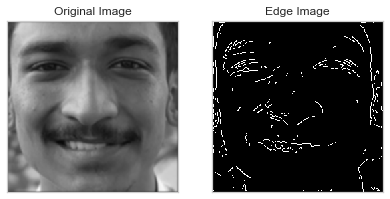


 11%|█▏        | 11/96 [00:01<00:15,  5.67it/s]

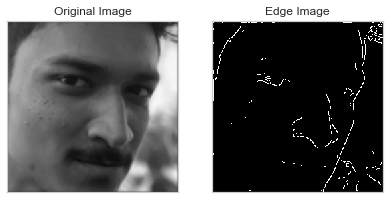


 12%|█▎        | 12/96 [00:02<00:15,  5.43it/s]

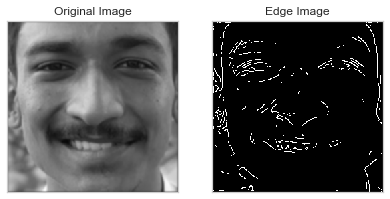


 14%|█▎        | 13/96 [00:02<00:14,  5.88it/s]

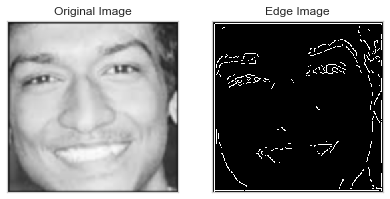


 15%|█▍        | 14/96 [00:02<00:14,  5.73it/s]

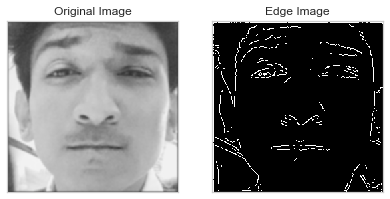


 16%|█▌        | 15/96 [00:02<00:13,  5.95it/s]

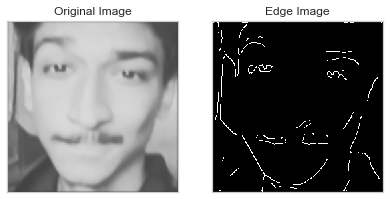


 17%|█▋        | 16/96 [00:02<00:12,  6.36it/s]

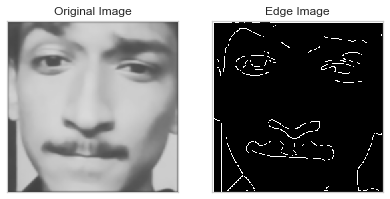


 18%|█▊        | 17/96 [00:02<00:12,  6.26it/s]

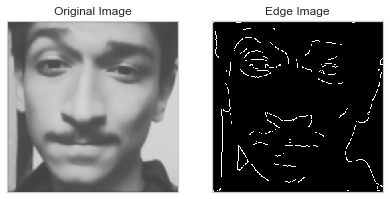


 19%|█▉        | 18/96 [00:03<00:12,  6.41it/s]

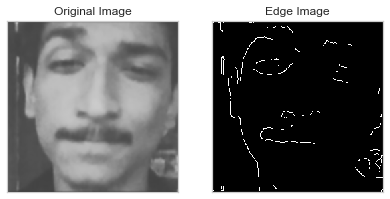


 20%|█▉        | 19/96 [00:03<00:11,  6.62it/s]

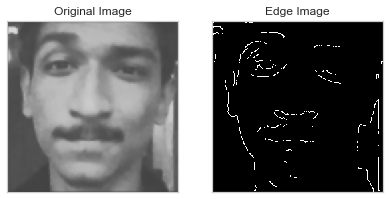


 21%|██        | 20/96 [00:03<00:15,  4.95it/s]

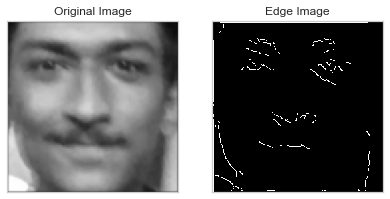


 22%|██▏       | 21/96 [00:03<00:13,  5.48it/s]

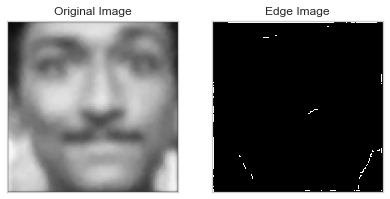


 23%|██▎       | 22/96 [00:03<00:12,  5.90it/s]

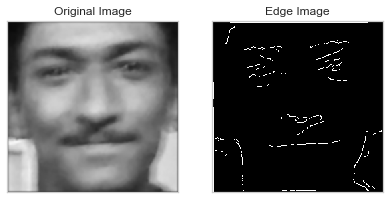


 24%|██▍       | 23/96 [00:03<00:11,  6.11it/s]

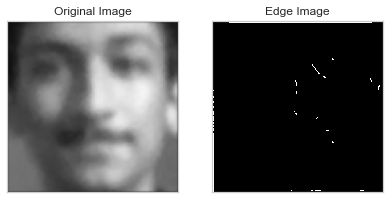


 25%|██▌       | 24/96 [00:04<00:11,  6.32it/s]

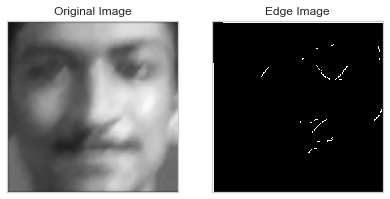


 26%|██▌       | 25/96 [00:04<00:11,  6.40it/s]

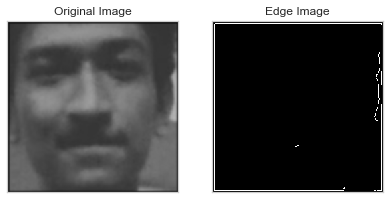


 27%|██▋       | 26/96 [00:04<00:10,  6.48it/s]

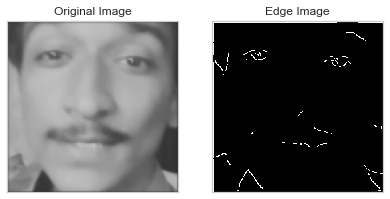


 28%|██▊       | 27/96 [00:04<00:10,  6.59it/s]

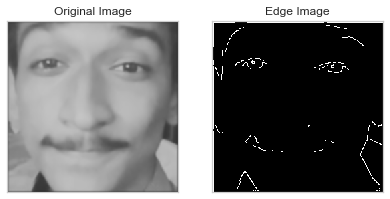


 29%|██▉       | 28/96 [00:04<00:10,  6.22it/s]

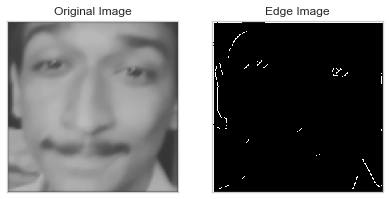


 30%|███       | 29/96 [00:04<00:10,  6.55it/s]

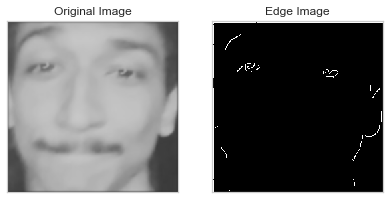


 31%|███▏      | 30/96 [00:04<00:09,  6.83it/s]

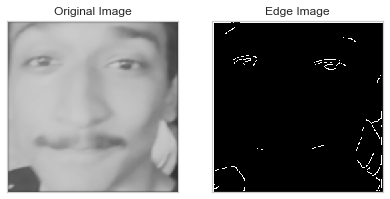


 32%|███▏      | 31/96 [00:05<00:11,  5.71it/s]

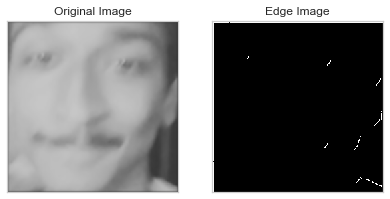


 33%|███▎      | 32/96 [00:05<00:10,  6.07it/s]

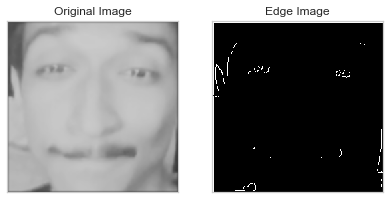


 34%|███▍      | 33/96 [00:05<00:09,  6.38it/s]

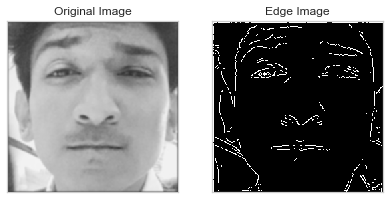


 35%|███▌      | 34/96 [00:05<00:09,  6.64it/s]

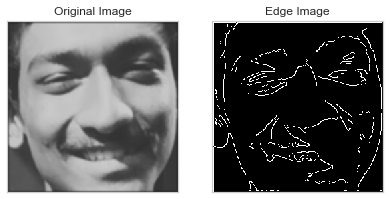


 36%|███▋      | 35/96 [00:05<00:09,  6.64it/s]

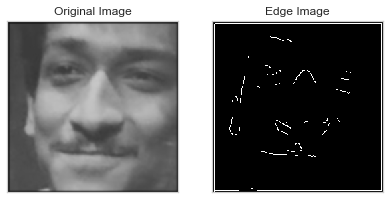


 38%|███▊      | 36/96 [00:05<00:10,  5.77it/s]

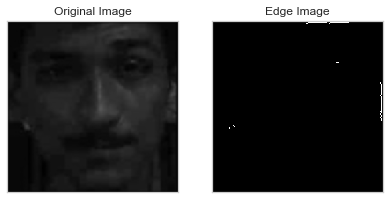


 39%|███▊      | 37/96 [00:06<00:09,  6.32it/s]

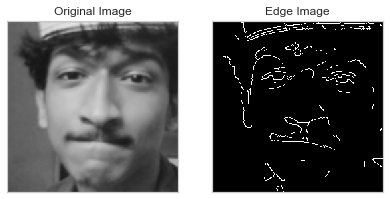


 40%|███▉      | 38/96 [00:06<00:08,  6.64it/s]

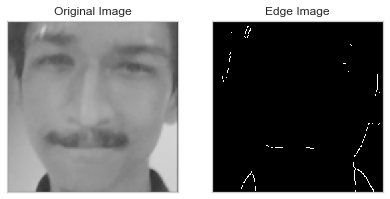


 41%|████      | 39/96 [00:06<00:08,  6.81it/s]

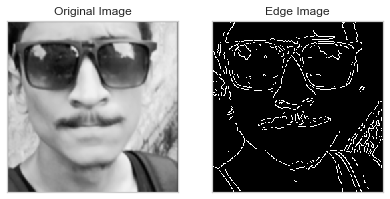


 42%|████▏     | 40/96 [00:06<00:08,  6.98it/s]

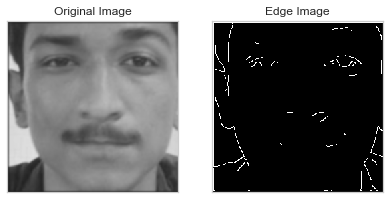


 43%|████▎     | 41/96 [00:06<00:07,  7.34it/s]

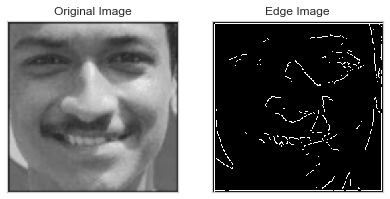


 44%|████▍     | 42/96 [00:06<00:07,  7.47it/s]

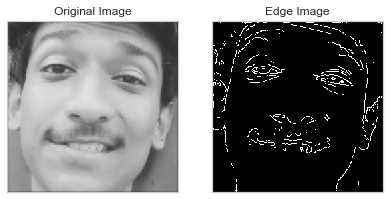


 45%|████▍     | 43/96 [00:06<00:07,  7.28it/s]

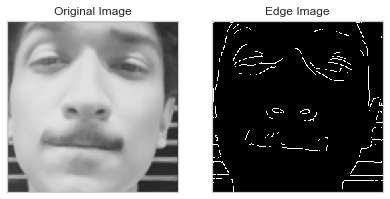


 46%|████▌     | 44/96 [00:07<00:07,  7.36it/s]

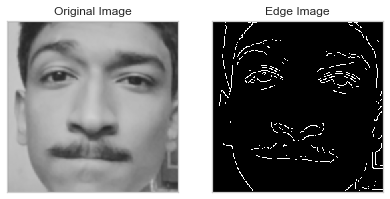


 47%|████▋     | 45/96 [00:07<00:06,  7.49it/s]

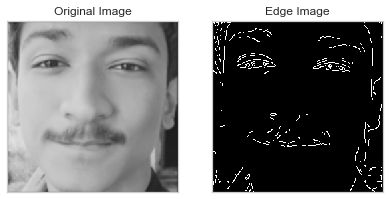


 48%|████▊     | 46/96 [00:07<00:06,  7.66it/s]

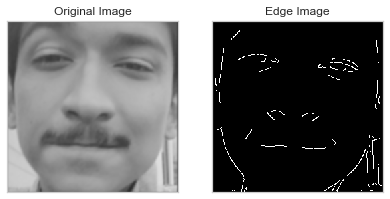


 49%|████▉     | 47/96 [00:07<00:06,  7.36it/s]

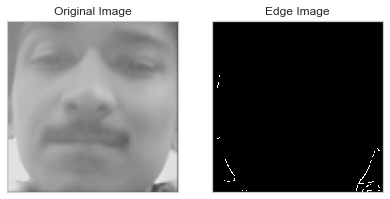


 50%|█████     | 48/96 [00:07<00:06,  7.69it/s]

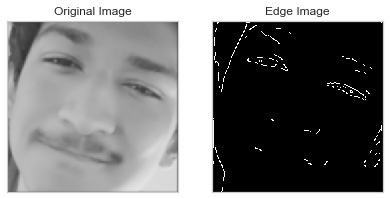


 51%|█████     | 49/96 [00:07<00:05,  7.86it/s]

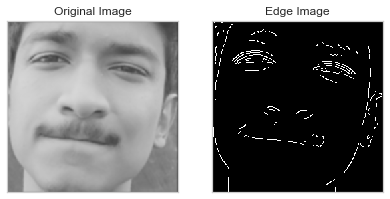


 52%|█████▏    | 50/96 [00:07<00:05,  7.84it/s]

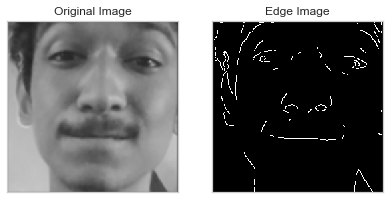


 53%|█████▎    | 51/96 [00:07<00:05,  7.62it/s]

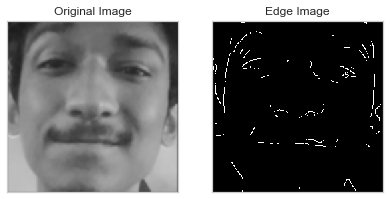


 54%|█████▍    | 52/96 [00:08<00:07,  5.92it/s]

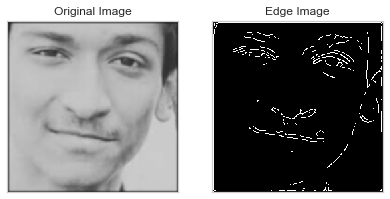


 55%|█████▌    | 53/96 [00:08<00:06,  6.52it/s]

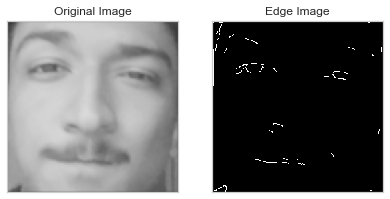


 56%|█████▋    | 54/96 [00:08<00:06,  6.98it/s]

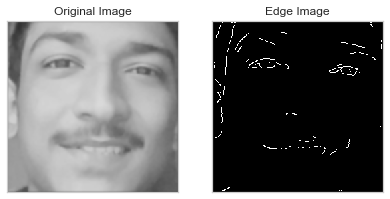


 57%|█████▋    | 55/96 [00:08<00:06,  6.48it/s]

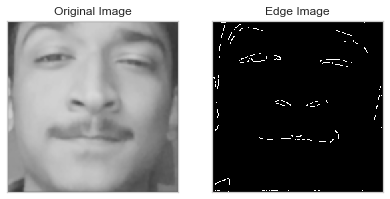


 58%|█████▊    | 56/96 [00:08<00:05,  6.74it/s]

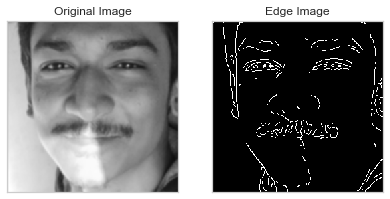


 59%|█████▉    | 57/96 [00:08<00:05,  6.93it/s]

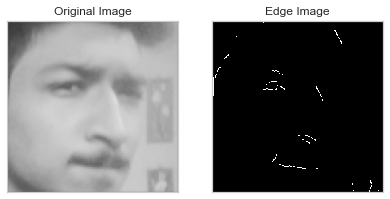


 60%|██████    | 58/96 [00:09<00:05,  7.23it/s]

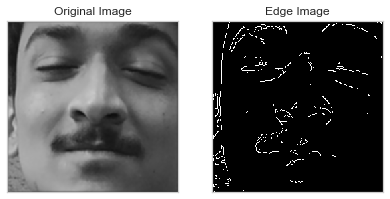


 61%|██████▏   | 59/96 [00:09<00:04,  7.48it/s]

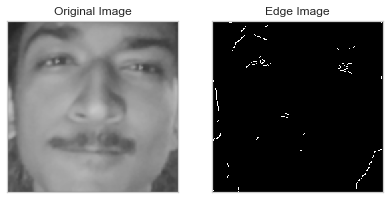


 62%|██████▎   | 60/96 [00:09<00:04,  7.42it/s]

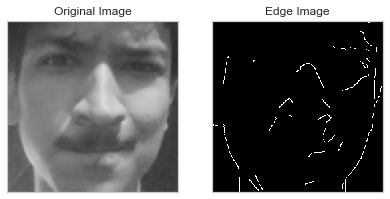


 64%|██████▎   | 61/96 [00:09<00:05,  6.96it/s]

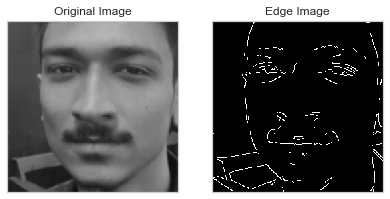


 65%|██████▍   | 62/96 [00:09<00:05,  6.17it/s]

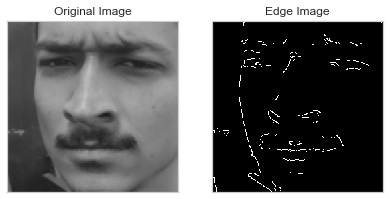


 66%|██████▌   | 63/96 [00:09<00:05,  6.27it/s]

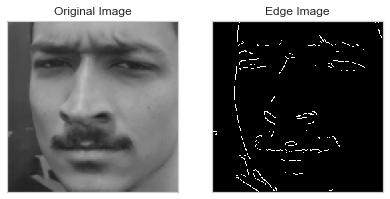


 67%|██████▋   | 64/96 [00:09<00:05,  6.22it/s]

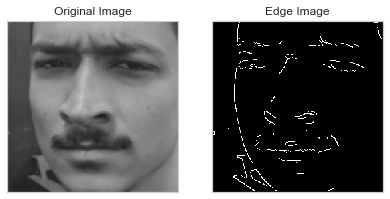


 68%|██████▊   | 65/96 [00:10<00:04,  6.23it/s]

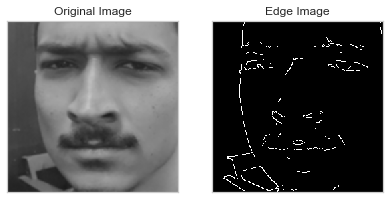


 69%|██████▉   | 66/96 [00:10<00:04,  6.29it/s]

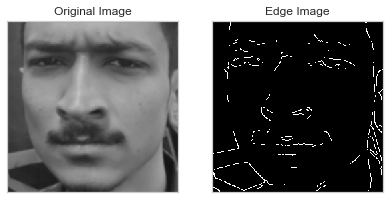


 70%|██████▉   | 67/96 [00:10<00:04,  6.31it/s]

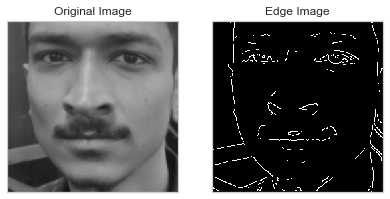


 71%|███████   | 68/96 [00:10<00:04,  5.63it/s]

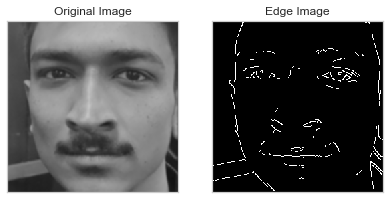


 72%|███████▏  | 69/96 [00:10<00:05,  4.70it/s]

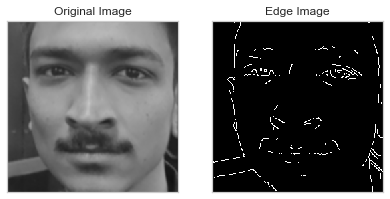


 73%|███████▎  | 70/96 [00:11<00:05,  5.11it/s]

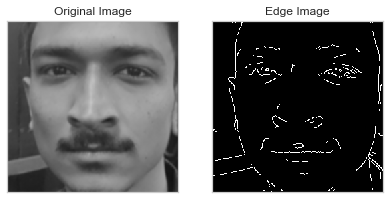


 74%|███████▍  | 71/96 [00:11<00:04,  5.12it/s]

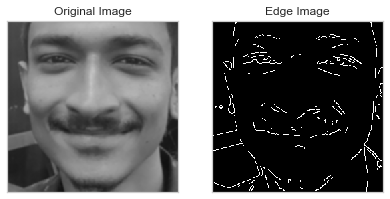


 75%|███████▌  | 72/96 [00:11<00:04,  5.18it/s]

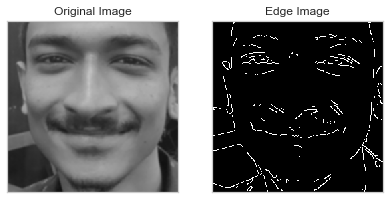


 76%|███████▌  | 73/96 [00:11<00:04,  5.07it/s]

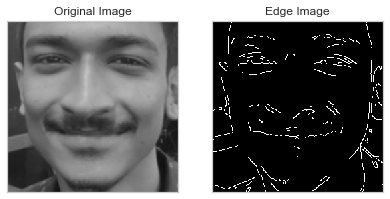


 77%|███████▋  | 74/96 [00:11<00:04,  5.04it/s]

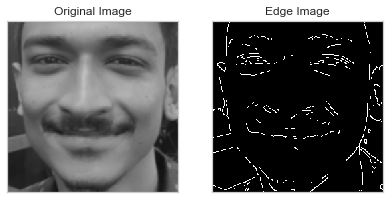


 78%|███████▊  | 75/96 [00:12<00:04,  5.17it/s]

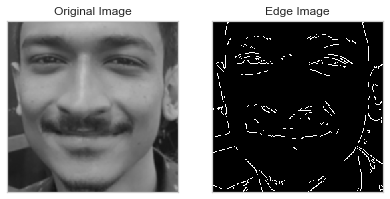


 79%|███████▉  | 76/96 [00:12<00:03,  5.16it/s]

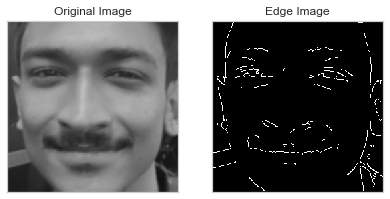


 80%|████████  | 77/96 [00:12<00:03,  5.38it/s]

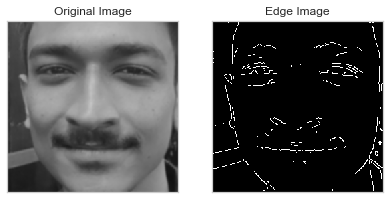


 81%|████████▏ | 78/96 [00:12<00:03,  4.78it/s]

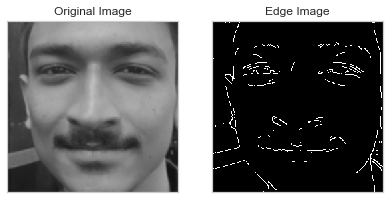


 82%|████████▏ | 79/96 [00:12<00:03,  5.14it/s]

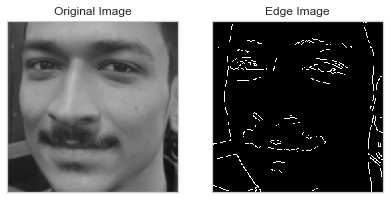


 83%|████████▎ | 80/96 [00:13<00:02,  5.63it/s]

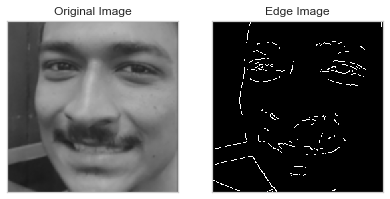


 84%|████████▍ | 81/96 [00:13<00:02,  5.95it/s]

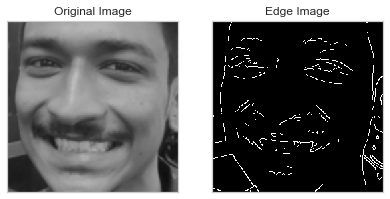


 85%|████████▌ | 82/96 [00:13<00:02,  6.15it/s]

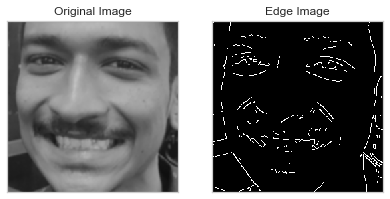


 86%|████████▋ | 83/96 [00:13<00:02,  5.94it/s]

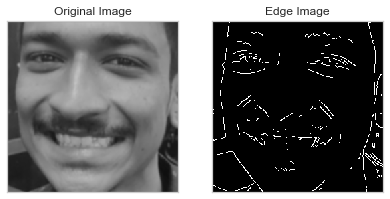


 88%|████████▊ | 84/96 [00:13<00:02,  4.92it/s]

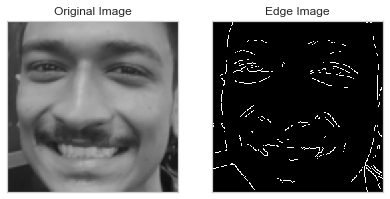


 89%|████████▊ | 85/96 [00:13<00:02,  5.39it/s]

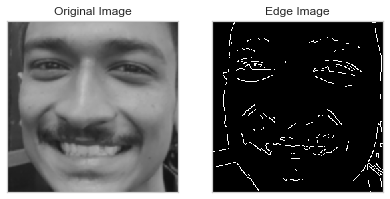


 90%|████████▉ | 86/96 [00:14<00:01,  5.68it/s]

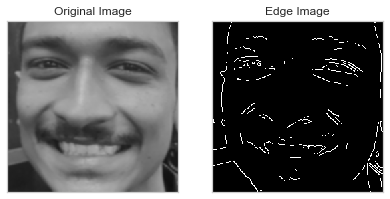


 91%|█████████ | 87/96 [00:14<00:01,  6.04it/s]

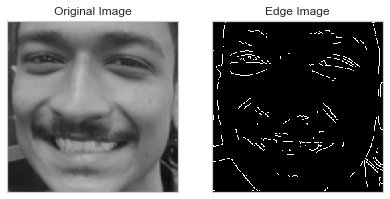


 92%|█████████▏| 88/96 [00:14<00:01,  6.14it/s]

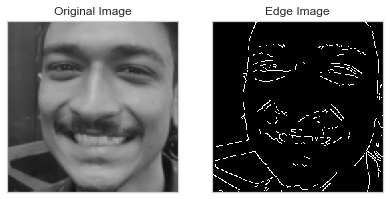


 93%|█████████▎| 89/96 [00:14<00:01,  5.88it/s]

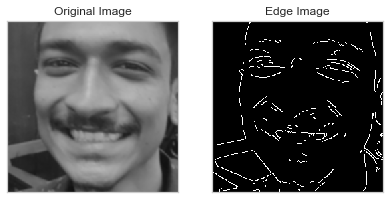


 94%|█████████▍| 90/96 [00:14<00:01,  5.87it/s]

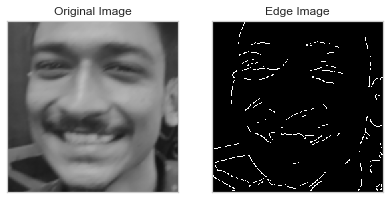


 95%|█████████▍| 91/96 [00:14<00:00,  5.58it/s]

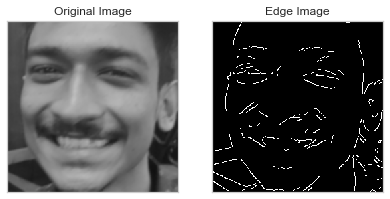


 96%|█████████▌| 92/96 [00:15<00:00,  5.94it/s]

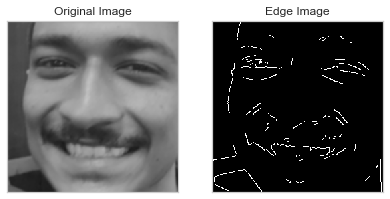


 97%|█████████▋| 93/96 [00:15<00:00,  6.03it/s]

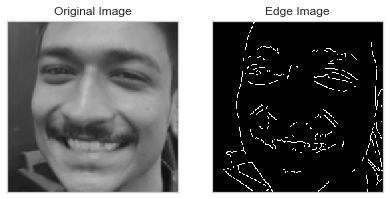


 98%|█████████▊| 94/96 [00:15<00:00,  6.02it/s]

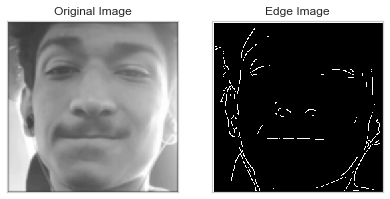


 99%|█████████▉| 95/96 [00:15<00:00,  5.93it/s]

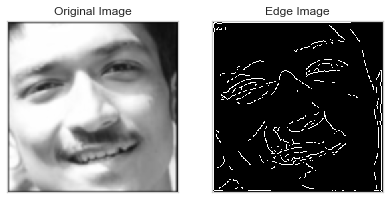


  0%|          | 0/93 [00:00<?, ?it/s]

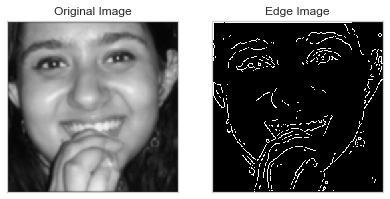


  1%|          | 1/93 [00:00<00:16,  5.50it/s]

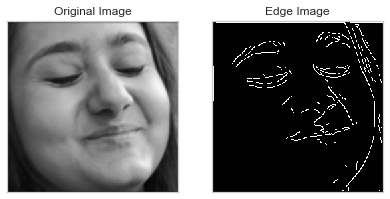


  2%|▏         | 2/93 [00:00<00:15,  5.92it/s]

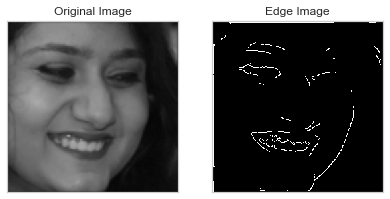


  3%|▎         | 3/93 [00:00<00:14,  6.16it/s]

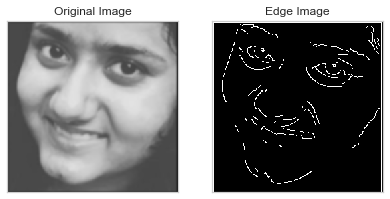


  4%|▍         | 4/93 [00:00<00:14,  6.15it/s]

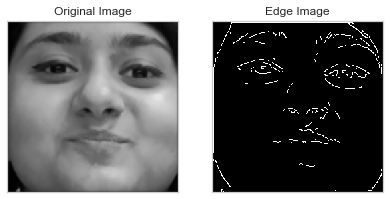


  5%|▌         | 5/93 [00:00<00:14,  6.24it/s]

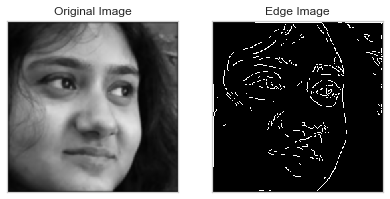


  6%|▋         | 6/93 [00:00<00:13,  6.36it/s]

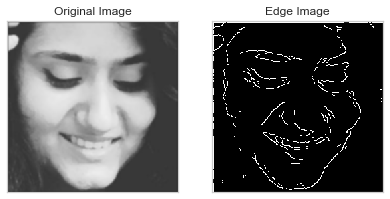


  8%|▊         | 7/93 [00:01<00:13,  6.25it/s]

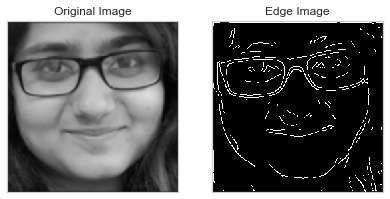


  9%|▊         | 8/93 [00:01<00:13,  6.41it/s]

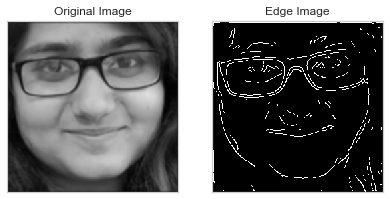


 10%|▉         | 9/93 [00:01<00:12,  6.65it/s]

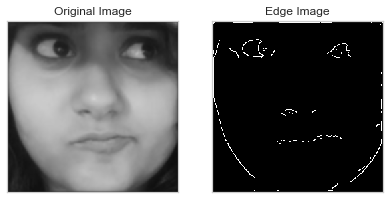


 11%|█         | 10/93 [00:01<00:12,  6.74it/s]

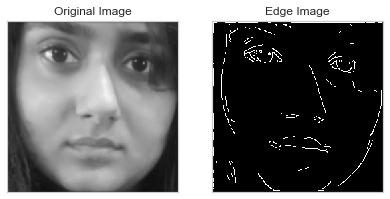


 12%|█▏        | 11/93 [00:01<00:12,  6.74it/s]

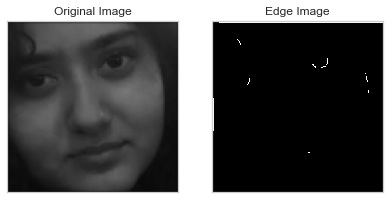


 13%|█▎        | 12/93 [00:01<00:11,  7.03it/s]

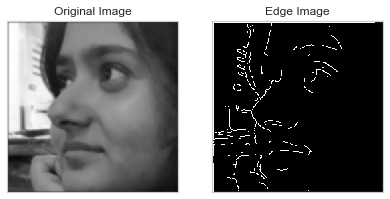


 14%|█▍        | 13/93 [00:01<00:11,  7.08it/s]

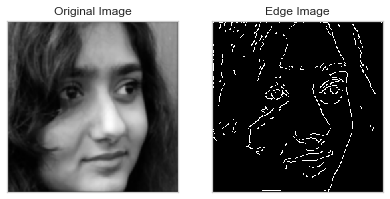


 15%|█▌        | 14/93 [00:02<00:11,  6.92it/s]

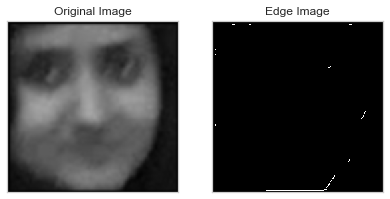


 16%|█▌        | 15/93 [00:02<00:11,  6.69it/s]

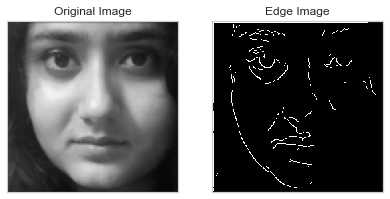


 17%|█▋        | 16/93 [00:02<00:11,  6.87it/s]

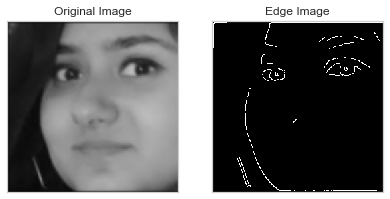


 18%|█▊        | 17/93 [00:02<00:11,  6.35it/s]

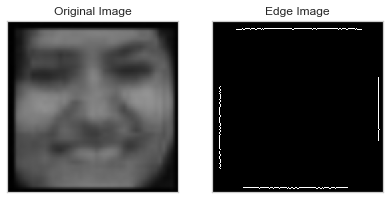


 19%|█▉        | 18/93 [00:02<00:11,  6.64it/s]

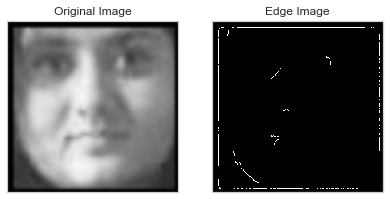


 20%|██        | 19/93 [00:02<00:10,  6.94it/s]

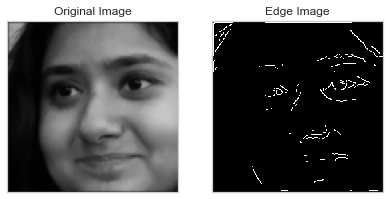


 22%|██▏       | 20/93 [00:03<00:13,  5.34it/s]

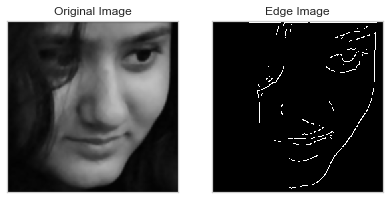


 23%|██▎       | 21/93 [00:03<00:12,  5.87it/s]

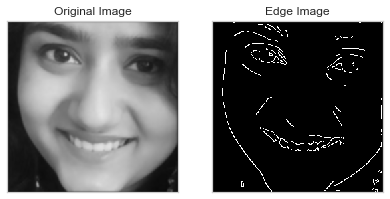


 24%|██▎       | 22/93 [00:03<00:11,  6.09it/s]

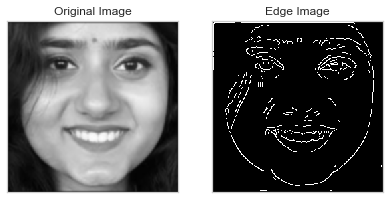


 25%|██▍       | 23/93 [00:03<00:10,  6.52it/s]

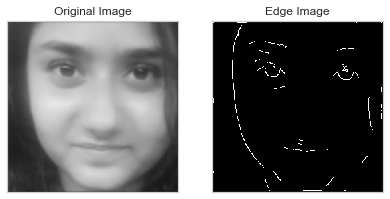


 26%|██▌       | 24/93 [00:03<00:10,  6.79it/s]

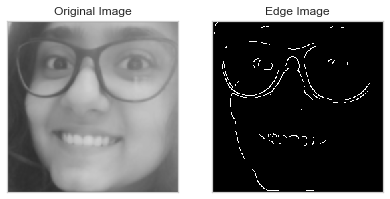


 27%|██▋       | 25/93 [00:03<00:09,  6.93it/s]

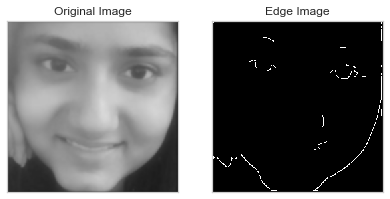


 28%|██▊       | 26/93 [00:03<00:10,  6.57it/s]

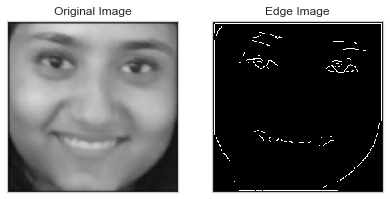


 29%|██▉       | 27/93 [00:04<00:09,  6.77it/s]

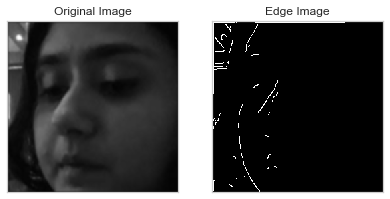


 30%|███       | 28/93 [00:04<00:09,  7.00it/s]

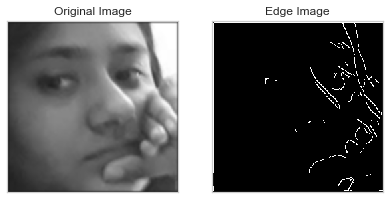


 31%|███       | 29/93 [00:04<00:09,  7.03it/s]

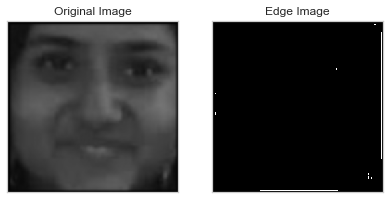


 32%|███▏      | 30/93 [00:04<00:09,  6.66it/s]

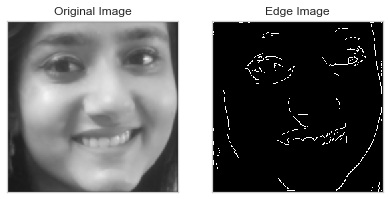


 33%|███▎      | 31/93 [00:04<00:09,  6.71it/s]

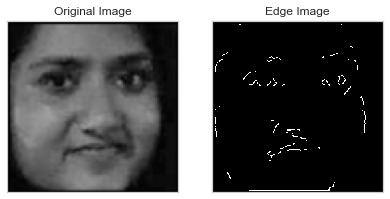


 34%|███▍      | 32/93 [00:04<00:09,  6.60it/s]

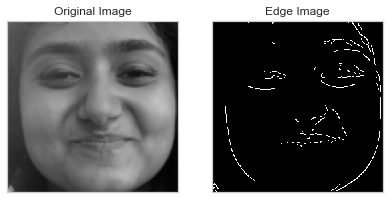


 35%|███▌      | 33/93 [00:05<00:09,  6.62it/s]

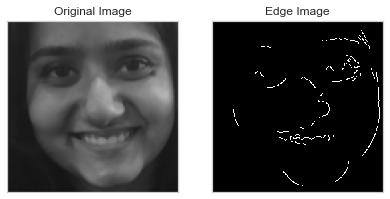


 37%|███▋      | 34/93 [00:05<00:09,  6.44it/s]

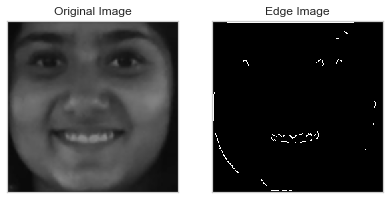


 38%|███▊      | 35/93 [00:05<00:08,  6.76it/s]

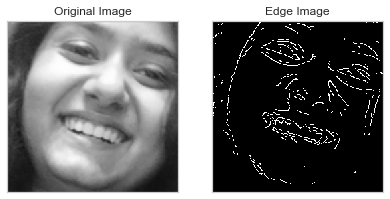


 39%|███▊      | 36/93 [00:05<00:08,  6.43it/s]

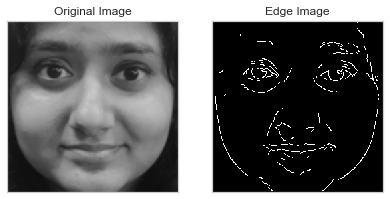


 40%|███▉      | 37/93 [00:05<00:08,  6.23it/s]

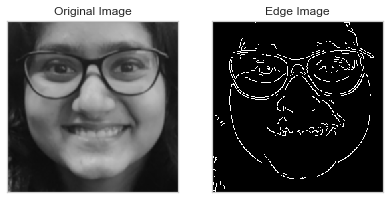


 41%|████      | 38/93 [00:05<00:08,  6.27it/s]

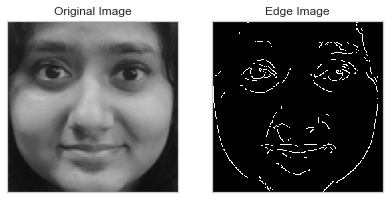


 42%|████▏     | 39/93 [00:05<00:08,  6.40it/s]

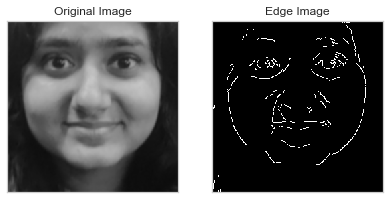


 43%|████▎     | 40/93 [00:06<00:08,  6.44it/s]

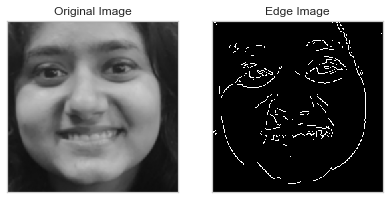


 44%|████▍     | 41/93 [00:06<00:07,  6.53it/s]

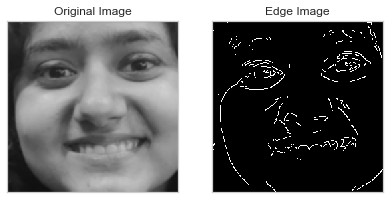


 45%|████▌     | 42/93 [00:06<00:08,  5.93it/s]

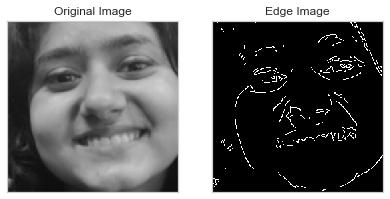


 46%|████▌     | 43/93 [00:06<00:08,  6.02it/s]

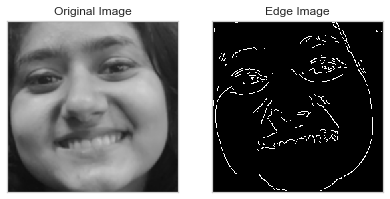


 47%|████▋     | 44/93 [00:06<00:08,  6.08it/s]

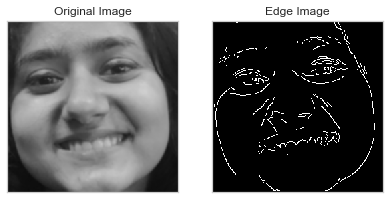


 48%|████▊     | 45/93 [00:06<00:07,  6.19it/s]

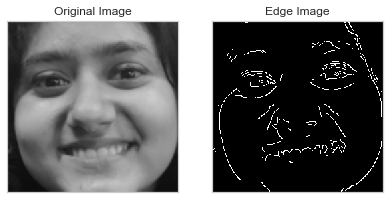


 49%|████▉     | 46/93 [00:07<00:07,  6.20it/s]

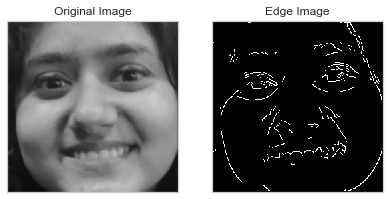


 51%|█████     | 47/93 [00:07<00:07,  6.34it/s]

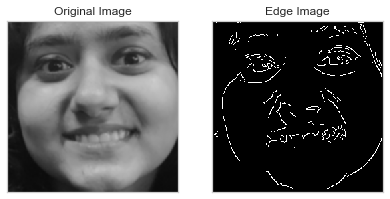


 52%|█████▏    | 48/93 [00:07<00:07,  6.40it/s]

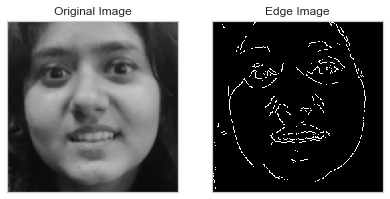


 53%|█████▎    | 49/93 [00:07<00:07,  5.95it/s]

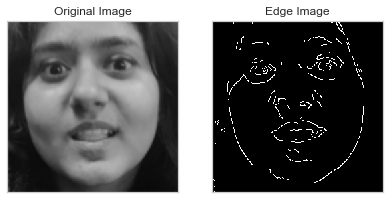


 54%|█████▍    | 50/93 [00:07<00:07,  5.95it/s]

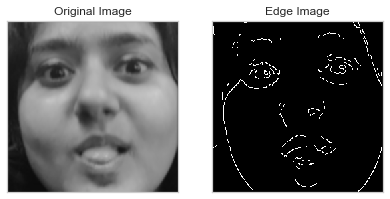


 55%|█████▍    | 51/93 [00:07<00:06,  6.24it/s]

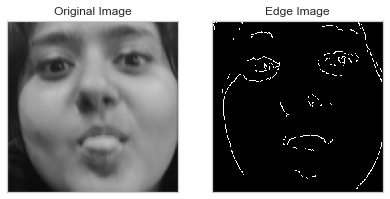


 56%|█████▌    | 52/93 [00:08<00:08,  5.05it/s]

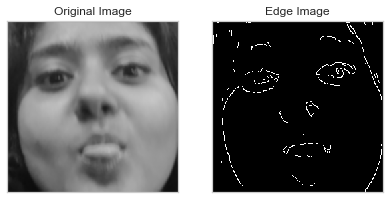


 57%|█████▋    | 53/93 [00:08<00:07,  5.16it/s]

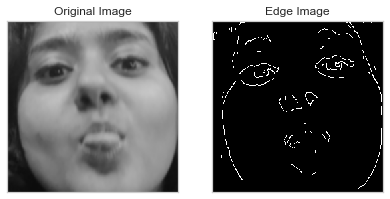


 58%|█████▊    | 54/93 [00:08<00:06,  5.58it/s]

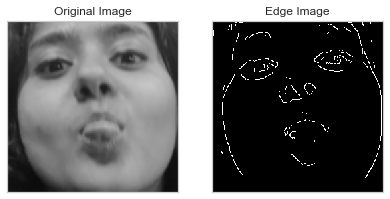


 59%|█████▉    | 55/93 [00:08<00:06,  5.83it/s]

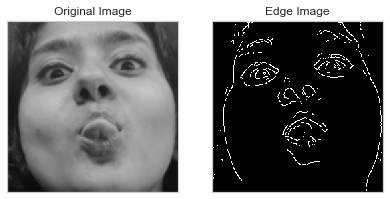


 60%|██████    | 56/93 [00:08<00:06,  6.03it/s]

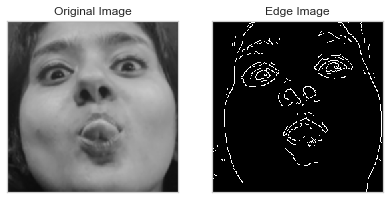


 61%|██████▏   | 57/93 [00:09<00:06,  5.87it/s]

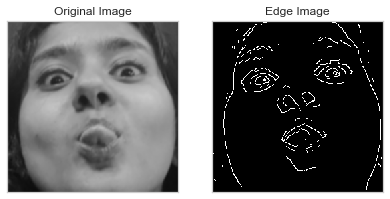


 62%|██████▏   | 58/93 [00:09<00:05,  6.02it/s]

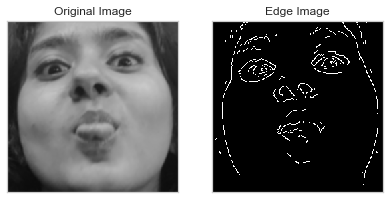


 63%|██████▎   | 59/93 [00:09<00:05,  6.21it/s]

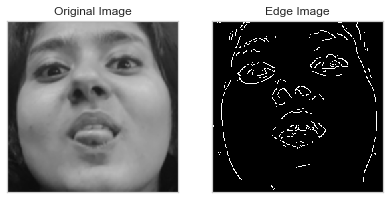


 65%|██████▍   | 60/93 [00:09<00:05,  6.18it/s]

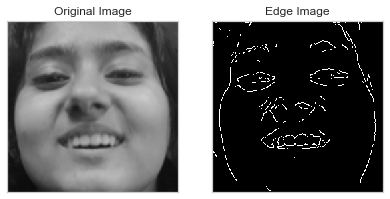


 66%|██████▌   | 61/93 [00:09<00:05,  5.84it/s]

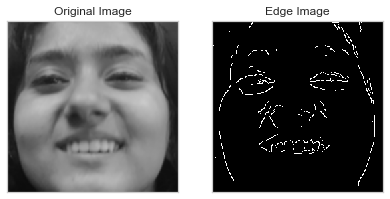


 67%|██████▋   | 62/93 [00:09<00:05,  5.75it/s]

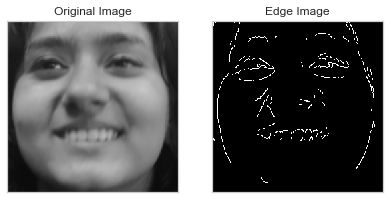


 68%|██████▊   | 63/93 [00:10<00:05,  5.71it/s]

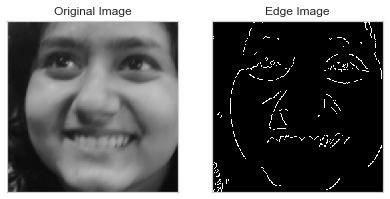


 69%|██████▉   | 64/93 [00:10<00:05,  5.58it/s]

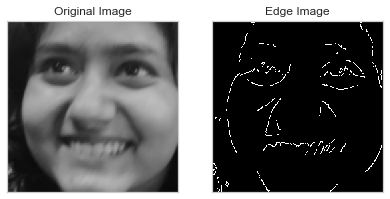


 70%|██████▉   | 65/93 [00:10<00:04,  5.63it/s]

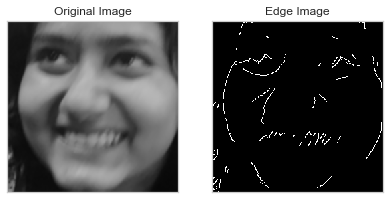


 71%|███████   | 66/93 [00:10<00:04,  5.87it/s]

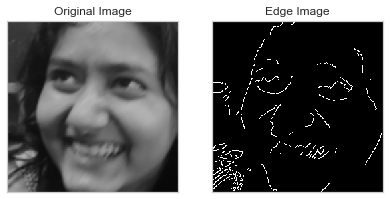


 72%|███████▏  | 67/93 [00:10<00:04,  5.99it/s]

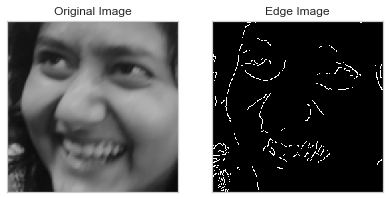


 73%|███████▎  | 68/93 [00:10<00:04,  6.20it/s]

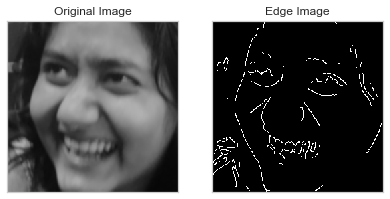


 74%|███████▍  | 69/93 [00:11<00:03,  6.12it/s]

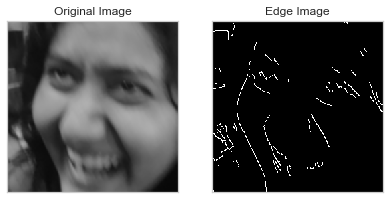


 75%|███████▌  | 70/93 [00:11<00:04,  5.70it/s]

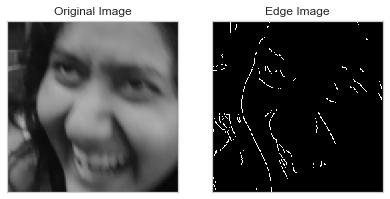


 76%|███████▋  | 71/93 [00:11<00:03,  5.56it/s]

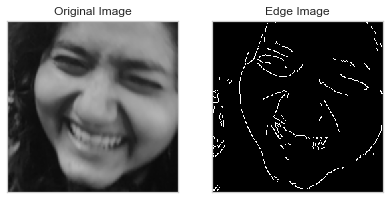


 77%|███████▋  | 72/93 [00:11<00:04,  5.25it/s]

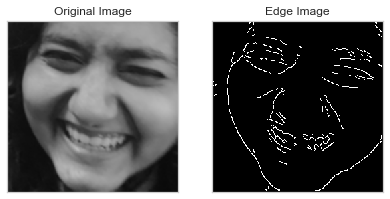


 78%|███████▊  | 73/93 [00:11<00:03,  5.07it/s]

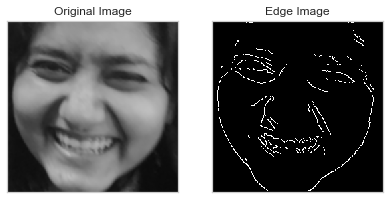


 80%|███████▉  | 74/93 [00:12<00:03,  5.06it/s]

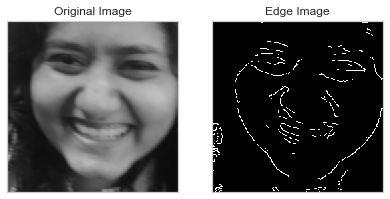


 81%|████████  | 75/93 [00:12<00:03,  5.29it/s]

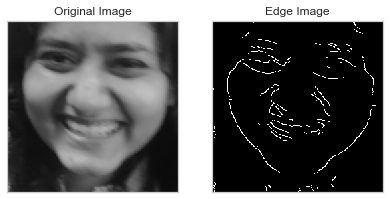


 82%|████████▏ | 76/93 [00:12<00:03,  5.00it/s]

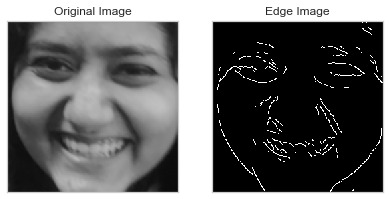


 83%|████████▎ | 77/93 [00:12<00:03,  5.00it/s]

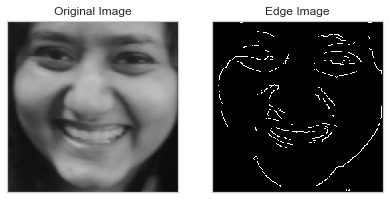


 84%|████████▍ | 78/93 [00:12<00:02,  5.45it/s]

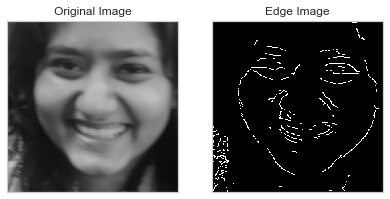


 85%|████████▍ | 79/93 [00:12<00:02,  5.84it/s]

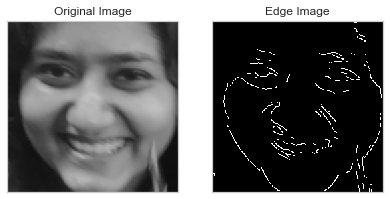


 86%|████████▌ | 80/93 [00:13<00:02,  6.16it/s]

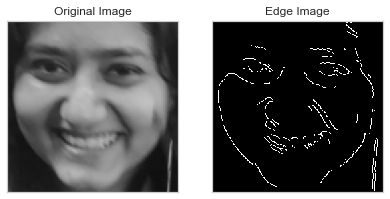


 87%|████████▋ | 81/93 [00:13<00:01,  6.47it/s]

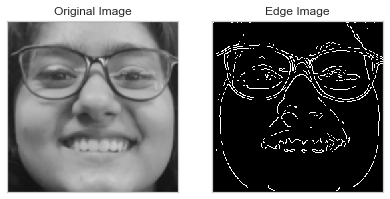


 88%|████████▊ | 82/93 [00:13<00:01,  6.47it/s]

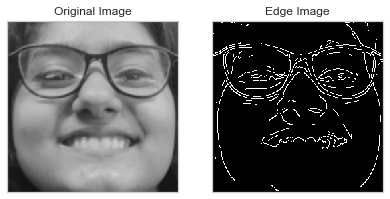


 89%|████████▉ | 83/93 [00:13<00:01,  6.57it/s]

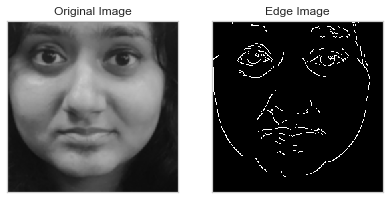


 90%|█████████ | 84/93 [00:13<00:01,  5.29it/s]

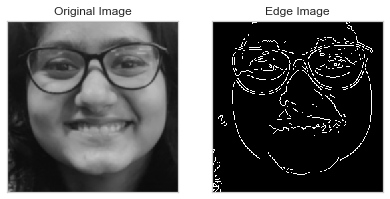


 91%|█████████▏| 85/93 [00:13<00:01,  5.68it/s]

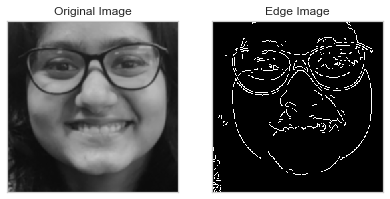


 92%|█████████▏| 86/93 [00:14<00:01,  5.77it/s]

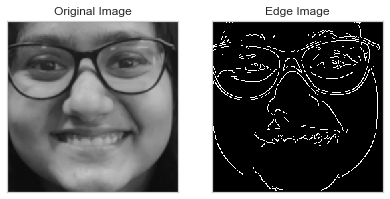


 94%|█████████▎| 87/93 [00:14<00:01,  5.80it/s]

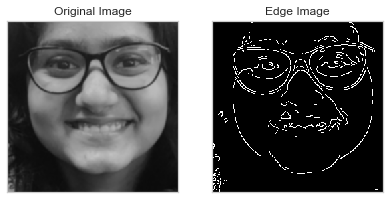


 95%|█████████▍| 88/93 [00:14<00:00,  6.08it/s]

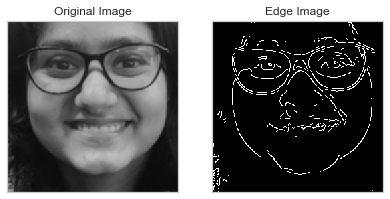


 96%|█████████▌| 89/93 [00:14<00:00,  6.06it/s]

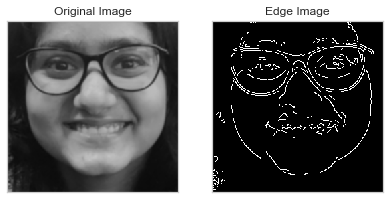


 97%|█████████▋| 90/93 [00:14<00:00,  6.28it/s]

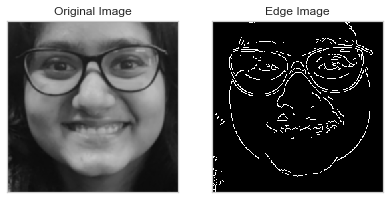


 98%|█████████▊| 91/93 [00:14<00:00,  6.47it/s]

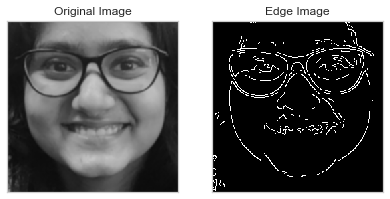


 99%|█████████▉| 92/93 [00:15<00:00,  6.68it/s]

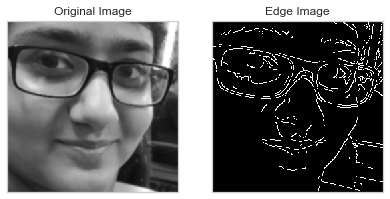


  0%|          | 0/87 [00:00<?, ?it/s]

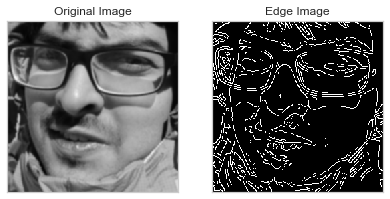


  1%|          | 1/87 [00:00<00:12,  6.68it/s]

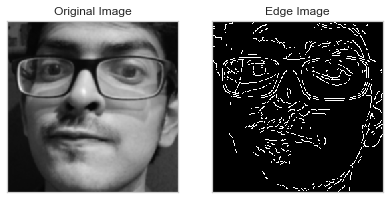


  2%|▏         | 2/87 [00:00<00:13,  6.35it/s]

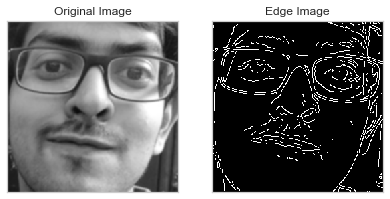


  3%|▎         | 3/87 [00:00<00:14,  5.90it/s]

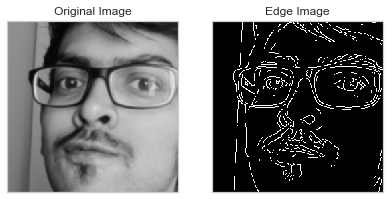


  5%|▍         | 4/87 [00:00<00:13,  6.08it/s]

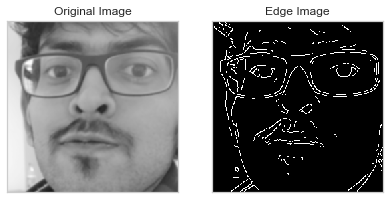


  6%|▌         | 5/87 [00:00<00:13,  6.23it/s]

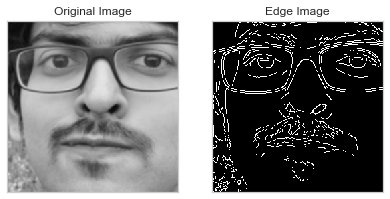


  7%|▋         | 6/87 [00:00<00:12,  6.43it/s]

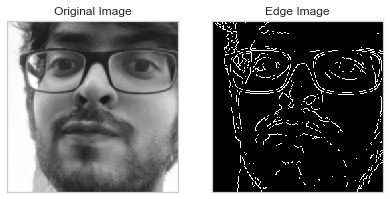


  8%|▊         | 7/87 [00:01<00:12,  6.32it/s]

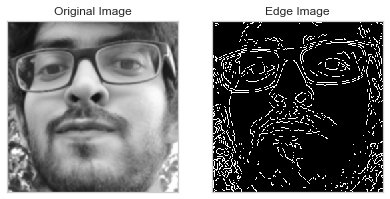


  9%|▉         | 8/87 [00:01<00:12,  6.22it/s]

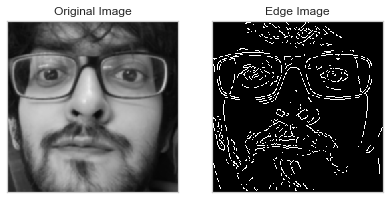


 10%|█         | 9/87 [00:01<00:13,  5.99it/s]

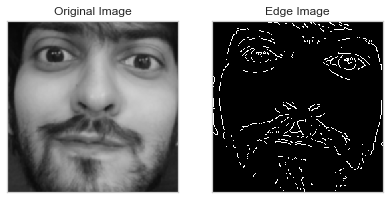


 11%|█▏        | 10/87 [00:01<00:13,  5.86it/s]

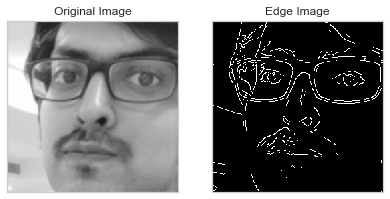


 13%|█▎        | 11/87 [00:01<00:12,  6.14it/s]

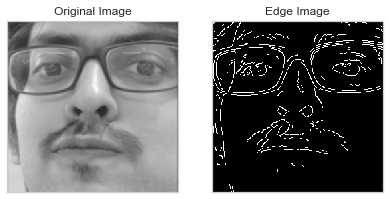


 14%|█▍        | 12/87 [00:01<00:11,  6.26it/s]

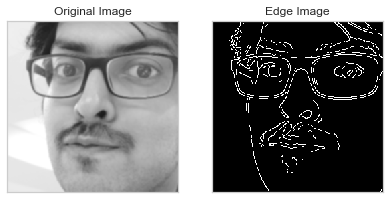


 15%|█▍        | 13/87 [00:02<00:11,  6.45it/s]

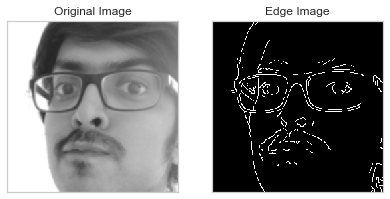


 16%|█▌        | 14/87 [00:02<00:11,  6.41it/s]

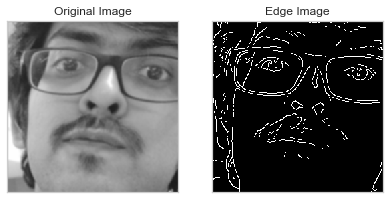


 17%|█▋        | 15/87 [00:02<00:11,  6.45it/s]

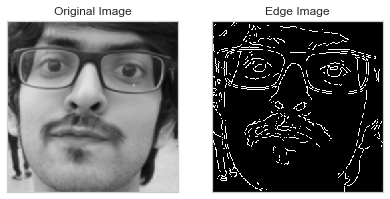


 18%|█▊        | 16/87 [00:02<00:11,  6.44it/s]

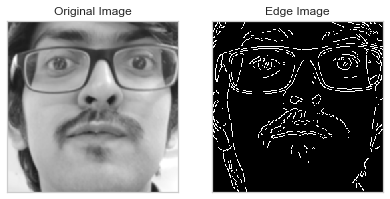


 20%|█▉        | 17/87 [00:02<00:11,  6.34it/s]

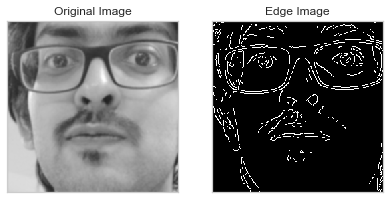


 21%|██        | 18/87 [00:02<00:10,  6.42it/s]

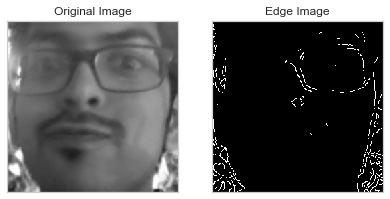


 22%|██▏       | 19/87 [00:03<00:10,  6.36it/s]

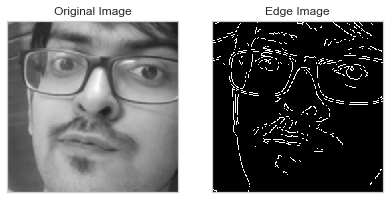


 23%|██▎       | 20/87 [00:03<00:10,  6.40it/s]

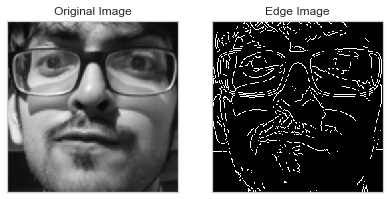


 24%|██▍       | 21/87 [00:03<00:10,  6.49it/s]

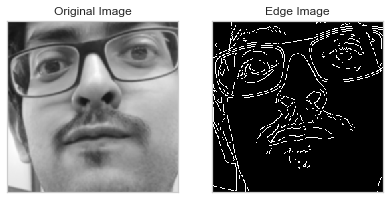


 25%|██▌       | 22/87 [00:03<00:10,  6.46it/s]

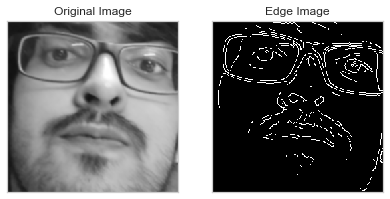


 26%|██▋       | 23/87 [00:03<00:12,  5.23it/s]

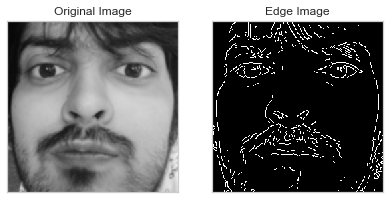


 28%|██▊       | 24/87 [00:03<00:11,  5.35it/s]

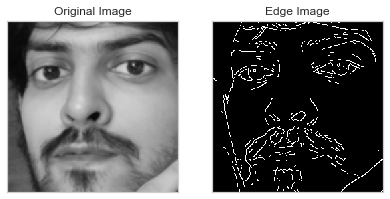


 29%|██▊       | 25/87 [00:04<00:10,  5.71it/s]

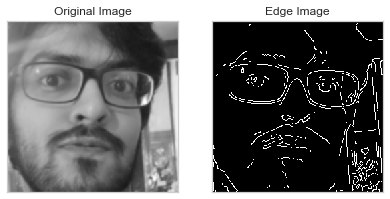


 30%|██▉       | 26/87 [00:04<00:10,  5.85it/s]

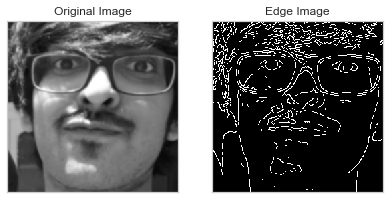


 31%|███       | 27/87 [00:04<00:09,  6.03it/s]

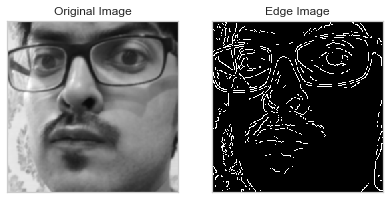


 32%|███▏      | 28/87 [00:04<00:09,  6.11it/s]

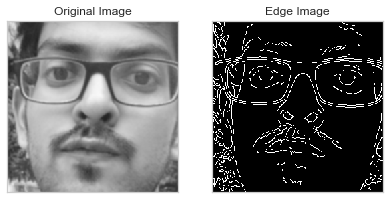


 33%|███▎      | 29/87 [00:04<00:09,  6.05it/s]

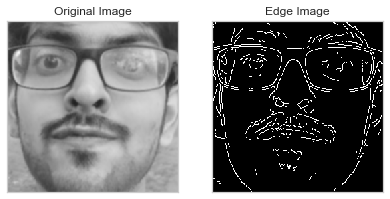


 34%|███▍      | 30/87 [00:04<00:10,  5.67it/s]

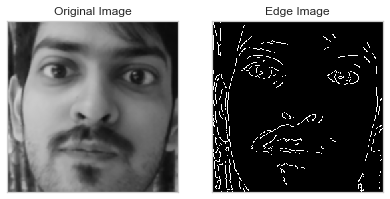


 36%|███▌      | 31/87 [00:05<00:09,  5.86it/s]

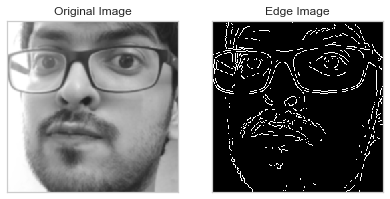


 37%|███▋      | 32/87 [00:05<00:09,  5.98it/s]

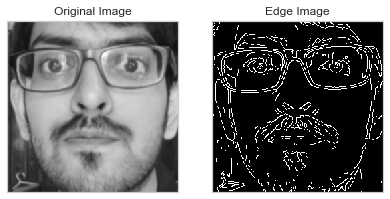


 38%|███▊      | 33/87 [00:05<00:12,  4.21it/s]

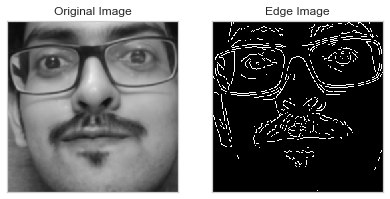


 39%|███▉      | 34/87 [00:05<00:11,  4.55it/s]

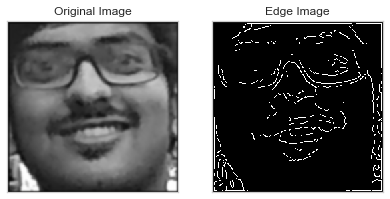


 40%|████      | 35/87 [00:05<00:09,  5.22it/s]

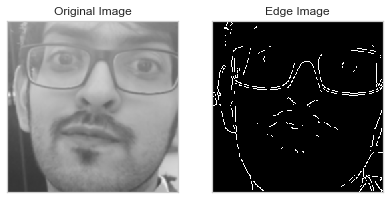


 41%|████▏     | 36/87 [00:06<00:09,  5.66it/s]

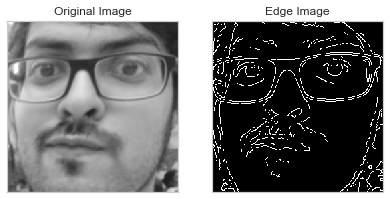


 43%|████▎     | 37/87 [00:06<00:08,  5.62it/s]

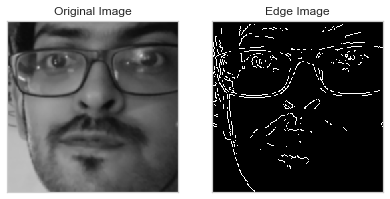


 44%|████▎     | 38/87 [00:06<00:08,  5.84it/s]

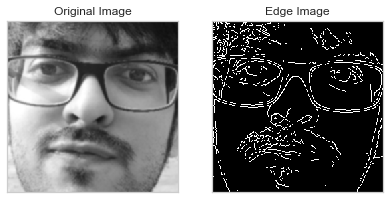


 45%|████▍     | 39/87 [00:06<00:08,  5.96it/s]

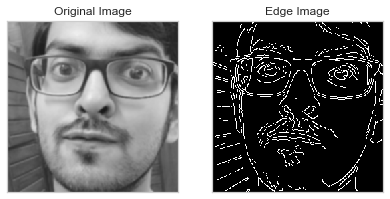


 46%|████▌     | 40/87 [00:06<00:07,  5.91it/s]

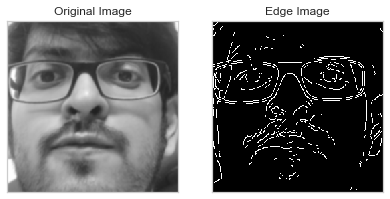


 47%|████▋     | 41/87 [00:06<00:07,  6.11it/s]

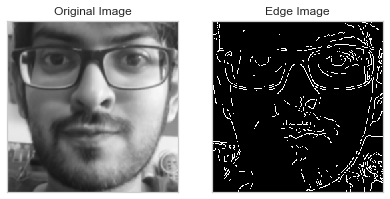


 48%|████▊     | 42/87 [00:07<00:07,  5.64it/s]

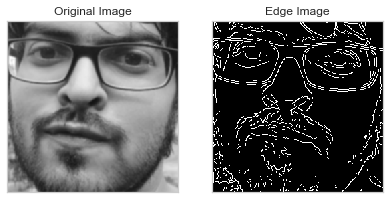


 49%|████▉     | 43/87 [00:07<00:07,  5.81it/s]

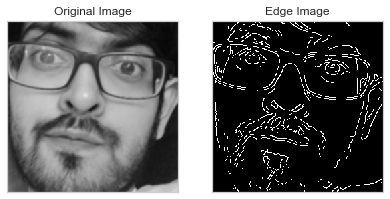


 51%|█████     | 44/87 [00:07<00:07,  5.62it/s]

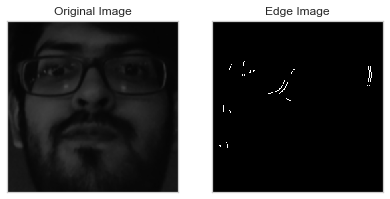


 52%|█████▏    | 45/87 [00:07<00:07,  5.97it/s]

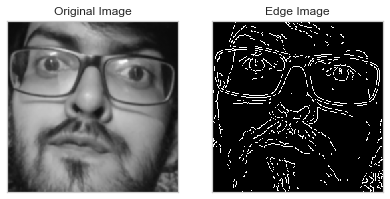


 53%|█████▎    | 46/87 [00:07<00:06,  6.16it/s]

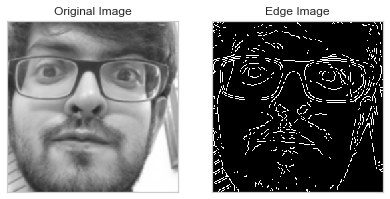


 54%|█████▍    | 47/87 [00:07<00:06,  6.13it/s]

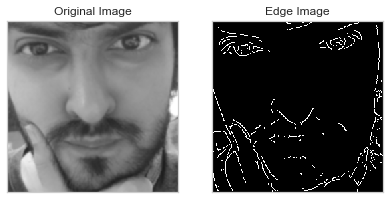


 55%|█████▌    | 48/87 [00:08<00:06,  6.13it/s]

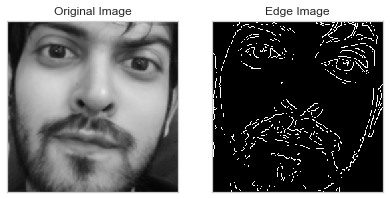


 56%|█████▋    | 49/87 [00:08<00:06,  5.93it/s]

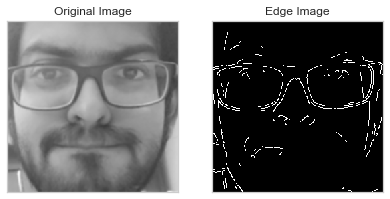


 57%|█████▋    | 50/87 [00:08<00:06,  6.13it/s]

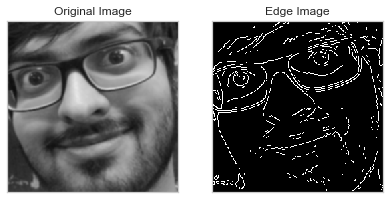


 59%|█████▊    | 51/87 [00:08<00:05,  6.29it/s]

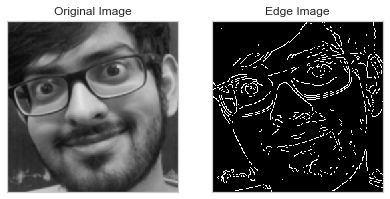


 60%|█████▉    | 52/87 [00:08<00:05,  5.97it/s]

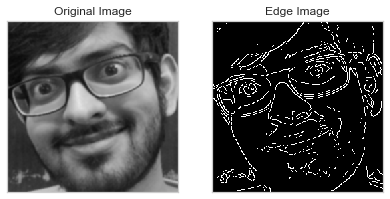


 61%|██████    | 53/87 [00:08<00:05,  6.16it/s]

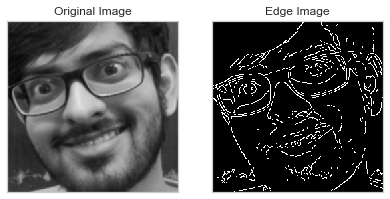


 62%|██████▏   | 54/87 [00:09<00:05,  6.20it/s]

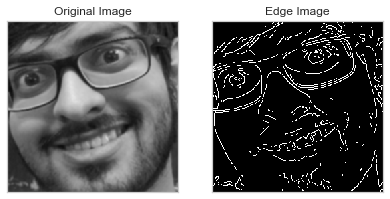


 63%|██████▎   | 55/87 [00:09<00:06,  5.08it/s]

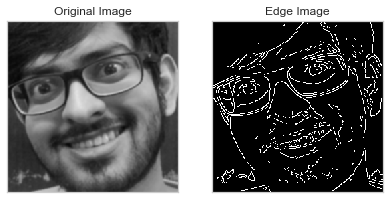


 64%|██████▍   | 56/87 [00:09<00:05,  5.39it/s]

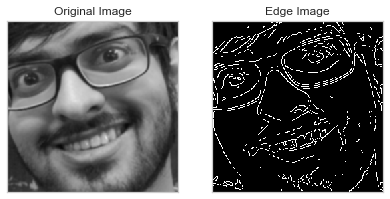


 66%|██████▌   | 57/87 [00:09<00:05,  5.75it/s]

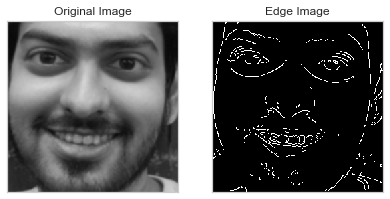


 67%|██████▋   | 58/87 [00:09<00:04,  6.09it/s]

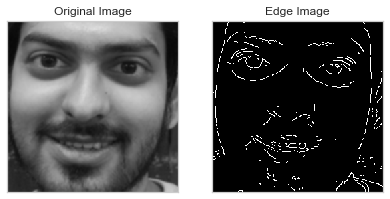


 68%|██████▊   | 59/87 [00:09<00:04,  6.25it/s]

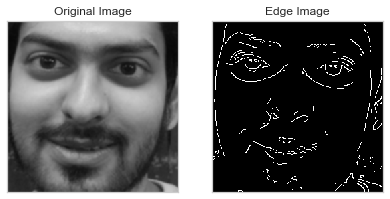


 69%|██████▉   | 60/87 [00:10<00:04,  6.29it/s]

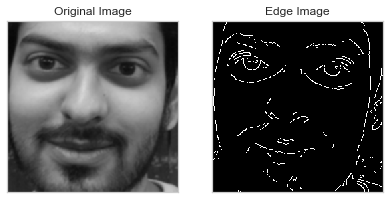


 70%|███████   | 61/87 [00:10<00:04,  6.48it/s]

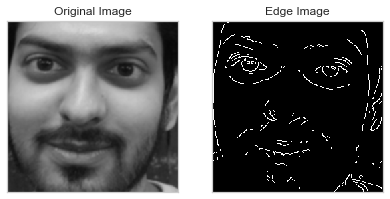


 71%|███████▏  | 62/87 [00:10<00:03,  6.62it/s]

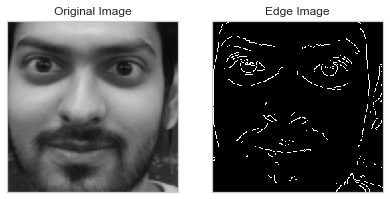


 72%|███████▏  | 63/87 [00:10<00:03,  6.69it/s]

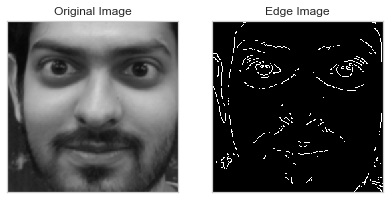


 74%|███████▎  | 64/87 [00:10<00:03,  6.74it/s]

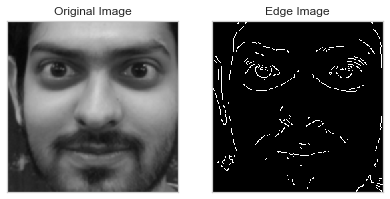


 75%|███████▍  | 65/87 [00:10<00:03,  6.40it/s]

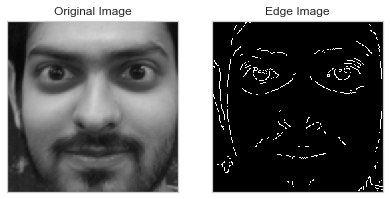


 76%|███████▌  | 66/87 [00:11<00:03,  6.37it/s]

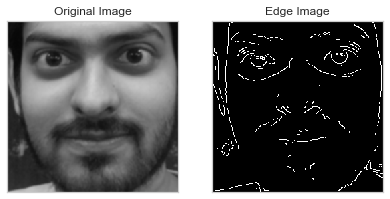


 77%|███████▋  | 67/87 [00:11<00:03,  6.46it/s]

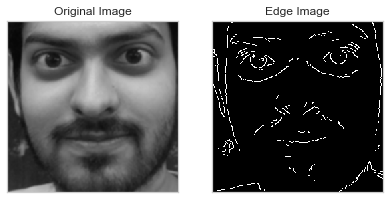


 78%|███████▊  | 68/87 [00:11<00:02,  6.61it/s]

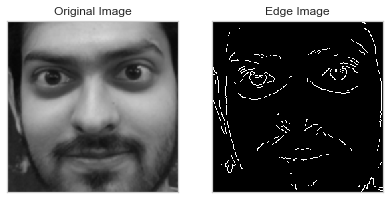


 79%|███████▉  | 69/87 [00:11<00:02,  6.62it/s]

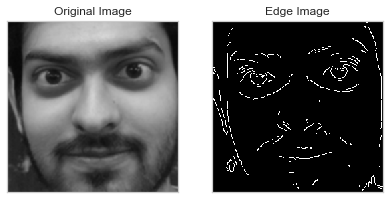


 80%|████████  | 70/87 [00:11<00:02,  6.73it/s]

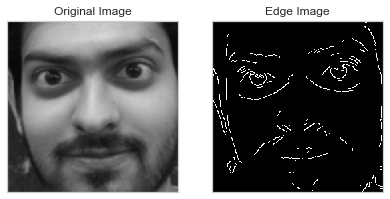


 82%|████████▏ | 71/87 [00:11<00:02,  6.21it/s]

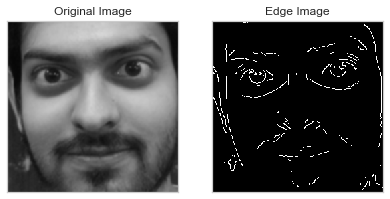


 83%|████████▎ | 72/87 [00:12<00:02,  5.84it/s]

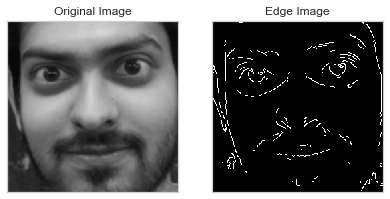


 84%|████████▍ | 73/87 [00:12<00:02,  5.88it/s]

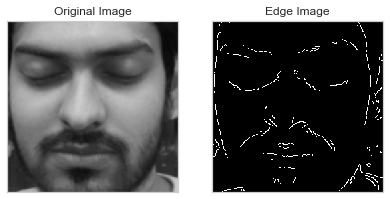


 85%|████████▌ | 74/87 [00:12<00:02,  5.85it/s]

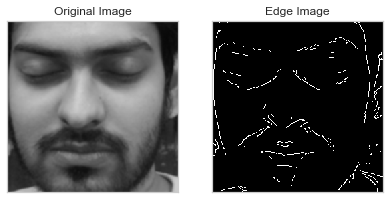


 86%|████████▌ | 75/87 [00:12<00:02,  5.51it/s]

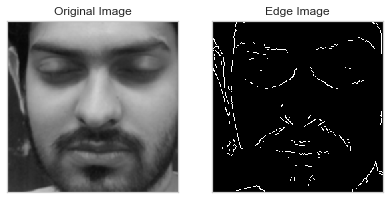


 87%|████████▋ | 76/87 [00:12<00:02,  5.22it/s]

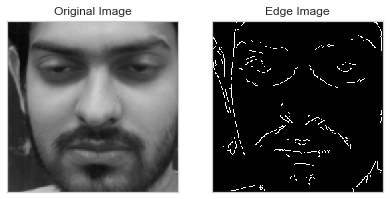


 89%|████████▊ | 77/87 [00:12<00:01,  5.28it/s]

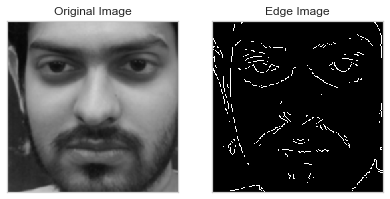


 90%|████████▉ | 78/87 [00:13<00:01,  5.33it/s]

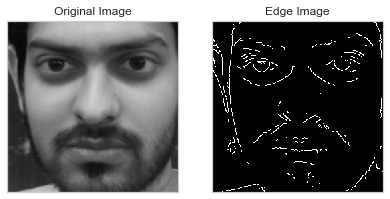


 91%|█████████ | 79/87 [00:13<00:01,  5.56it/s]

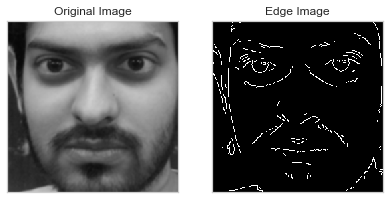


 92%|█████████▏| 80/87 [00:13<00:01,  5.74it/s]

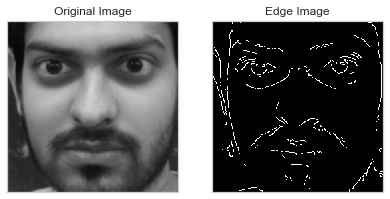


 93%|█████████▎| 81/87 [00:13<00:00,  6.01it/s]

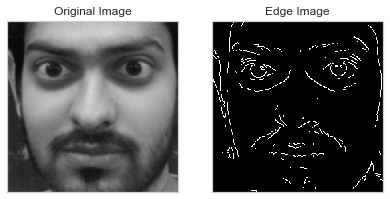


 94%|█████████▍| 82/87 [00:13<00:00,  6.28it/s]

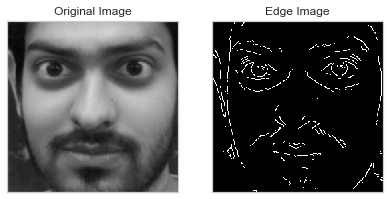


 95%|█████████▌| 83/87 [00:13<00:00,  6.37it/s]

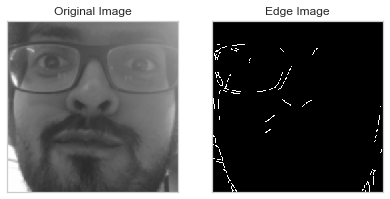


 97%|█████████▋| 84/87 [00:14<00:00,  6.10it/s]

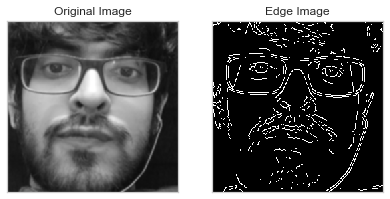


 98%|█████████▊| 85/87 [00:14<00:00,  5.80it/s]

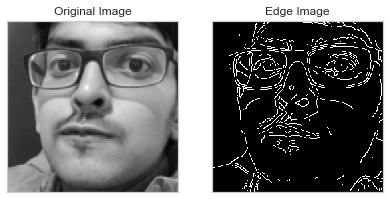


 99%|█████████▉| 86/87 [00:14<00:00,  5.90it/s]

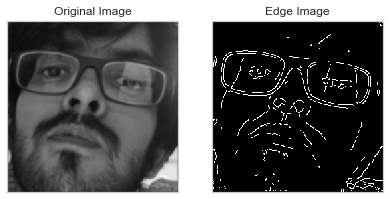


  0%|          | 0/97 [00:00<?, ?it/s]

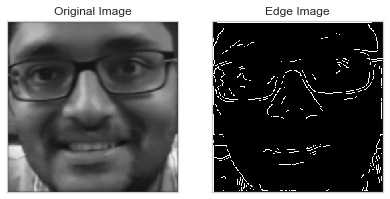


  1%|          | 1/97 [00:00<00:15,  6.04it/s]

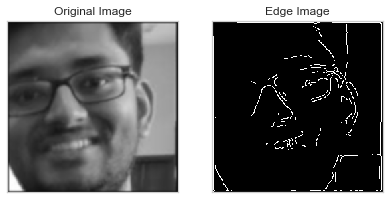


  2%|▏         | 2/97 [00:00<00:14,  6.44it/s]

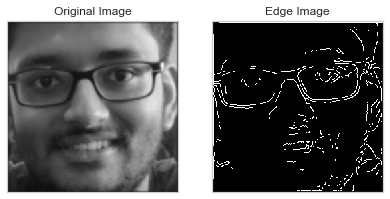


  3%|▎         | 3/97 [00:00<00:13,  6.76it/s]

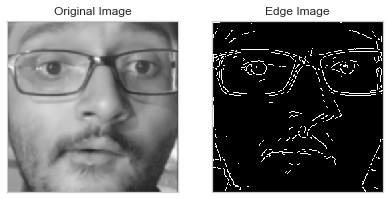


  4%|▍         | 4/97 [00:00<00:13,  6.85it/s]

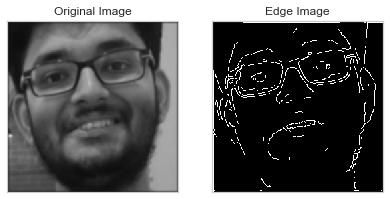


  5%|▌         | 5/97 [00:00<00:13,  6.85it/s]

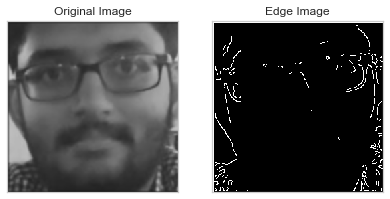


  6%|▌         | 6/97 [00:00<00:12,  7.03it/s]

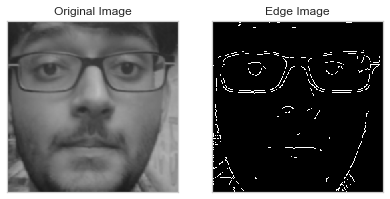


  7%|▋         | 7/97 [00:00<00:12,  7.14it/s]

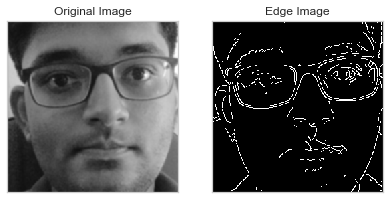


  8%|▊         | 8/97 [00:01<00:12,  6.90it/s]

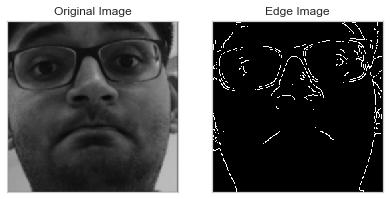


  9%|▉         | 9/97 [00:01<00:12,  6.83it/s]

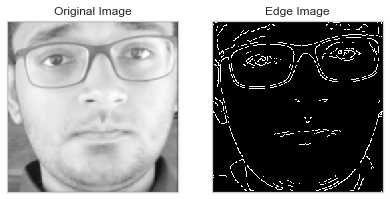


 10%|█         | 10/97 [00:01<00:12,  7.06it/s]

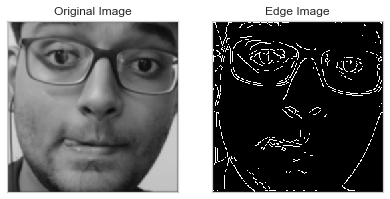


 11%|█▏        | 11/97 [00:01<00:11,  7.20it/s]

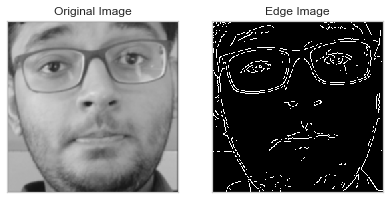


 12%|█▏        | 12/97 [00:01<00:11,  7.20it/s]

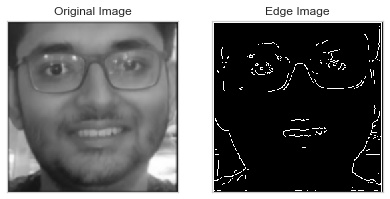


 13%|█▎        | 13/97 [00:01<00:11,  7.36it/s]

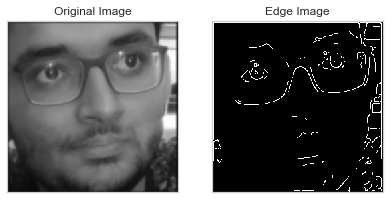


 14%|█▍        | 14/97 [00:01<00:11,  7.48it/s]

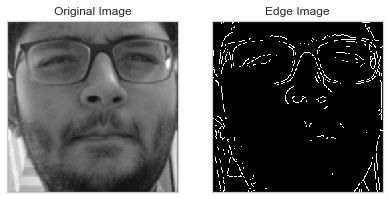


 15%|█▌        | 15/97 [00:02<00:11,  7.18it/s]

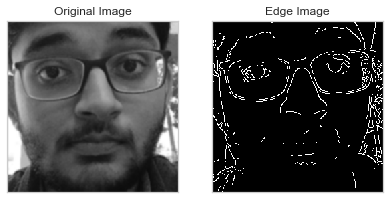


 16%|█▋        | 16/97 [00:02<00:11,  6.78it/s]

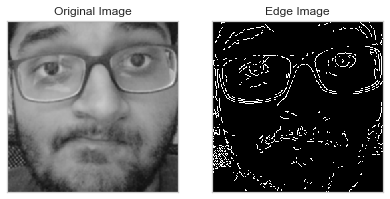


 18%|█▊        | 17/97 [00:02<00:11,  6.78it/s]

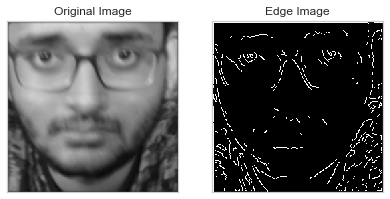


 19%|█▊        | 18/97 [00:02<00:11,  7.06it/s]

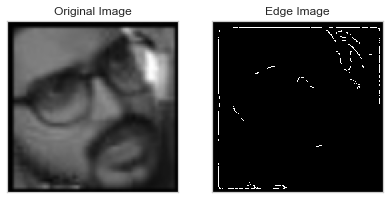


 20%|█▉        | 19/97 [00:02<00:11,  6.78it/s]

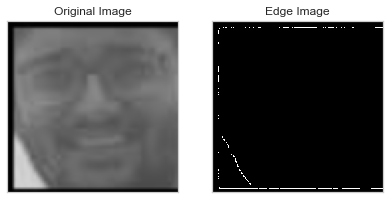


 21%|██        | 20/97 [00:02<00:10,  7.02it/s]

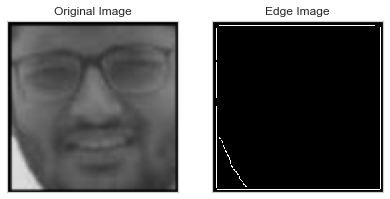


 22%|██▏       | 21/97 [00:02<00:10,  7.22it/s]

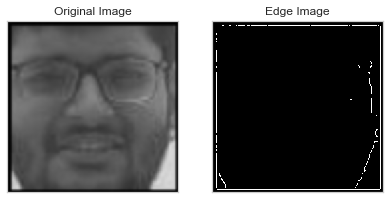


 23%|██▎       | 22/97 [00:03<00:10,  7.36it/s]

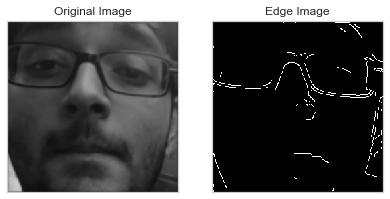


 24%|██▎       | 23/97 [00:03<00:10,  7.30it/s]

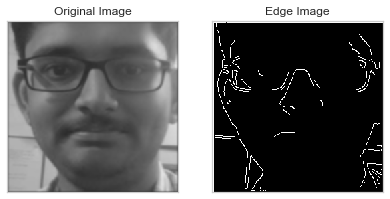


 25%|██▍       | 24/97 [00:03<00:09,  7.42it/s]

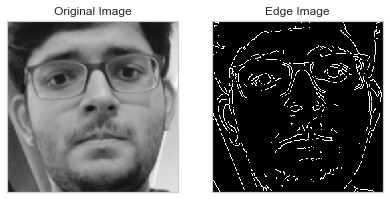


 26%|██▌       | 25/97 [00:03<00:09,  7.24it/s]

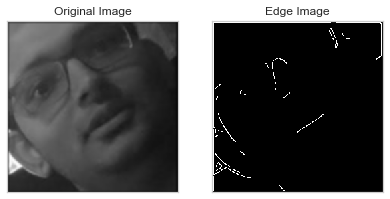


 27%|██▋       | 26/97 [00:03<00:09,  7.39it/s]

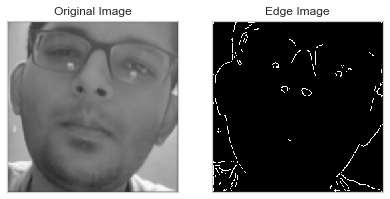


 28%|██▊       | 27/97 [00:03<00:10,  6.93it/s]

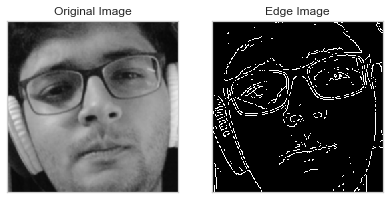


 29%|██▉       | 28/97 [00:03<00:09,  6.95it/s]

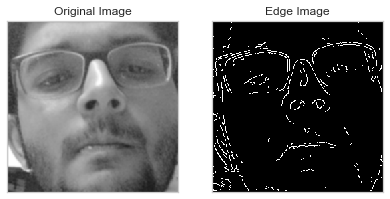


 30%|██▉       | 29/97 [00:04<00:09,  7.06it/s]

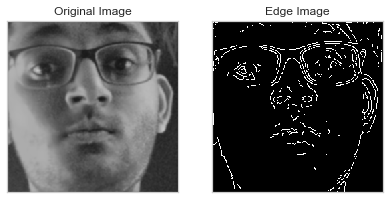


 31%|███       | 30/97 [00:04<00:09,  7.14it/s]

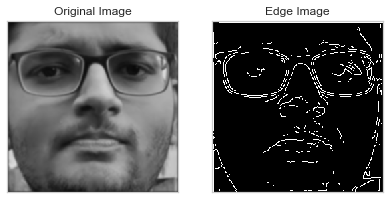


 32%|███▏      | 31/97 [00:04<00:09,  7.28it/s]

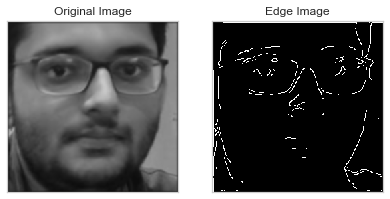


 33%|███▎      | 32/97 [00:04<00:11,  5.66it/s]

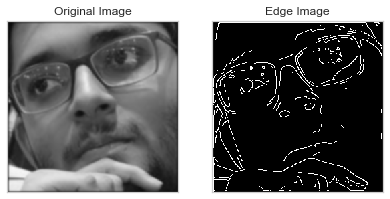


 34%|███▍      | 33/97 [00:04<00:10,  6.12it/s]

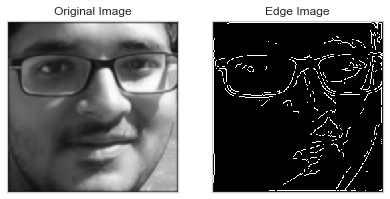


 35%|███▌      | 34/97 [00:04<00:10,  6.22it/s]

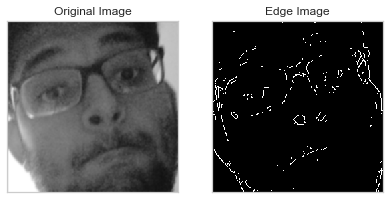


 36%|███▌      | 35/97 [00:05<00:09,  6.40it/s]

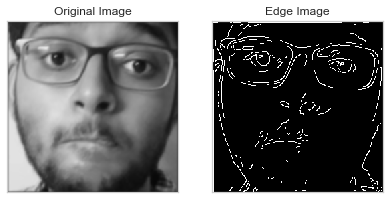


 37%|███▋      | 36/97 [00:05<00:09,  6.77it/s]

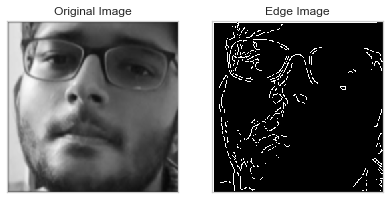


 38%|███▊      | 37/97 [00:05<00:09,  6.64it/s]

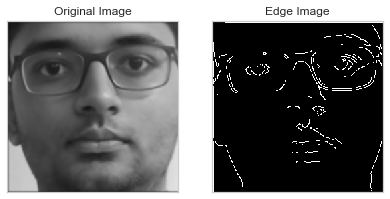


 39%|███▉      | 38/97 [00:05<00:08,  6.90it/s]

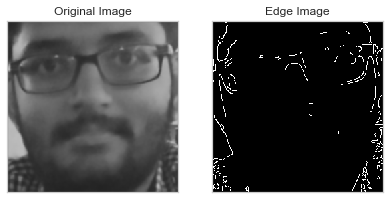


 40%|████      | 39/97 [00:05<00:08,  6.79it/s]

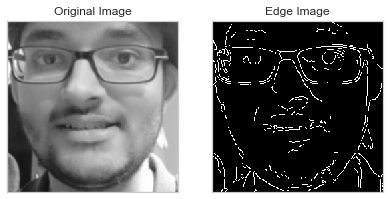


 41%|████      | 40/97 [00:05<00:08,  6.55it/s]

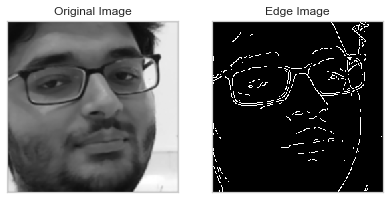


 42%|████▏     | 41/97 [00:05<00:08,  6.42it/s]

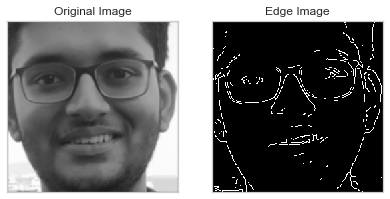


 43%|████▎     | 42/97 [00:06<00:08,  6.74it/s]

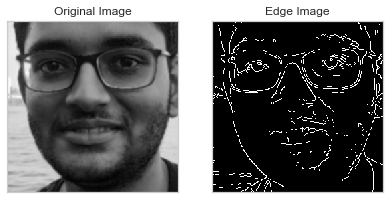


 44%|████▍     | 43/97 [00:06<00:07,  6.79it/s]

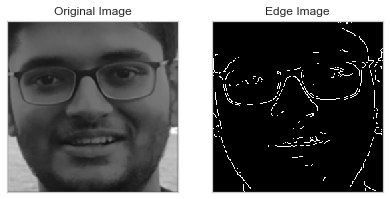


 45%|████▌     | 44/97 [00:06<00:07,  7.07it/s]

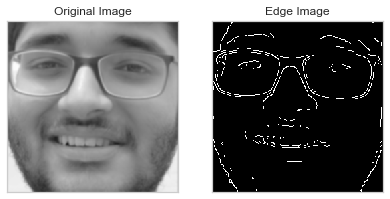


 46%|████▋     | 45/97 [00:06<00:07,  6.89it/s]

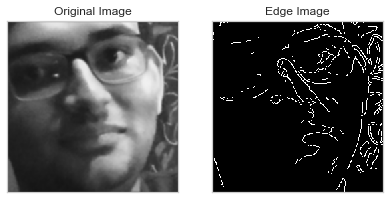


 47%|████▋     | 46/97 [00:06<00:07,  7.12it/s]

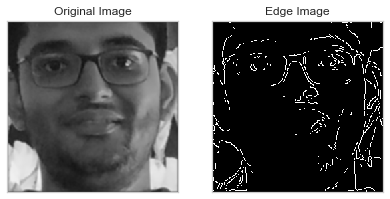


 48%|████▊     | 47/97 [00:06<00:07,  7.07it/s]

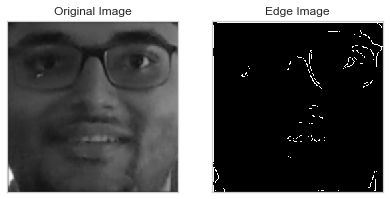


 49%|████▉     | 48/97 [00:06<00:06,  7.25it/s]

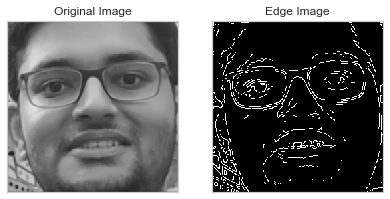


 51%|█████     | 49/97 [00:07<00:06,  7.26it/s]

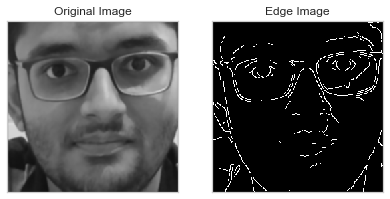


 52%|█████▏    | 50/97 [00:07<00:06,  7.15it/s]

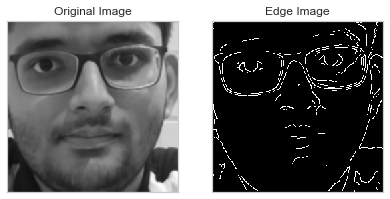


 53%|█████▎    | 51/97 [00:07<00:06,  7.00it/s]

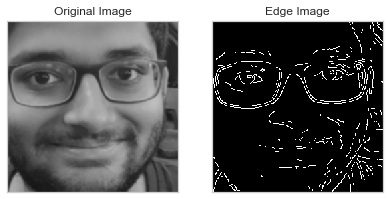


 54%|█████▎    | 52/97 [00:07<00:06,  6.86it/s]

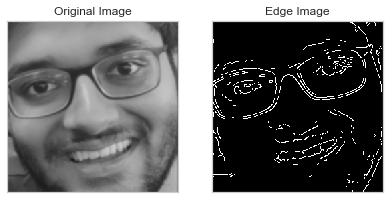


 55%|█████▍    | 53/97 [00:07<00:06,  6.49it/s]

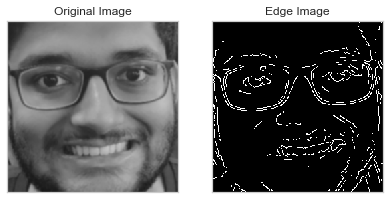


 56%|█████▌    | 54/97 [00:07<00:06,  6.60it/s]

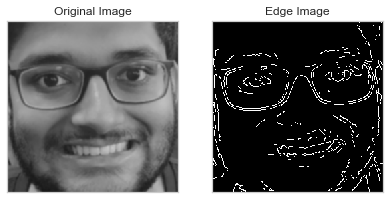


 57%|█████▋    | 55/97 [00:07<00:06,  6.70it/s]

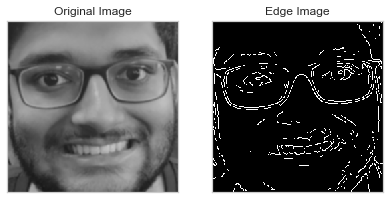


 58%|█████▊    | 56/97 [00:08<00:06,  6.75it/s]

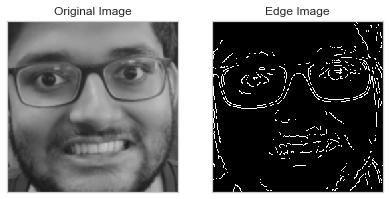


 59%|█████▉    | 57/97 [00:08<00:06,  6.49it/s]

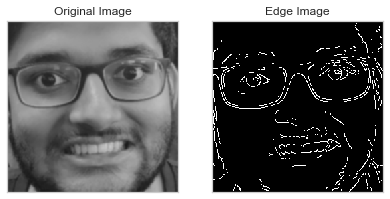


 60%|█████▉    | 58/97 [00:08<00:05,  6.51it/s]

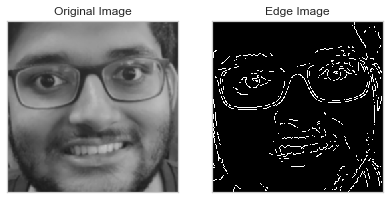


 61%|██████    | 59/97 [00:08<00:05,  6.51it/s]

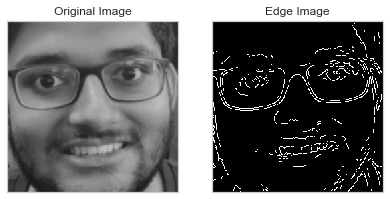


 62%|██████▏   | 60/97 [00:08<00:06,  5.91it/s]

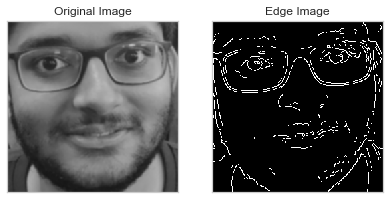


 63%|██████▎   | 61/97 [00:08<00:05,  6.03it/s]

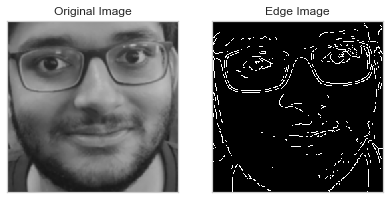


 64%|██████▍   | 62/97 [00:09<00:06,  5.56it/s]

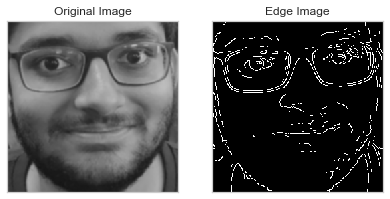


 65%|██████▍   | 63/97 [00:09<00:05,  5.69it/s]

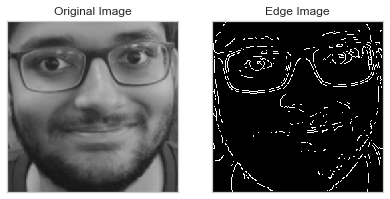


 66%|██████▌   | 64/97 [00:09<00:07,  4.55it/s]

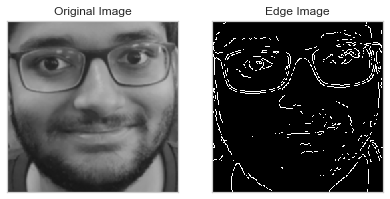


 67%|██████▋   | 65/97 [00:09<00:06,  5.01it/s]

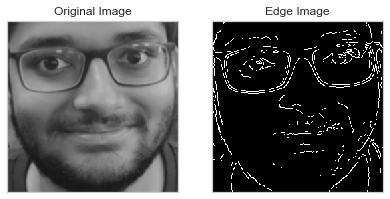


 68%|██████▊   | 66/97 [00:09<00:05,  5.45it/s]

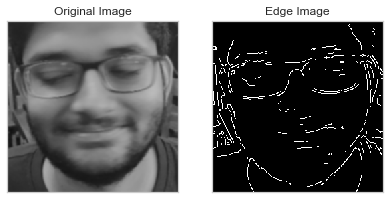


 69%|██████▉   | 67/97 [00:10<00:05,  5.80it/s]

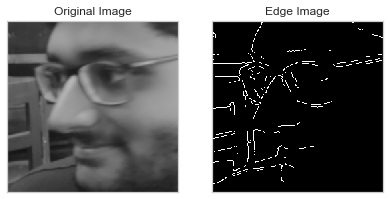


 70%|███████   | 68/97 [00:10<00:04,  5.82it/s]

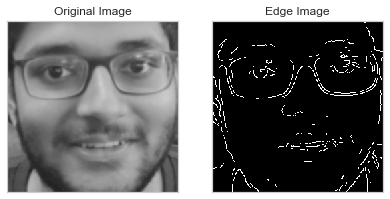


 71%|███████   | 69/97 [00:10<00:04,  5.98it/s]

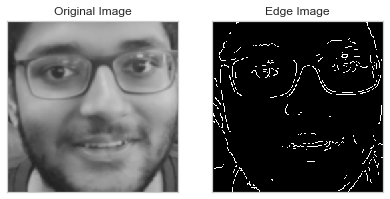


 72%|███████▏  | 70/97 [00:10<00:04,  6.23it/s]

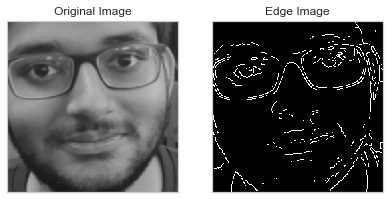


 73%|███████▎  | 71/97 [00:10<00:04,  6.43it/s]

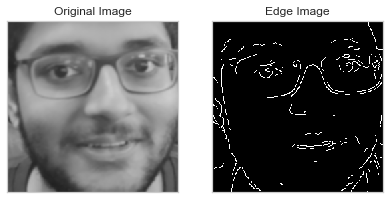


 74%|███████▍  | 72/97 [00:10<00:03,  6.49it/s]

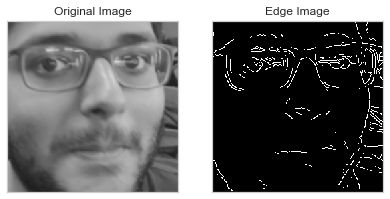


 75%|███████▌  | 73/97 [00:10<00:03,  6.64it/s]

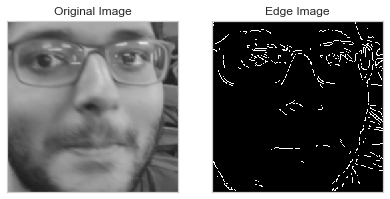


 76%|███████▋  | 74/97 [00:11<00:03,  6.73it/s]

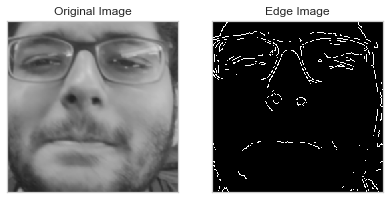


 77%|███████▋  | 75/97 [00:11<00:03,  6.60it/s]

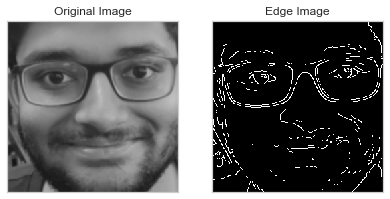


 78%|███████▊  | 76/97 [00:11<00:03,  6.59it/s]

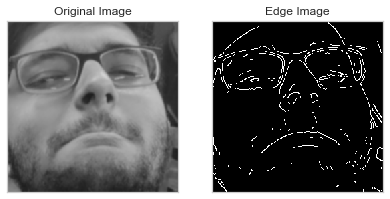


 79%|███████▉  | 77/97 [00:11<00:03,  6.63it/s]

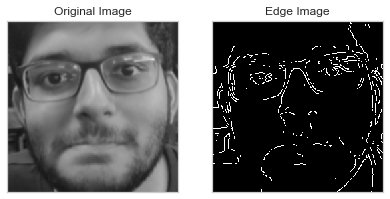


 80%|████████  | 78/97 [00:11<00:02,  6.65it/s]

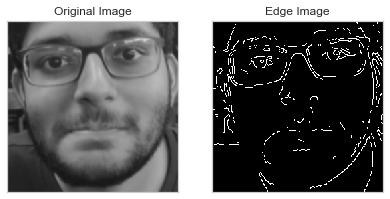


 81%|████████▏ | 79/97 [00:11<00:02,  6.68it/s]

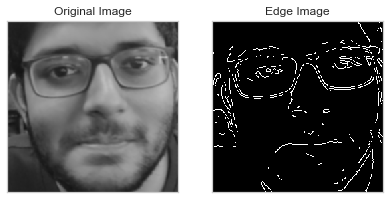


 82%|████████▏ | 80/97 [00:12<00:02,  6.70it/s]

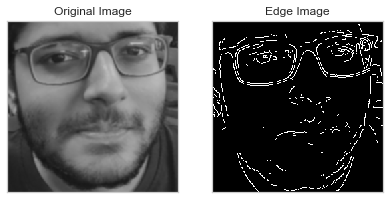


 84%|████████▎ | 81/97 [00:12<00:02,  6.61it/s]

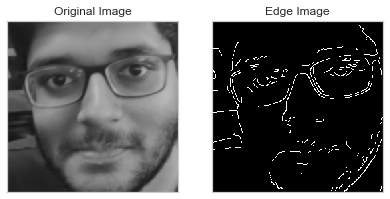


 85%|████████▍ | 82/97 [00:12<00:02,  6.58it/s]

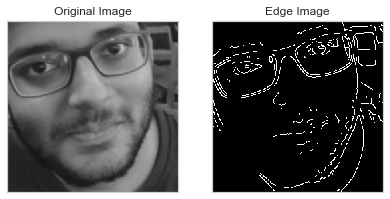


 86%|████████▌ | 83/97 [00:12<00:02,  6.45it/s]

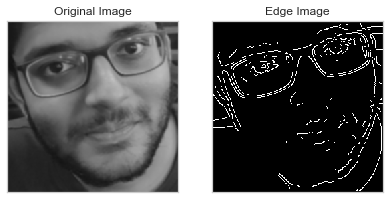


 87%|████████▋ | 84/97 [00:12<00:01,  6.52it/s]

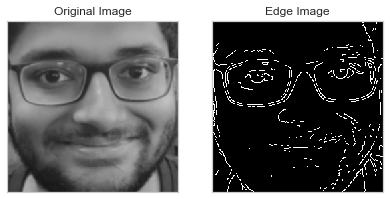


 88%|████████▊ | 85/97 [00:12<00:01,  6.62it/s]

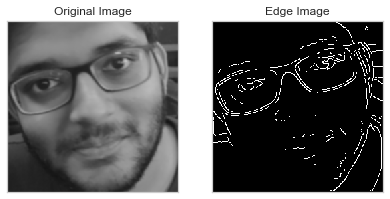


 89%|████████▊ | 86/97 [00:12<00:01,  6.48it/s]

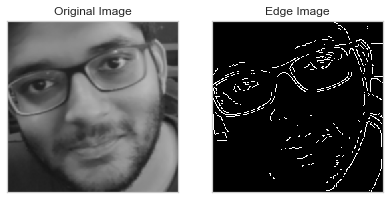


 90%|████████▉ | 87/97 [00:13<00:01,  6.45it/s]

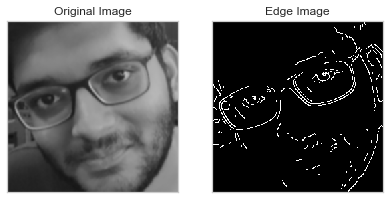


 91%|█████████ | 88/97 [00:13<00:01,  6.10it/s]

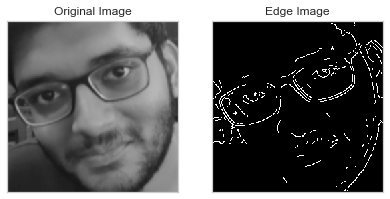


 92%|█████████▏| 89/97 [00:13<00:01,  5.56it/s]

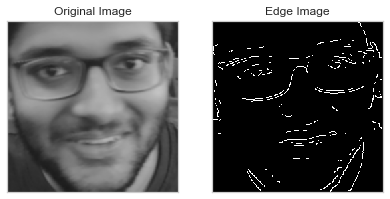


 93%|█████████▎| 90/97 [00:13<00:01,  5.66it/s]

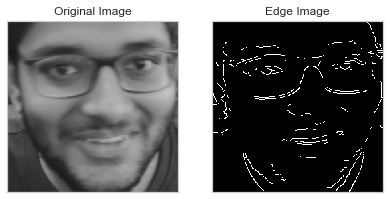


 94%|█████████▍| 91/97 [00:13<00:01,  5.62it/s]

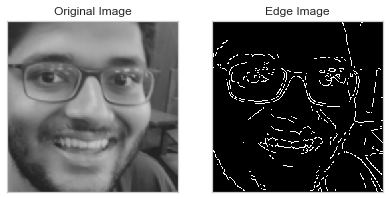


 95%|█████████▍| 92/97 [00:14<00:00,  5.83it/s]

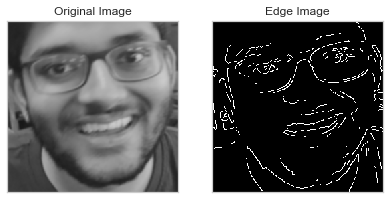


 96%|█████████▌| 93/97 [00:14<00:00,  5.28it/s]

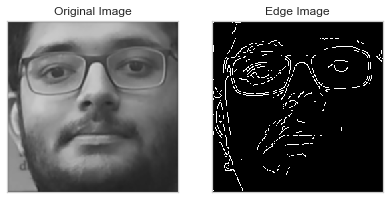


 97%|█████████▋| 94/97 [00:14<00:00,  5.75it/s]

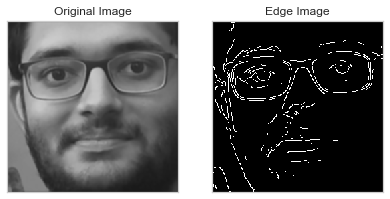


 98%|█████████▊| 95/97 [00:14<00:00,  5.75it/s]

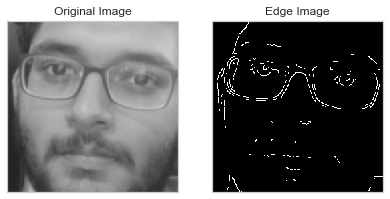


 99%|█████████▉| 96/97 [00:14<00:00,  4.88it/s]

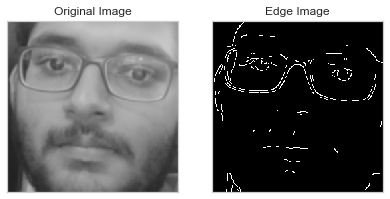


  0%|          | 0/90 [00:00<?, ?it/s]

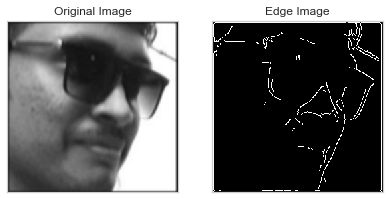


  1%|          | 1/90 [00:00<00:10,  8.50it/s]

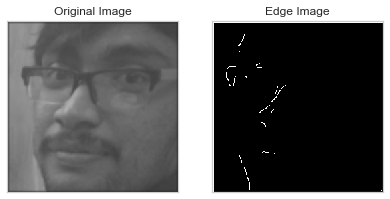


  2%|▏         | 2/90 [00:00<00:10,  8.35it/s]

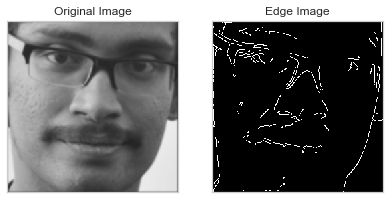


  3%|▎         | 3/90 [00:00<00:10,  7.99it/s]

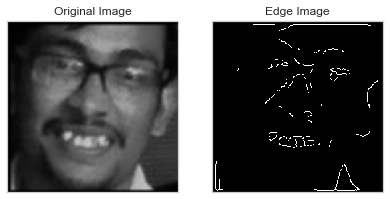


  4%|▍         | 4/90 [00:00<00:10,  7.89it/s]

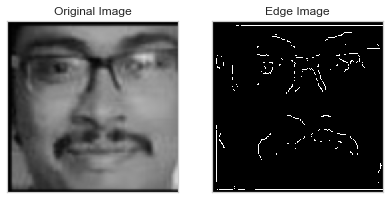


  6%|▌         | 5/90 [00:00<00:10,  7.96it/s]

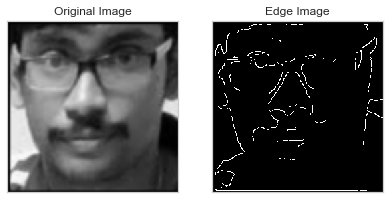


  7%|▋         | 6/90 [00:00<00:10,  7.81it/s]

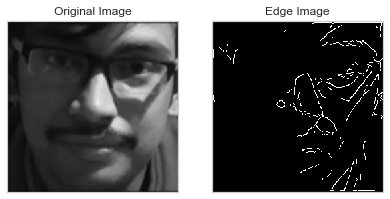


  8%|▊         | 7/90 [00:00<00:11,  7.50it/s]

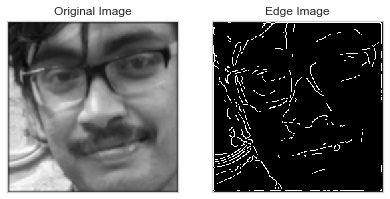


  9%|▉         | 8/90 [00:01<00:10,  7.50it/s]

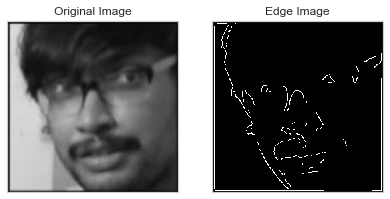


 10%|█         | 9/90 [00:01<00:11,  6.83it/s]

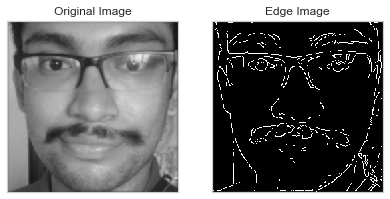


 11%|█         | 10/90 [00:01<00:11,  7.03it/s]

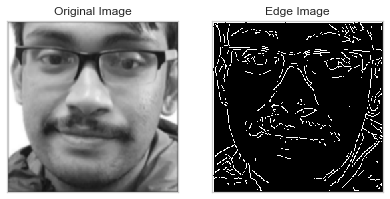


 12%|█▏        | 11/90 [00:01<00:11,  6.66it/s]

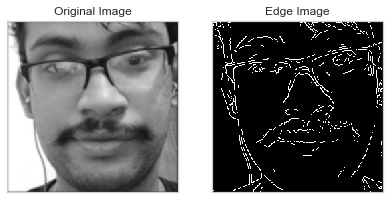


 13%|█▎        | 12/90 [00:01<00:11,  6.84it/s]

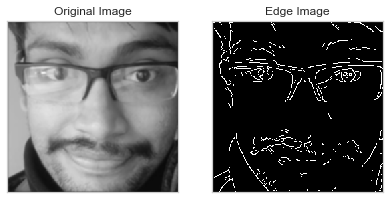


 14%|█▍        | 13/90 [00:01<00:10,  7.01it/s]

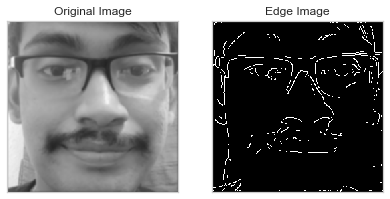


 16%|█▌        | 14/90 [00:01<00:10,  7.18it/s]

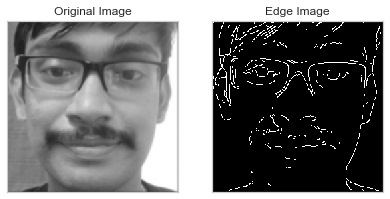


 17%|█▋        | 15/90 [00:02<00:10,  7.30it/s]

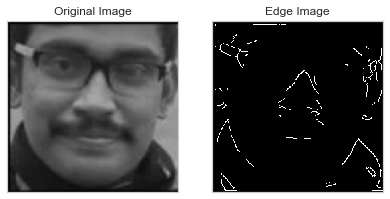


 18%|█▊        | 16/90 [00:02<00:10,  7.18it/s]

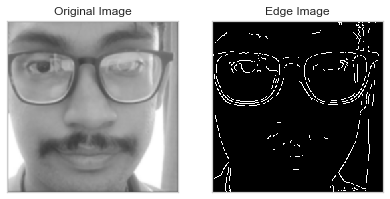


 19%|█▉        | 17/90 [00:02<00:10,  7.16it/s]

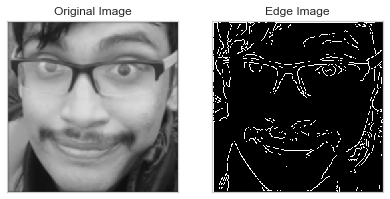


 20%|██        | 18/90 [00:02<00:09,  7.21it/s]

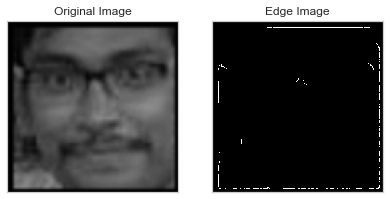


 21%|██        | 19/90 [00:02<00:10,  6.90it/s]

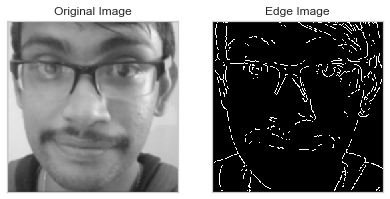


 22%|██▏       | 20/90 [00:02<00:09,  7.00it/s]

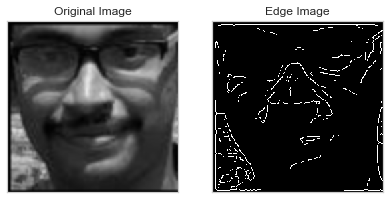


 23%|██▎       | 21/90 [00:02<00:10,  6.62it/s]

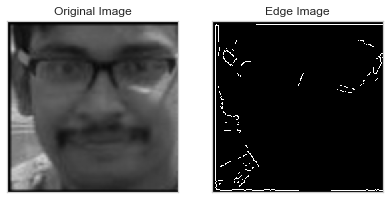


 24%|██▍       | 22/90 [00:03<00:09,  6.94it/s]

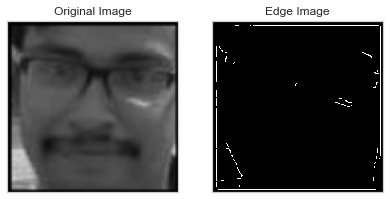


 26%|██▌       | 23/90 [00:03<00:09,  7.08it/s]

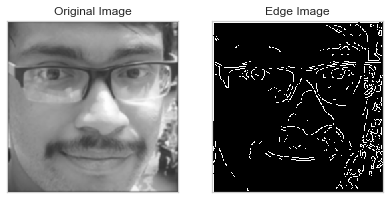


 27%|██▋       | 24/90 [00:03<00:10,  6.43it/s]

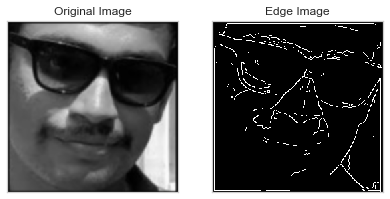


 28%|██▊       | 25/90 [00:03<00:10,  6.25it/s]

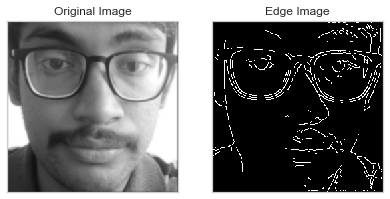


 29%|██▉       | 26/90 [00:03<00:10,  6.37it/s]

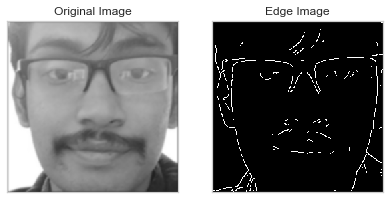


 30%|███       | 27/90 [00:03<00:10,  5.98it/s]

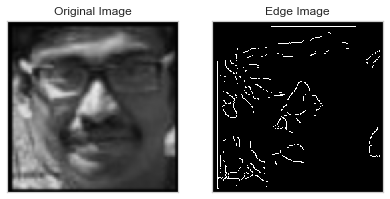


 31%|███       | 28/90 [00:04<00:09,  6.45it/s]

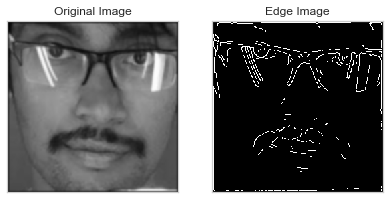


 32%|███▏      | 29/90 [00:04<00:09,  6.16it/s]

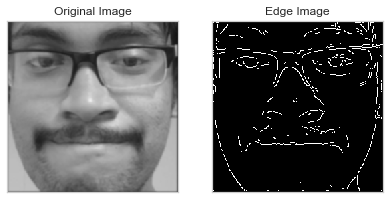


 33%|███▎      | 30/90 [00:04<00:09,  6.49it/s]

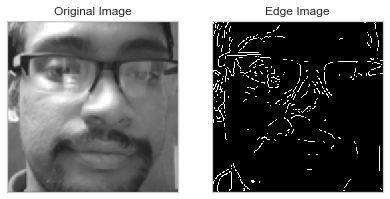


 34%|███▍      | 31/90 [00:04<00:11,  4.98it/s]

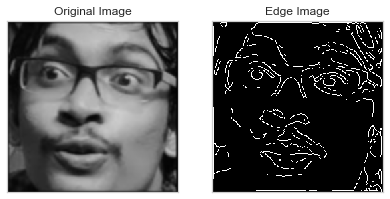


 36%|███▌      | 32/90 [00:04<00:11,  5.00it/s]

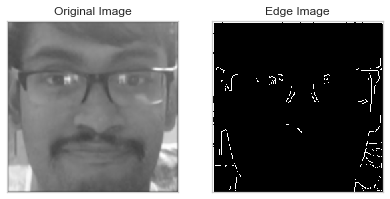


 37%|███▋      | 33/90 [00:05<00:10,  5.29it/s]

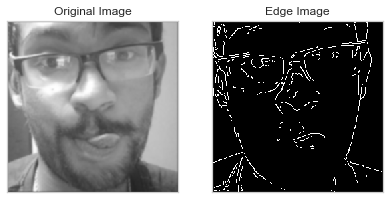


 38%|███▊      | 34/90 [00:05<00:10,  5.55it/s]

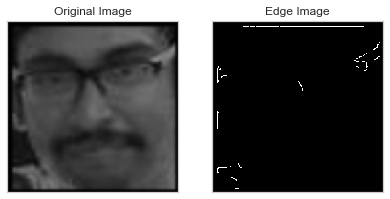


 39%|███▉      | 35/90 [00:05<00:10,  5.02it/s]

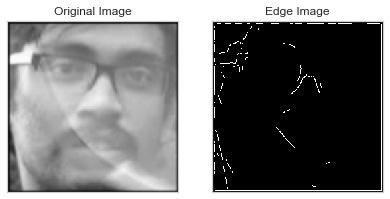


 40%|████      | 36/90 [00:05<00:11,  4.89it/s]

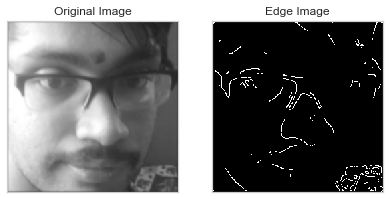


 41%|████      | 37/90 [00:05<00:09,  5.37it/s]

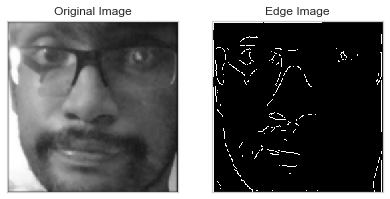


 42%|████▏     | 38/90 [00:05<00:09,  5.48it/s]

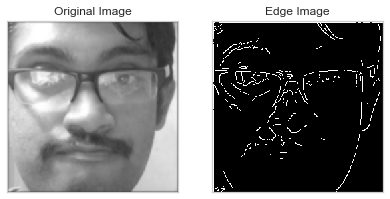


 43%|████▎     | 39/90 [00:06<00:09,  5.47it/s]

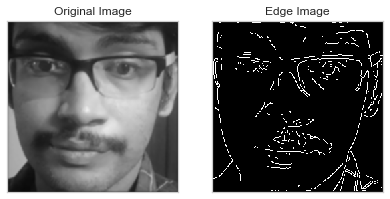


 44%|████▍     | 40/90 [00:06<00:08,  5.88it/s]

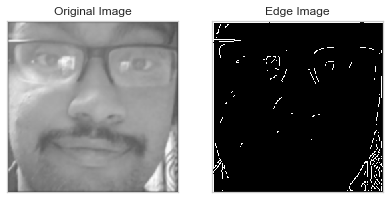


 46%|████▌     | 41/90 [00:06<00:08,  5.87it/s]

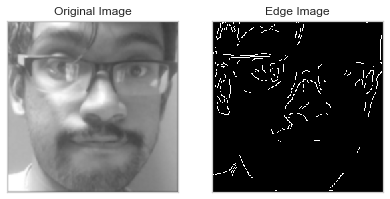


 47%|████▋     | 42/90 [00:06<00:08,  5.58it/s]

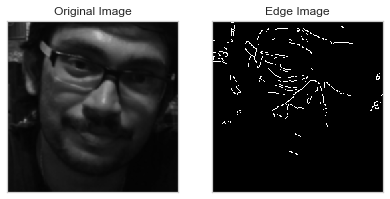


 48%|████▊     | 43/90 [00:06<00:07,  5.98it/s]

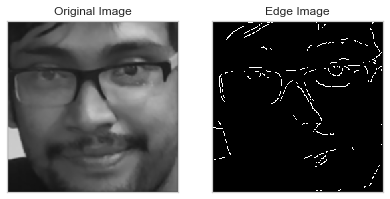


 49%|████▉     | 44/90 [00:06<00:07,  6.31it/s]

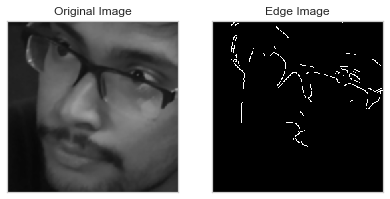


 50%|█████     | 45/90 [00:07<00:07,  6.01it/s]

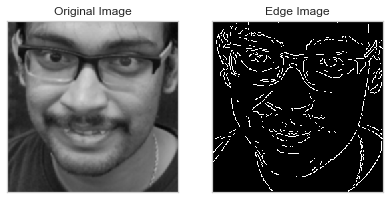


 51%|█████     | 46/90 [00:07<00:07,  5.75it/s]

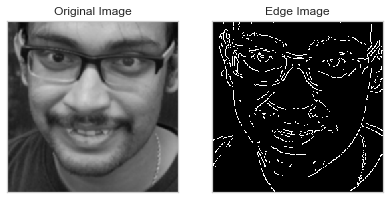


 52%|█████▏    | 47/90 [00:07<00:08,  5.19it/s]

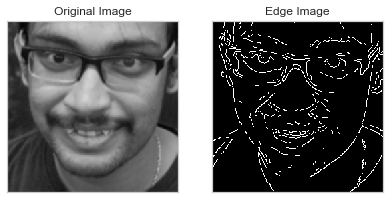


 53%|█████▎    | 48/90 [00:07<00:08,  5.22it/s]

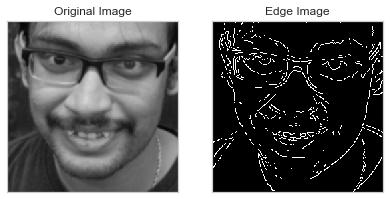


 54%|█████▍    | 49/90 [00:07<00:08,  5.07it/s]

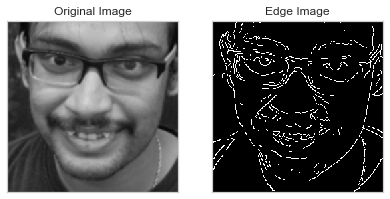


 56%|█████▌    | 50/90 [00:08<00:07,  5.35it/s]

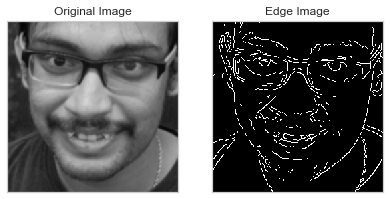


 57%|█████▋    | 51/90 [00:08<00:07,  5.52it/s]

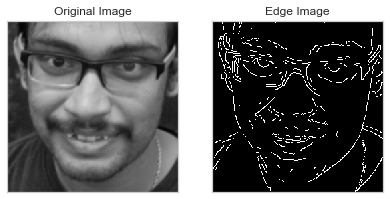


 58%|█████▊    | 52/90 [00:08<00:06,  5.73it/s]

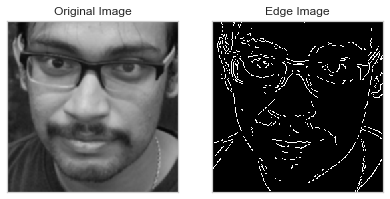


 59%|█████▉    | 53/90 [00:08<00:06,  5.71it/s]

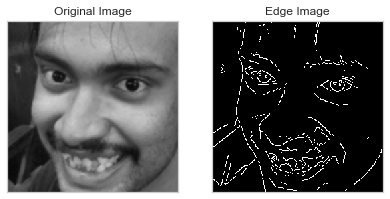


 60%|██████    | 54/90 [00:08<00:06,  5.73it/s]

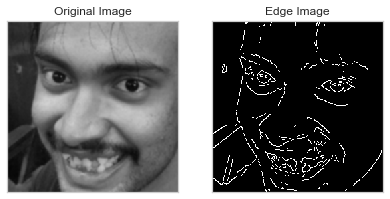


 61%|██████    | 55/90 [00:08<00:06,  5.62it/s]

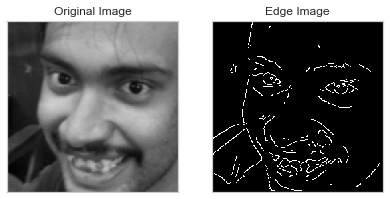


 62%|██████▏   | 56/90 [00:09<00:06,  5.52it/s]

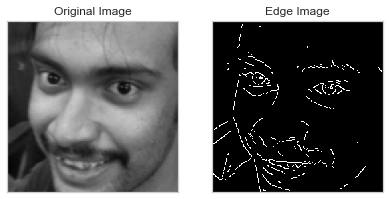


 63%|██████▎   | 57/90 [00:09<00:06,  5.48it/s]

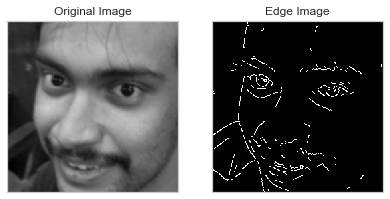


 64%|██████▍   | 58/90 [00:09<00:05,  5.53it/s]

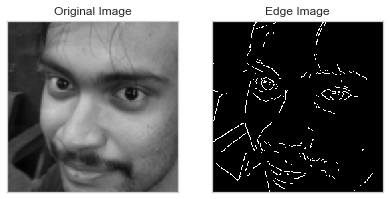


 66%|██████▌   | 59/90 [00:09<00:05,  5.60it/s]

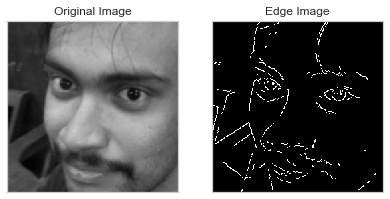


 67%|██████▋   | 60/90 [00:09<00:05,  5.60it/s]

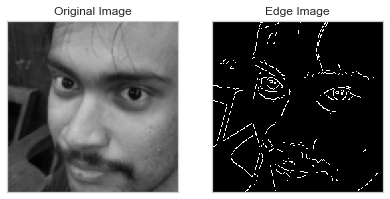


 68%|██████▊   | 61/90 [00:10<00:05,  5.07it/s]

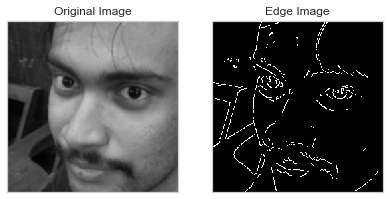


 69%|██████▉   | 62/90 [00:10<00:05,  5.24it/s]

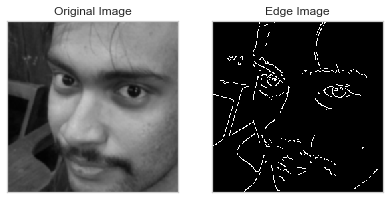


 70%|███████   | 63/90 [00:10<00:06,  4.41it/s]

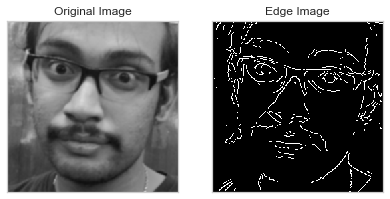


 71%|███████   | 64/90 [00:10<00:05,  4.76it/s]

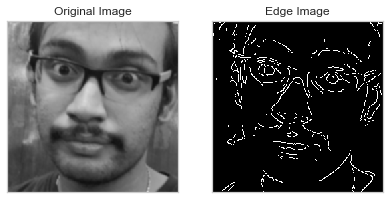


 72%|███████▏  | 65/90 [00:10<00:05,  4.76it/s]

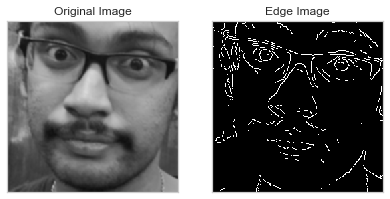


 73%|███████▎  | 66/90 [00:11<00:04,  5.08it/s]

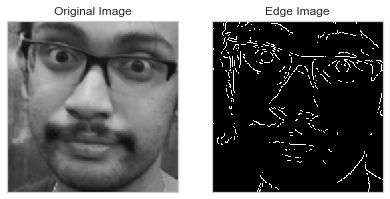


 74%|███████▍  | 67/90 [00:11<00:04,  5.31it/s]

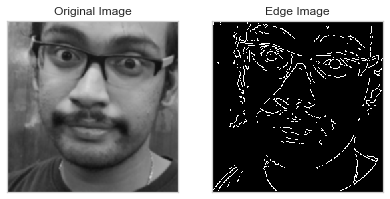


 76%|███████▌  | 68/90 [00:11<00:04,  5.49it/s]

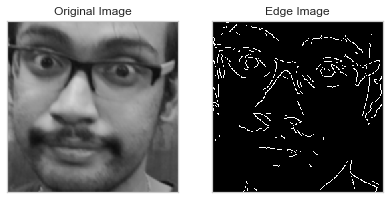


 77%|███████▋  | 69/90 [00:11<00:03,  5.45it/s]

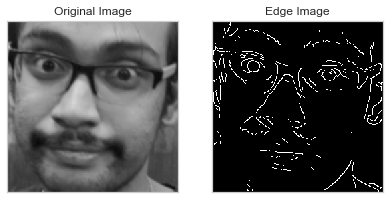


 78%|███████▊  | 70/90 [00:11<00:03,  5.67it/s]

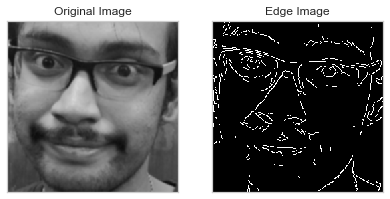


 79%|███████▉  | 71/90 [00:12<00:03,  5.72it/s]

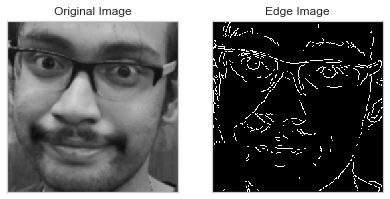


 80%|████████  | 72/90 [00:12<00:03,  5.76it/s]

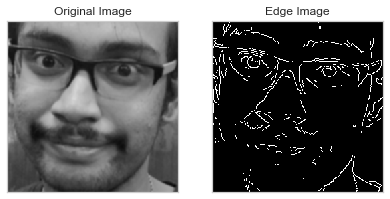


 81%|████████  | 73/90 [00:12<00:03,  5.18it/s]

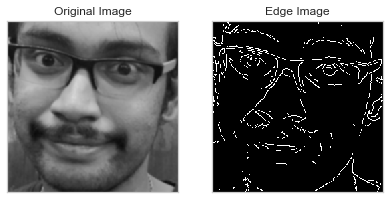


 82%|████████▏ | 74/90 [00:12<00:02,  5.40it/s]

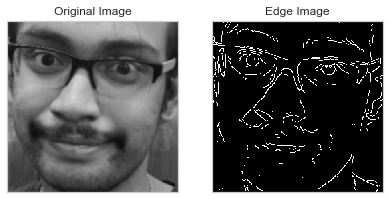


 83%|████████▎ | 75/90 [00:12<00:02,  5.56it/s]

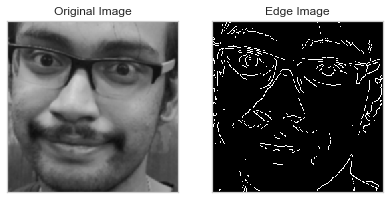


 84%|████████▍ | 76/90 [00:12<00:02,  5.48it/s]

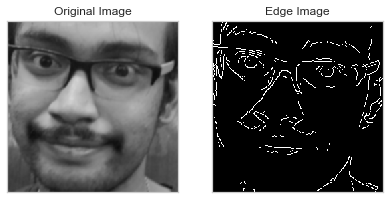


 86%|████████▌ | 77/90 [00:13<00:02,  5.66it/s]

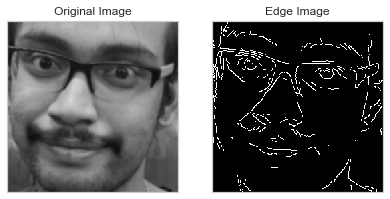


 87%|████████▋ | 78/90 [00:13<00:02,  5.80it/s]

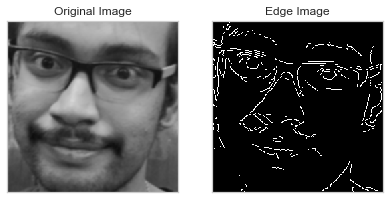


 88%|████████▊ | 79/90 [00:13<00:01,  5.99it/s]

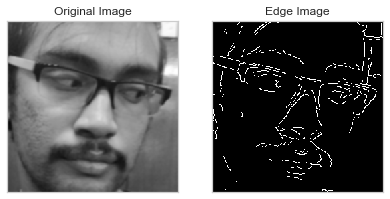


 89%|████████▉ | 80/90 [00:13<00:01,  5.77it/s]

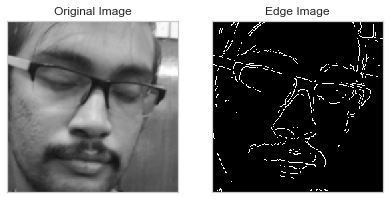


 90%|█████████ | 81/90 [00:13<00:01,  5.86it/s]

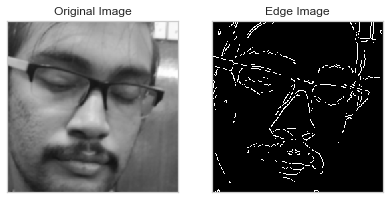


 91%|█████████ | 82/90 [00:13<00:01,  5.80it/s]

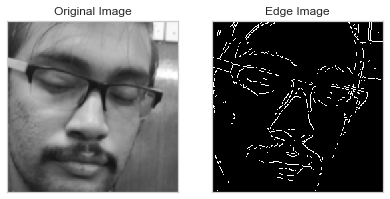


 92%|█████████▏| 83/90 [00:14<00:01,  5.74it/s]

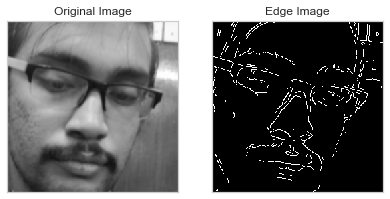


 93%|█████████▎| 84/90 [00:14<00:01,  5.39it/s]

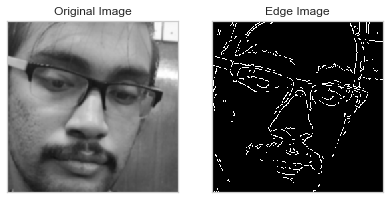


 94%|█████████▍| 85/90 [00:14<00:00,  5.18it/s]

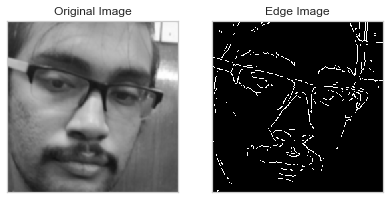


 96%|█████████▌| 86/90 [00:14<00:00,  5.22it/s]

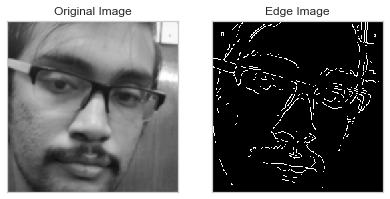


 97%|█████████▋| 87/90 [00:14<00:00,  5.35it/s]

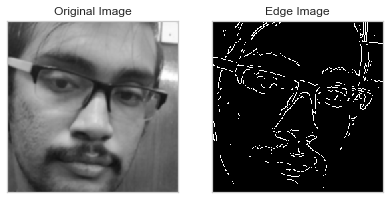


 98%|█████████▊| 88/90 [00:15<00:00,  5.28it/s]

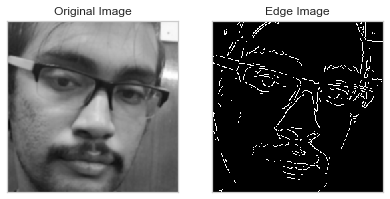


 99%|█████████▉| 89/90 [00:15<00:00,  5.16it/s]

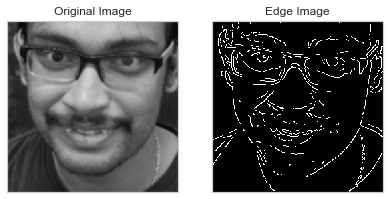


  0%|          | 0/101 [00:00<?, ?it/s]

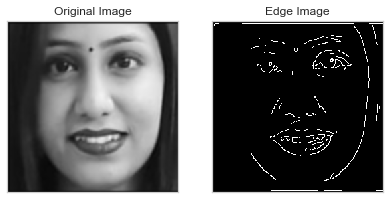


  1%|          | 1/101 [00:00<00:12,  7.83it/s]

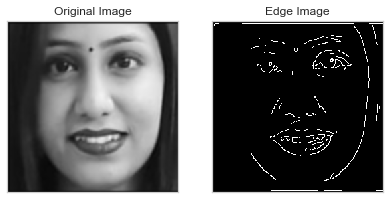


  2%|▏         | 2/101 [00:00<00:13,  7.55it/s]

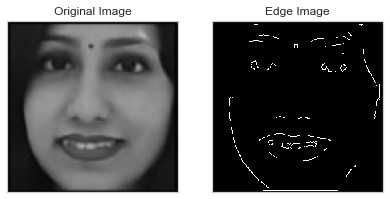


  3%|▎         | 3/101 [00:00<00:12,  7.60it/s]

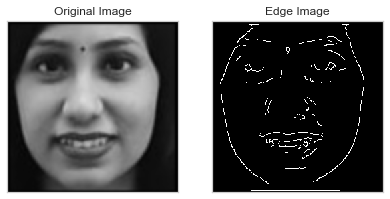


  4%|▍         | 4/101 [00:00<00:12,  7.53it/s]

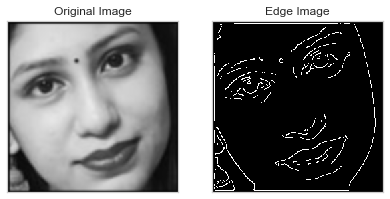


  5%|▍         | 5/101 [00:00<00:16,  5.80it/s]

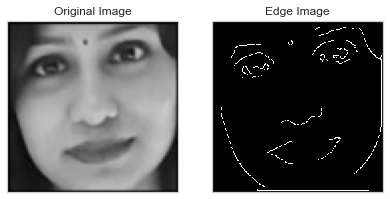


  6%|▌         | 6/101 [00:01<00:18,  5.27it/s]

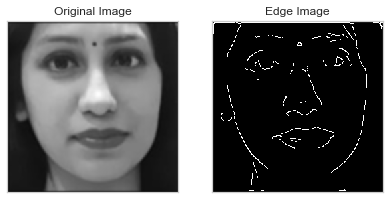


  7%|▋         | 7/101 [00:01<00:16,  5.64it/s]

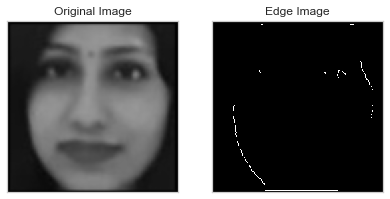


  8%|▊         | 8/101 [00:01<00:15,  6.10it/s]

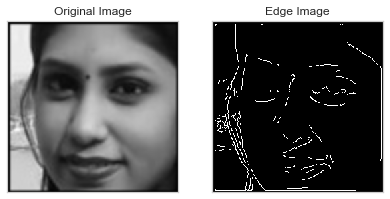


  9%|▉         | 9/101 [00:01<00:15,  6.02it/s]

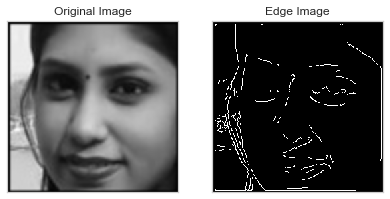


 10%|▉         | 10/101 [00:01<00:14,  6.24it/s]

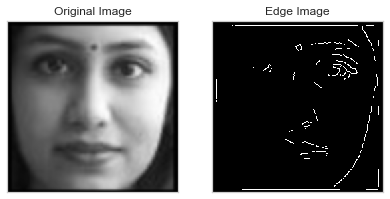


 11%|█         | 11/101 [00:01<00:14,  6.39it/s]

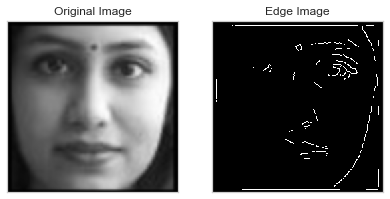


 12%|█▏        | 12/101 [00:01<00:13,  6.80it/s]

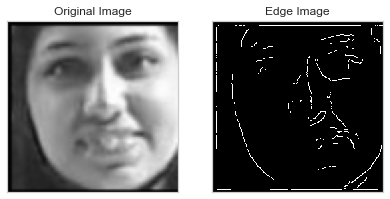


 13%|█▎        | 13/101 [00:02<00:12,  6.96it/s]

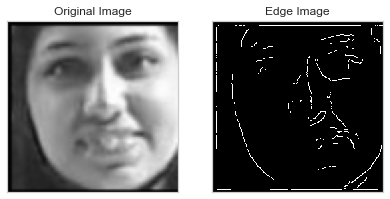


 14%|█▍        | 14/101 [00:02<00:12,  7.17it/s]

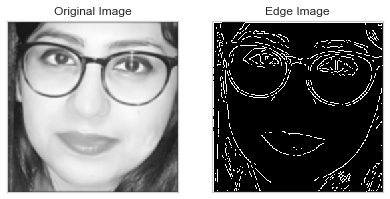


 15%|█▍        | 15/101 [00:02<00:11,  7.31it/s]

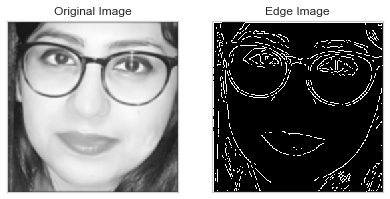


 16%|█▌        | 16/101 [00:02<00:11,  7.28it/s]

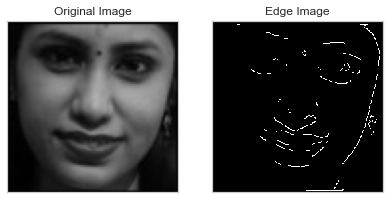


 17%|█▋        | 17/101 [00:02<00:12,  6.81it/s]

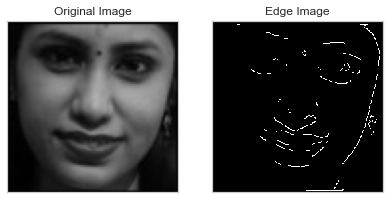


 18%|█▊        | 18/101 [00:02<00:11,  6.92it/s]

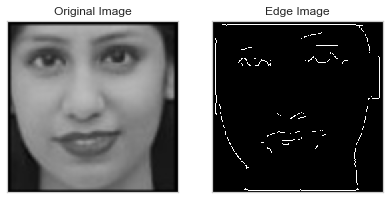


 19%|█▉        | 19/101 [00:02<00:11,  7.12it/s]

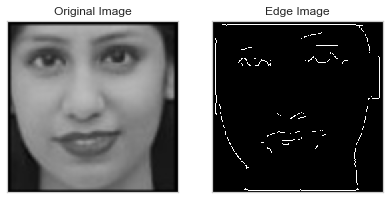


 20%|█▉        | 20/101 [00:03<00:11,  7.32it/s]

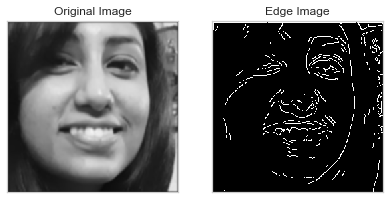


 21%|██        | 21/101 [00:03<00:10,  7.27it/s]

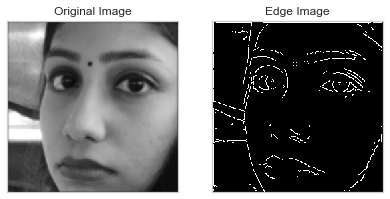


 22%|██▏       | 22/101 [00:03<00:10,  7.34it/s]

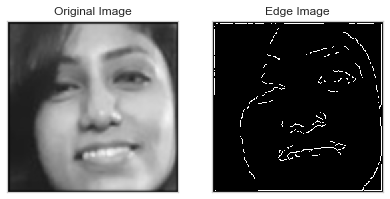


 23%|██▎       | 23/101 [00:03<00:10,  7.55it/s]

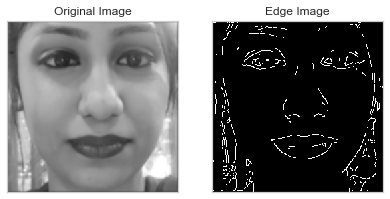


 24%|██▍       | 24/101 [00:03<00:11,  6.88it/s]

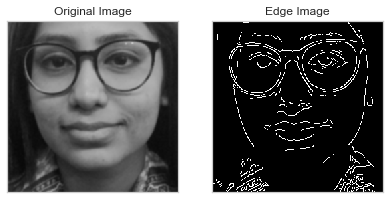


 25%|██▍       | 25/101 [00:03<00:11,  6.87it/s]

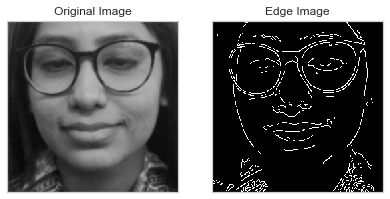


 26%|██▌       | 26/101 [00:03<00:10,  6.94it/s]

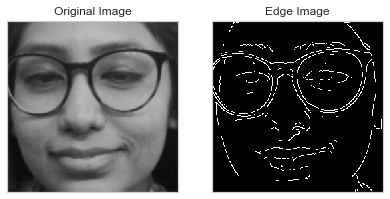


 27%|██▋       | 27/101 [00:04<00:11,  6.61it/s]

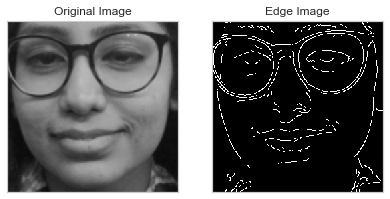


 28%|██▊       | 28/101 [00:04<00:11,  6.49it/s]

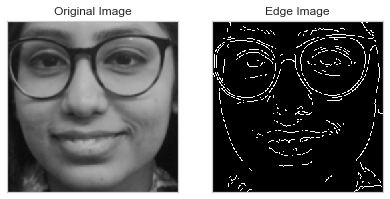


 29%|██▊       | 29/101 [00:04<00:11,  6.42it/s]

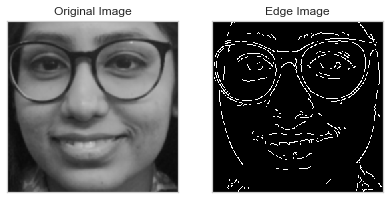


 30%|██▉       | 30/101 [00:04<00:11,  6.16it/s]

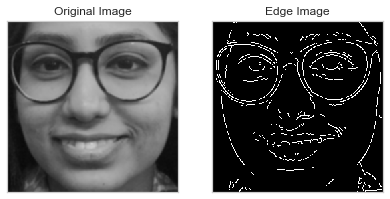


 31%|███       | 31/101 [00:04<00:11,  6.35it/s]

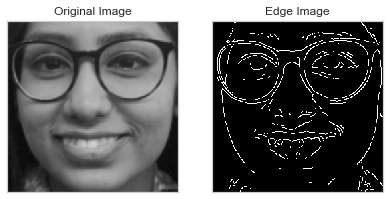


 32%|███▏      | 32/101 [00:04<00:10,  6.41it/s]

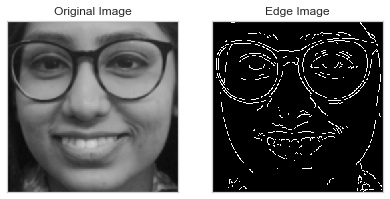


 33%|███▎      | 33/101 [00:04<00:10,  6.63it/s]

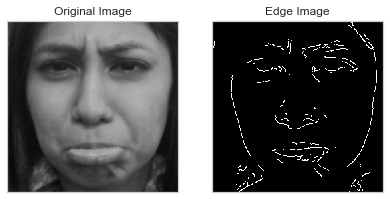


 34%|███▎      | 34/101 [00:05<00:10,  6.61it/s]

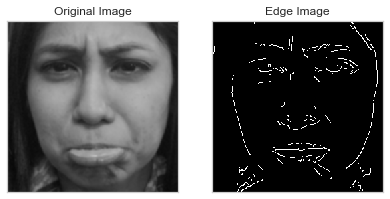


 35%|███▍      | 35/101 [00:05<00:10,  6.30it/s]

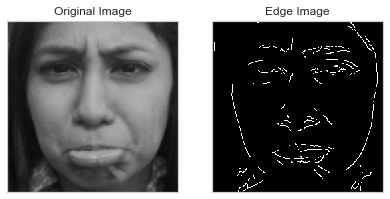


 36%|███▌      | 36/101 [00:05<00:10,  6.23it/s]

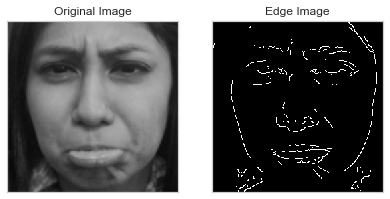


 37%|███▋      | 37/101 [00:05<00:12,  5.01it/s]

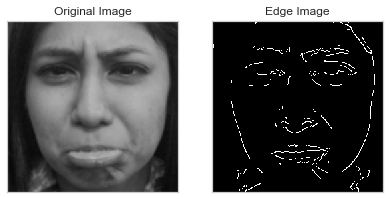


 38%|███▊      | 38/101 [00:05<00:11,  5.47it/s]

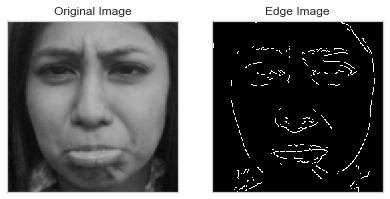


 39%|███▊      | 39/101 [00:06<00:11,  5.63it/s]

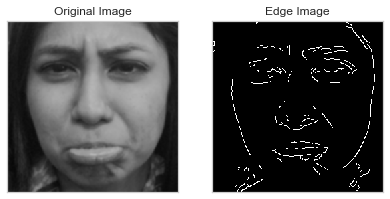


 40%|███▉      | 40/101 [00:06<00:10,  5.95it/s]

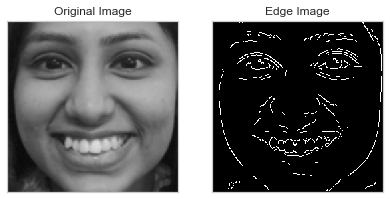


 41%|████      | 41/101 [00:06<00:09,  6.31it/s]

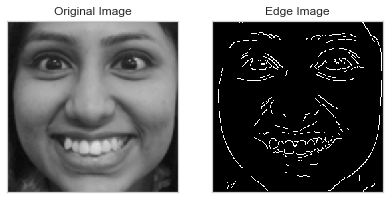


 42%|████▏     | 42/101 [00:06<00:09,  6.45it/s]

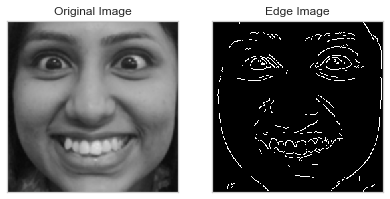


 43%|████▎     | 43/101 [00:06<00:09,  6.38it/s]

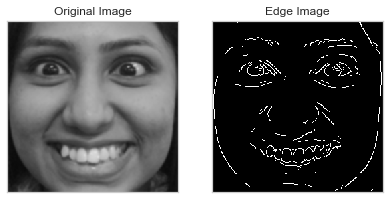


 44%|████▎     | 44/101 [00:06<00:08,  6.37it/s]

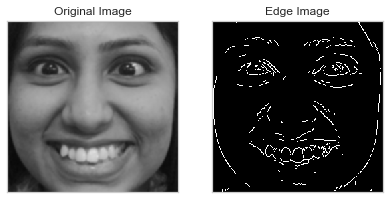


 45%|████▍     | 45/101 [00:06<00:08,  6.26it/s]

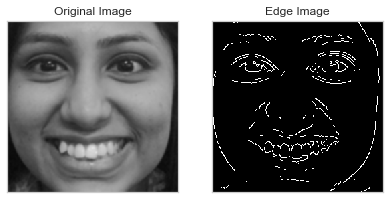


 46%|████▌     | 46/101 [00:07<00:09,  6.07it/s]

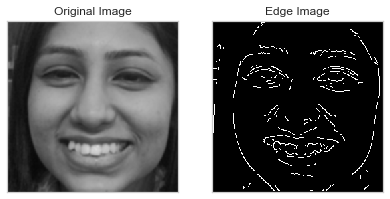


 47%|████▋     | 47/101 [00:07<00:09,  5.90it/s]

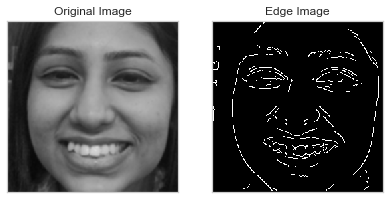


 48%|████▊     | 48/101 [00:07<00:09,  5.85it/s]

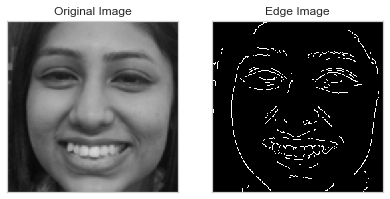


 49%|████▊     | 49/101 [00:07<00:08,  5.82it/s]

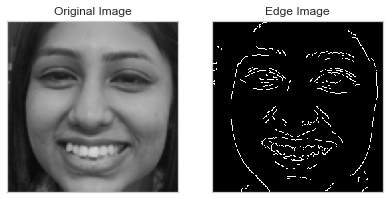


 50%|████▉     | 50/101 [00:07<00:08,  5.82it/s]

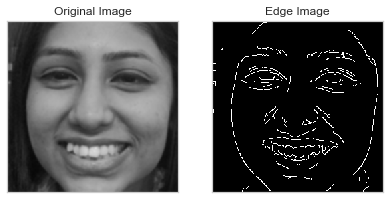


 50%|█████     | 51/101 [00:08<00:08,  5.94it/s]

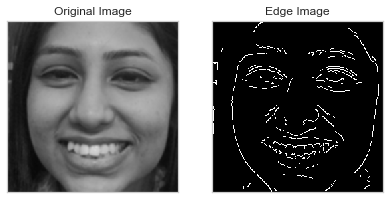


 51%|█████▏    | 52/101 [00:08<00:08,  5.84it/s]

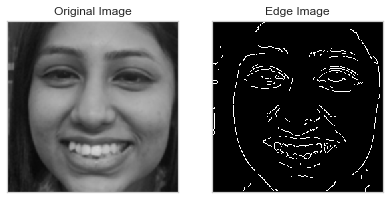


 52%|█████▏    | 53/101 [00:08<00:07,  6.07it/s]

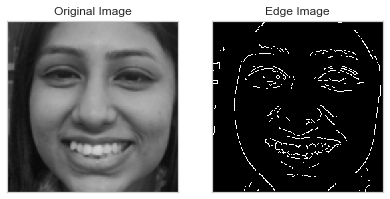


 53%|█████▎    | 54/101 [00:08<00:07,  6.03it/s]

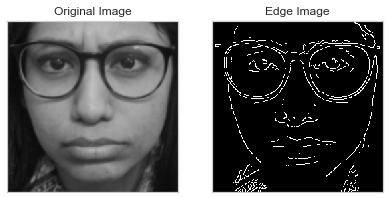


 54%|█████▍    | 55/101 [00:08<00:07,  6.22it/s]

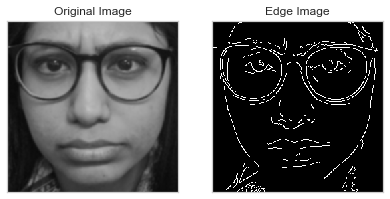


 55%|█████▌    | 56/101 [00:08<00:07,  6.32it/s]

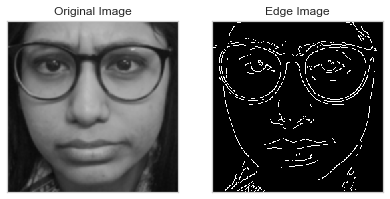


 56%|█████▋    | 57/101 [00:08<00:06,  6.34it/s]

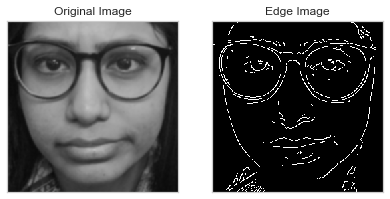


 57%|█████▋    | 58/101 [00:09<00:08,  5.04it/s]

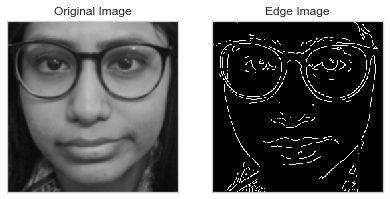


 58%|█████▊    | 59/101 [00:09<00:08,  4.90it/s]

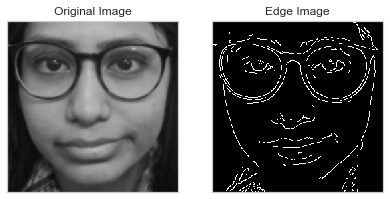


 59%|█████▉    | 60/101 [00:09<00:07,  5.24it/s]

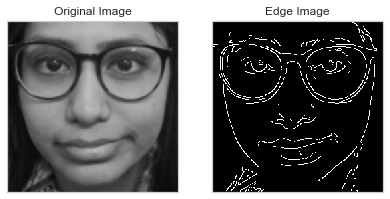


 60%|██████    | 61/101 [00:09<00:07,  5.57it/s]

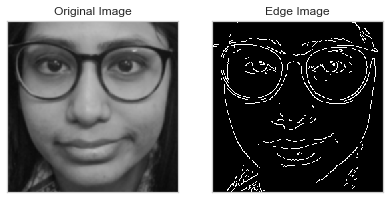


 61%|██████▏   | 62/101 [00:09<00:06,  5.73it/s]

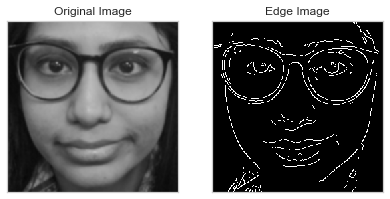


 62%|██████▏   | 63/101 [00:10<00:06,  5.86it/s]

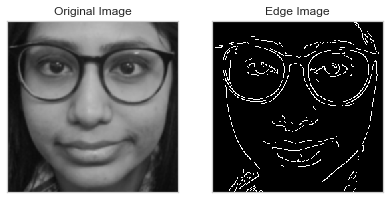


 63%|██████▎   | 64/101 [00:10<00:06,  5.41it/s]

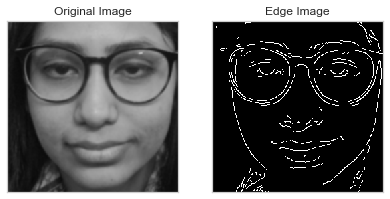


 64%|██████▍   | 65/101 [00:10<00:06,  5.67it/s]

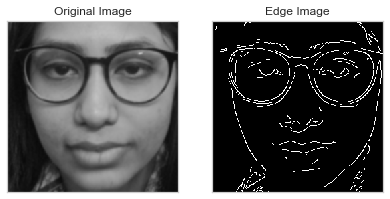


 65%|██████▌   | 66/101 [00:10<00:06,  5.71it/s]

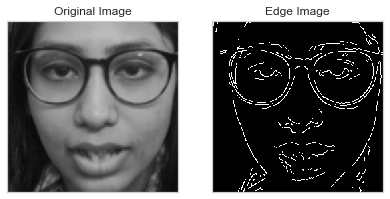


 66%|██████▋   | 67/101 [00:10<00:05,  5.95it/s]

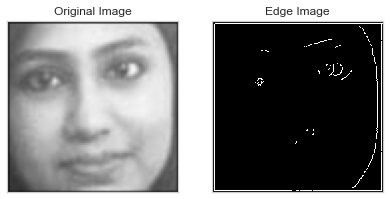


 67%|██████▋   | 68/101 [00:10<00:05,  6.34it/s]

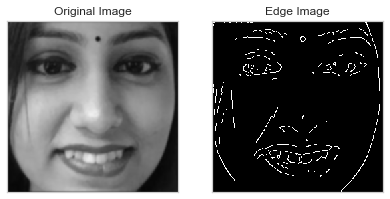


 68%|██████▊   | 69/101 [00:11<00:06,  5.16it/s]

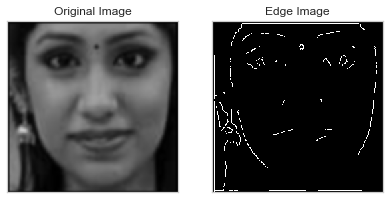


 69%|██████▉   | 70/101 [00:11<00:05,  5.32it/s]

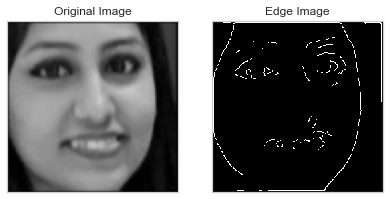


 70%|███████   | 71/101 [00:11<00:05,  5.76it/s]

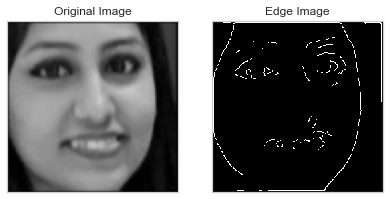


 71%|███████▏  | 72/101 [00:11<00:04,  6.22it/s]

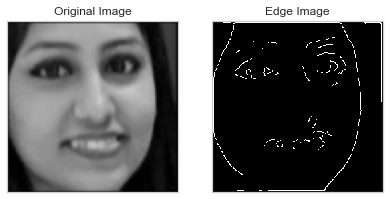


 72%|███████▏  | 73/101 [00:11<00:04,  6.62it/s]

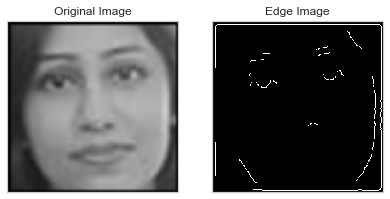


 73%|███████▎  | 74/101 [00:11<00:03,  6.94it/s]

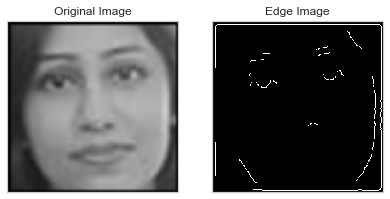


 74%|███████▍  | 75/101 [00:12<00:03,  7.20it/s]

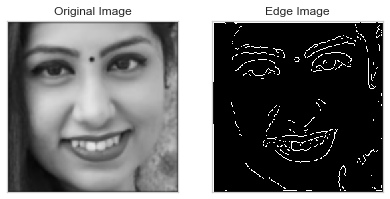


 75%|███████▌  | 76/101 [00:12<00:03,  7.19it/s]

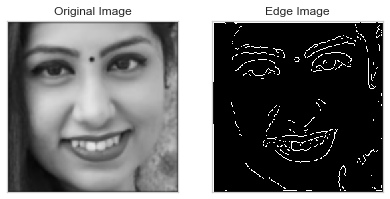


 76%|███████▌  | 77/101 [00:12<00:03,  7.23it/s]

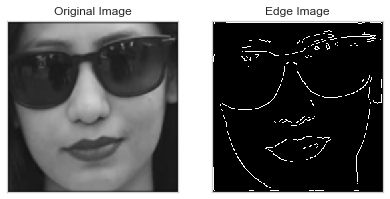


 77%|███████▋  | 78/101 [00:12<00:03,  7.45it/s]

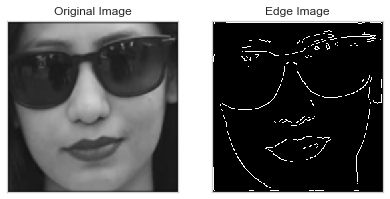


 78%|███████▊  | 79/101 [00:12<00:02,  7.56it/s]

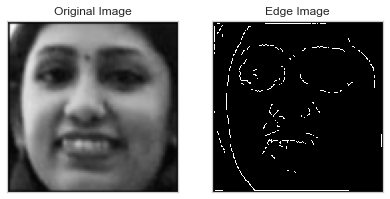


 79%|███████▉  | 80/101 [00:12<00:02,  7.49it/s]

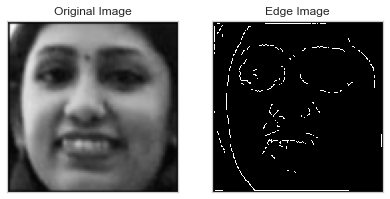


 80%|████████  | 81/101 [00:12<00:02,  7.60it/s]

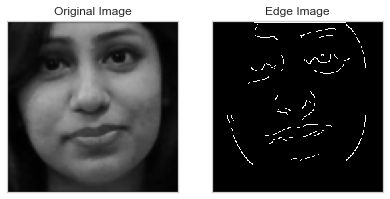


 81%|████████  | 82/101 [00:12<00:02,  7.72it/s]

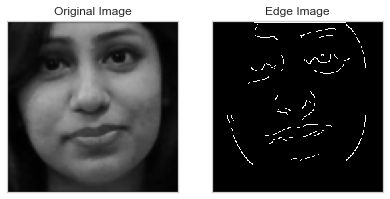


 82%|████████▏ | 83/101 [00:13<00:02,  7.70it/s]

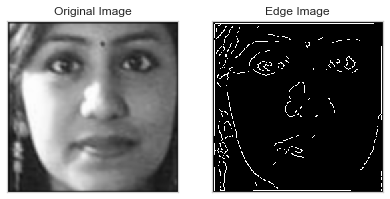


 83%|████████▎ | 84/101 [00:13<00:02,  7.37it/s]

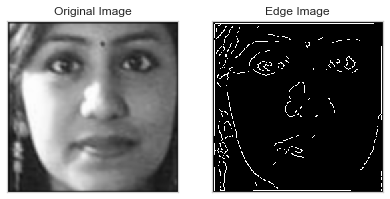


 84%|████████▍ | 85/101 [00:13<00:02,  7.38it/s]

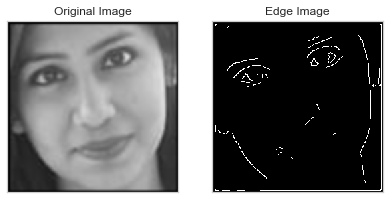


 85%|████████▌ | 86/101 [00:13<00:01,  7.56it/s]

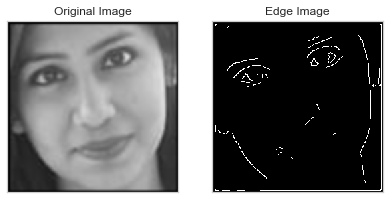


 86%|████████▌ | 87/101 [00:13<00:01,  7.68it/s]

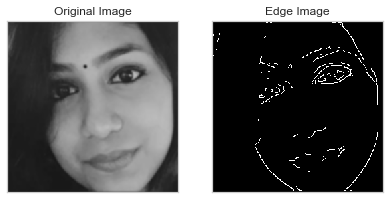


 87%|████████▋ | 88/101 [00:13<00:01,  7.16it/s]

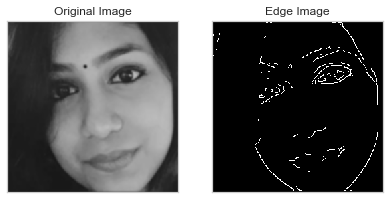


 88%|████████▊ | 89/101 [00:13<00:01,  7.22it/s]

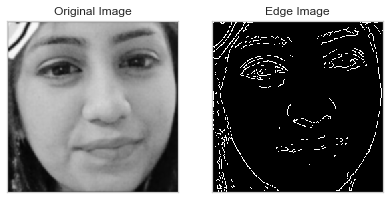


 89%|████████▉ | 90/101 [00:14<00:01,  7.30it/s]

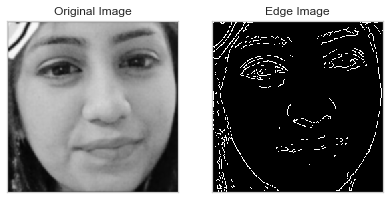


 90%|█████████ | 91/101 [00:14<00:01,  7.27it/s]

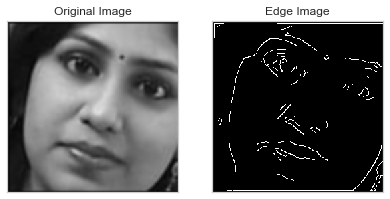


 91%|█████████ | 92/101 [00:14<00:01,  7.16it/s]

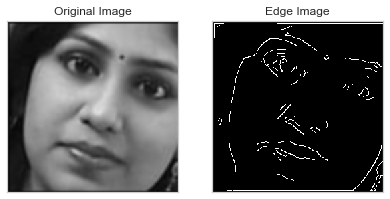


 92%|█████████▏| 93/101 [00:14<00:01,  7.27it/s]

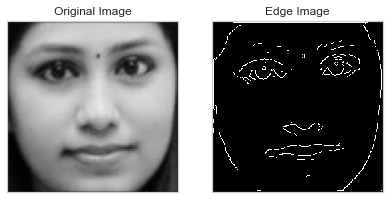


 93%|█████████▎| 94/101 [00:14<00:00,  7.08it/s]

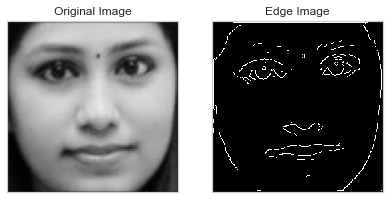


 94%|█████████▍| 95/101 [00:14<00:00,  6.59it/s]

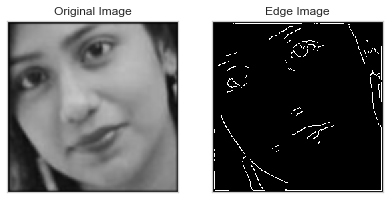


 95%|█████████▌| 96/101 [00:14<00:00,  6.43it/s]

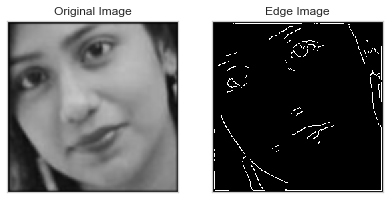


 96%|█████████▌| 97/101 [00:15<00:00,  6.27it/s]

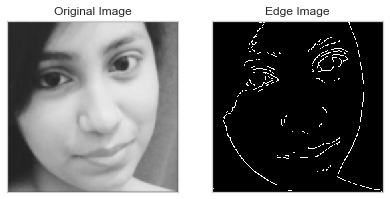


 97%|█████████▋| 98/101 [00:15<00:00,  6.20it/s]

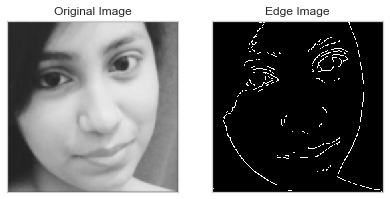


 98%|█████████▊| 99/101 [00:15<00:00,  6.48it/s]

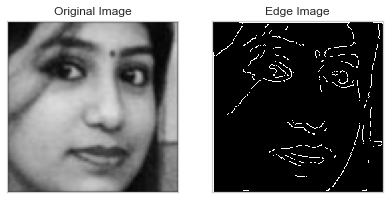


 99%|█████████▉| 100/101 [00:15<00:00,  6.48it/s]

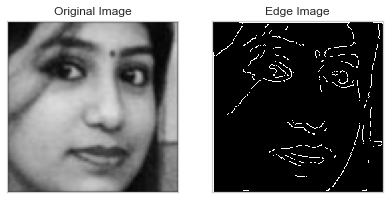


100%|██████████| 9/9 [02:03<00:00, 13.68s/it]


In [6]:
for img in tqdm(os.listdir(p1)):
    path = os.path.join(p1,img)
    preprocess_data(img,path)